# BM

------------cnn-----------------

In [272]:
%run correlation_analysis.ipynb
%run Data_perturbation.ipynb
%run Feature_selection.ipynb
from keras.models import load_model
model = load_model('test_model\cnn_model_rdl.h5')#加载CNN模型
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")

In [273]:
column_names = df.columns[1:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,1:-1]

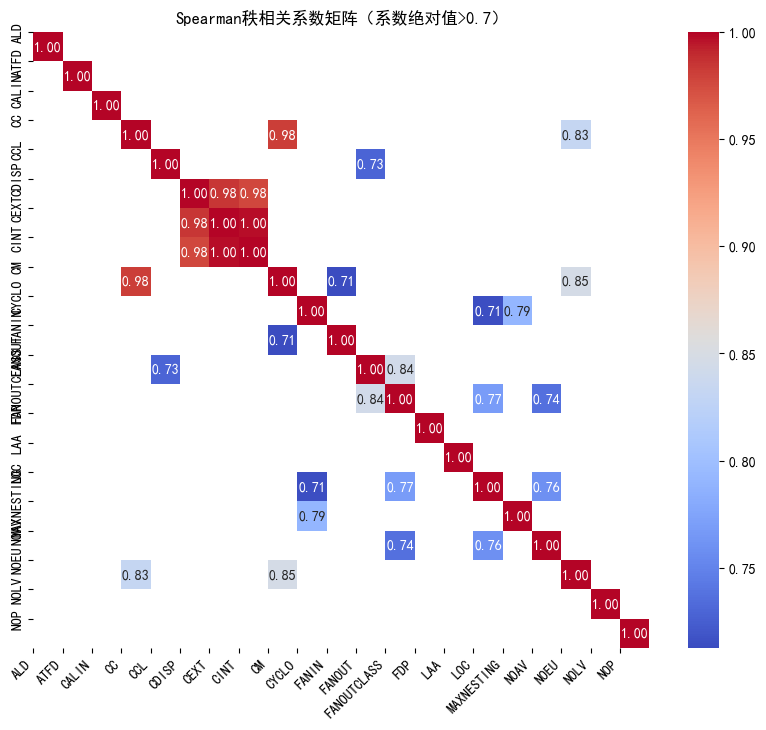

In [274]:
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)

In [275]:
target_variable = df['is_brain']

In [276]:
column_names = df.columns[1:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

In [277]:
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
base = df.iloc[:,1:-1]
base_data = base.mean()
base_data = base_data.round().astype(int)
base_data = base_data.values.reshape(1,base_data.shape[0],1)
x = base_data

In [278]:
x = tf.convert_to_tensor(x,dtype=tf.float32)
init_val = model.predict(x)

In [279]:
min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)

In [280]:
y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)

Running time: 196.06060360000265 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_14636\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


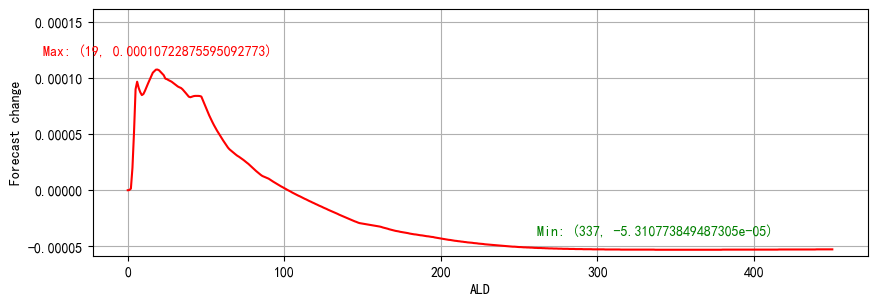

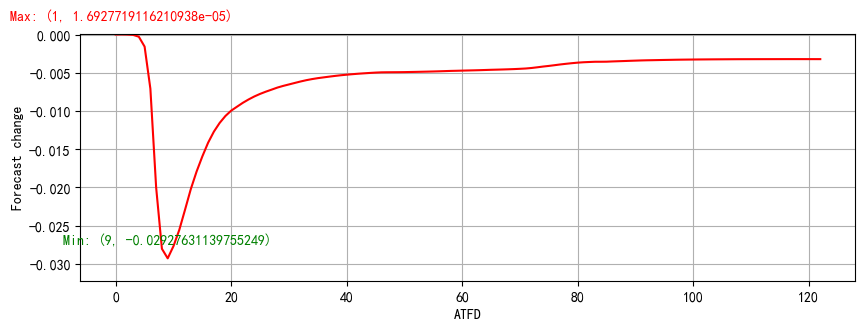

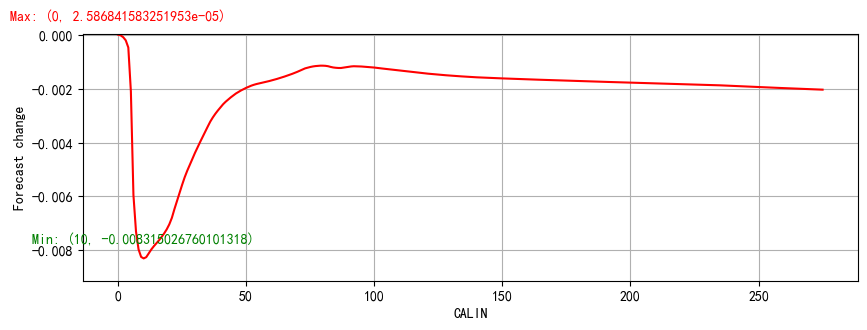

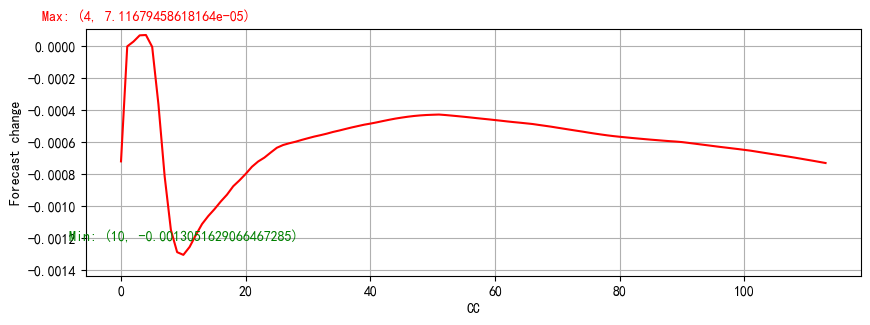

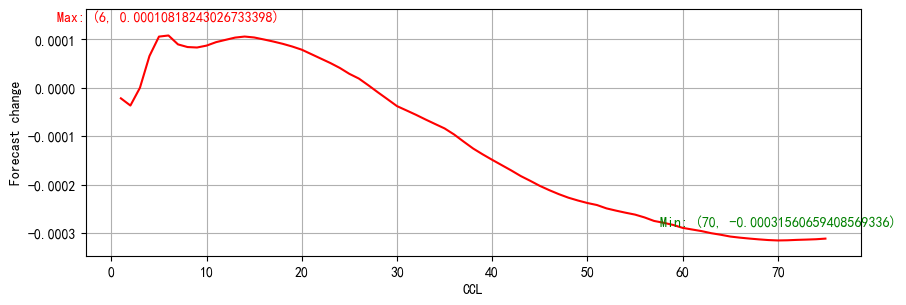

...

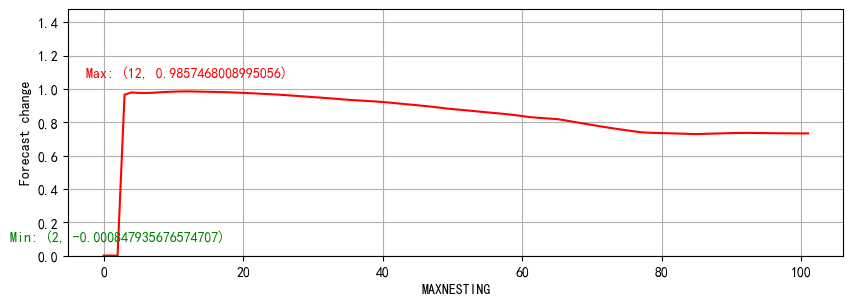

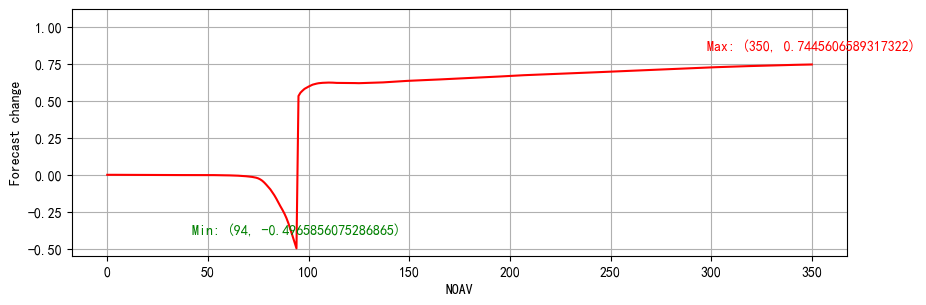

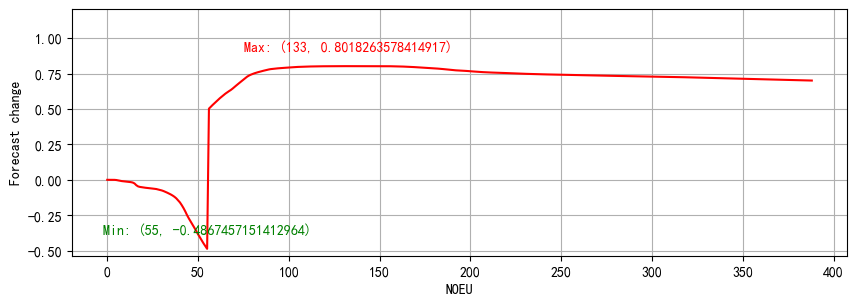

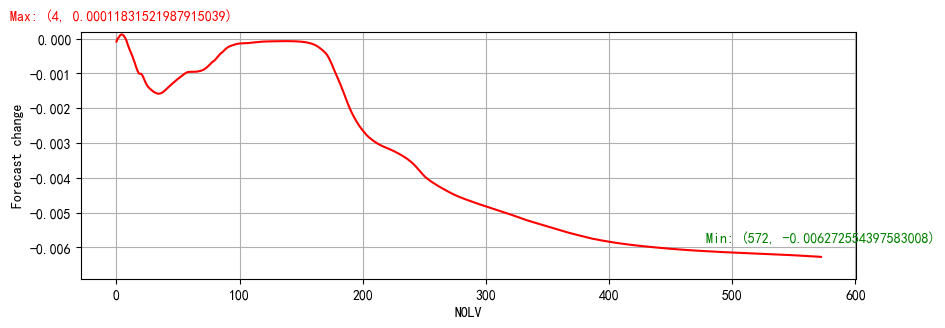

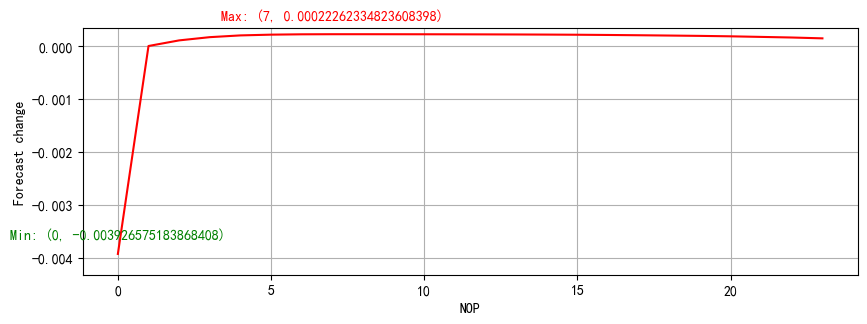

In [281]:
max_values = visualization(column_names,y_list)

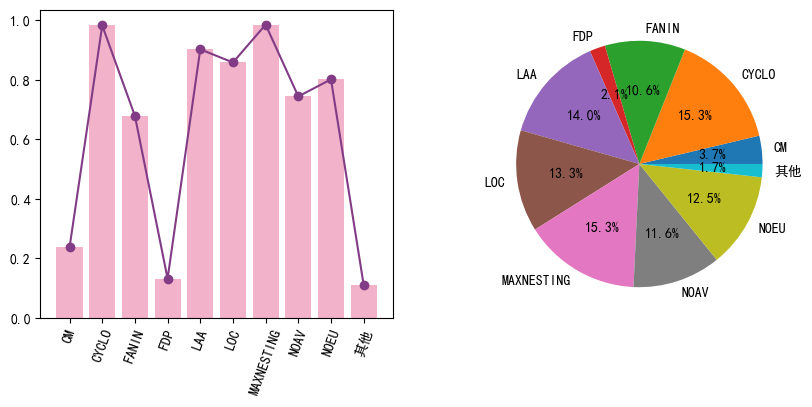

In [282]:
threshold = 2
feature_important(column_names,threshold,max_values)

In [283]:
column_names = df.columns[1:-1].tolist()
F_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [284]:
F_remove

['ALD',
 'ATFD',
 'CALIN',
 'CC',
 'CCL',
 'CDISP',
 'CEXT',
 'CINT',
 'FANOUT',
 'FANOUTCLASS',
 'NOLV',
 'NOP']

In [285]:
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow import keras
from keras import regularizers
from keras.layers import Dense,Flatten,Conv1D,MaxPooling1D,Dropout,BatchNormalization
from tensorflow.keras import Sequential
from tensorflow.keras import Model
from tensorflow.keras import layers
from sklearn.preprocessing import OneHotEncoder
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
from imblearn.over_sampling import SMOTE

In [286]:
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:, -1]

In [287]:
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)

In [288]:
columns_to_drop = F_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped

In [289]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [290]:
# # CNN
inp=Input(shape=(x_train.shape[1:]))

x = Conv1D(32, 6, padding = "same", activation='tanh')(inp)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same',activation='relu')(x)#padding可能会导致靠近边界的部分相比于中间部分对于输出的的影响更小
                                                                              #可能会导致边界存在一定程度的欠表示
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(256, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dense(64,activation='relu',kernel_regularizer=regularizers.l2(0.001))(x)
g = Flatten()(x)
output = Dense(2, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(g)

model = Model(inputs=inp,outputs=output)

In [291]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )

In [292]:
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)

In [293]:
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=30,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/30
3804/3804 [==============================] - 39s 10ms/step - loss: 0.3523 - accuracy: 0.8901 - val_loss: 0.2247 - val_accuracy: 0.9260
Epoch 2/30
3804/3804 [==============================] - 38s 10ms/step - loss: 0.2412 - accuracy: 0.9166 - val_loss: 0.2225 - val_accuracy: 0.9282
Epoch 3/30
3804/3804 [==============================] - 38s 10ms/step - loss: 0.2318 - accuracy: 0.9209 - val_loss: 0.2136 - val_accuracy: 0.9268
Epoch 4/30
3804/3804 [==============================] - 38s 10ms/step - loss: 0.2300 - accuracy: 0.9210 - val_loss: 0.2145 - val_accuracy: 0.9279
Epoch 5/30
3804/3804 [==============================] - 38s 10ms/step - loss: 0.2239 - accuracy: 0.9224 - val_loss: 0.2122 - val_accuracy: 0.9274
Epoch 6/30
3804/3804 [==============================] - 38s 10ms/step - loss: 0.2225 - accuracy: 0.9232 - val_loss: 0.2142 - val_accuracy: 0.9272
Epoch 7/30
3804/3804 [==============================] - 38s 10ms/step - loss: 0.2234 - accuracy: 0.9226 - val_loss: 0.2089 -

In [294]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

951/951 [==============================] - 4s 4ms/step - loss: 0.1999 - accuracy: 0.9319
[0.19993674755096436, 0.9318742156028748]
Running time: 1143.5316860999992 Seconds
              precision    recall  f1-score   support

           0    0.96344   0.89751   0.92931     15182
           1    0.90446   0.96609   0.93426     15247

    accuracy                        0.93187     30429
   macro avg    0.93395   0.93180   0.93178     30429
weighted avg    0.93389   0.93187   0.93179     30429



-----------------lstm-----------

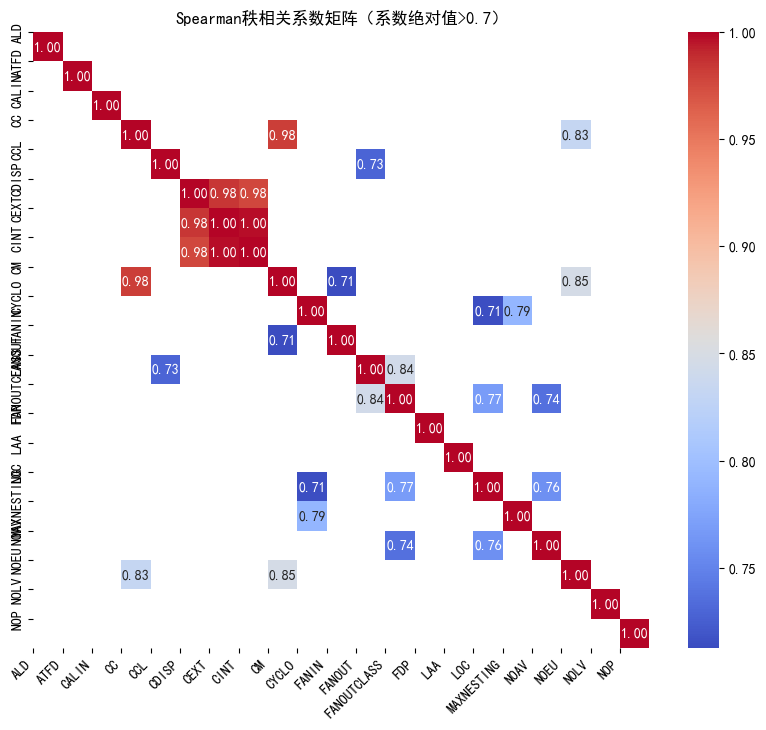

In [105]:
model = load_model('test_model\BM_new_LSTM.h5')#加载CNN模型
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
column_names = df.columns[1:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,1:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['is_brain']
column_names = df.columns[1:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 193.84056170000258 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_9796\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


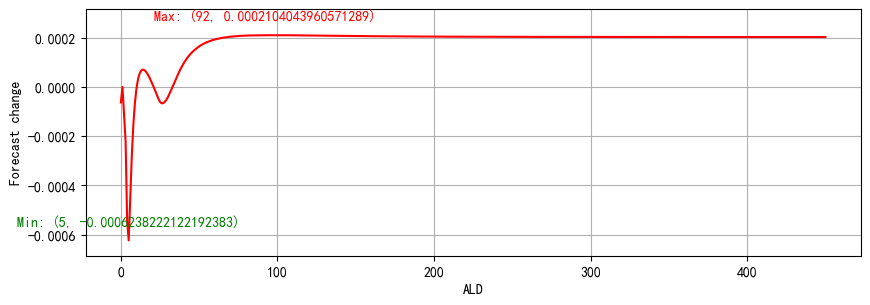

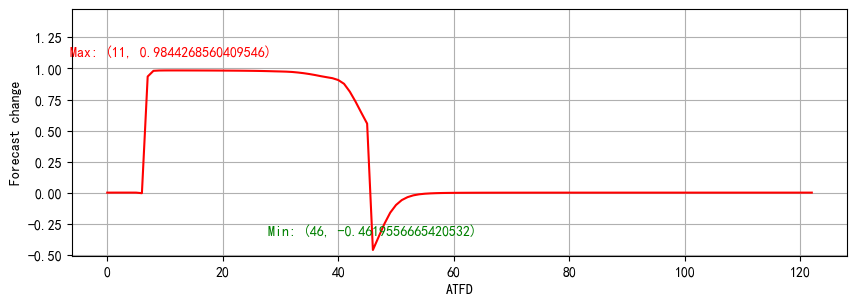

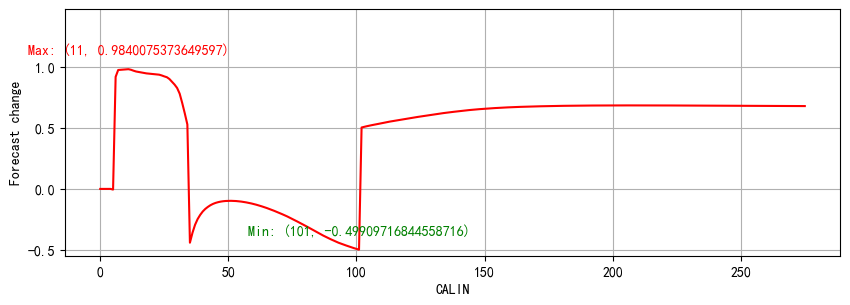

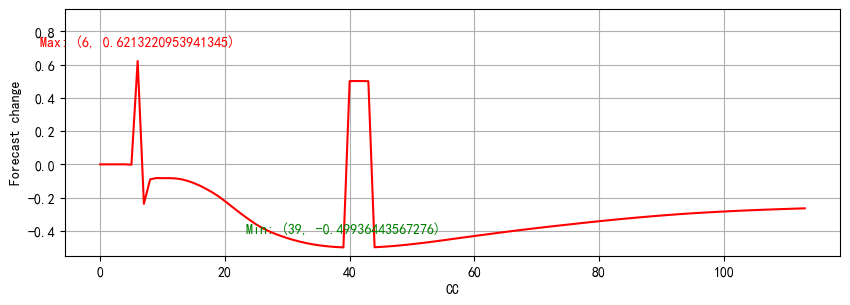

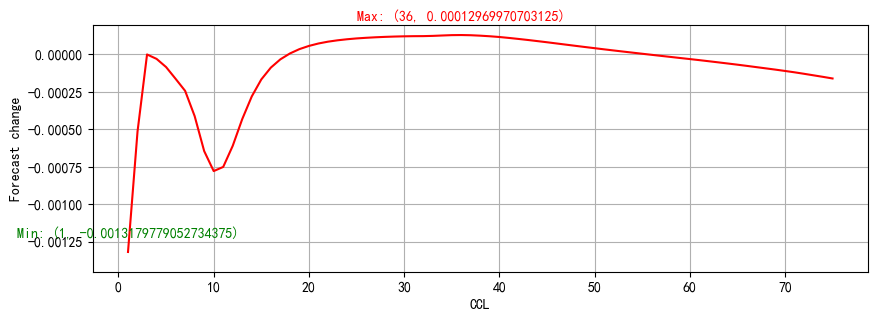

...

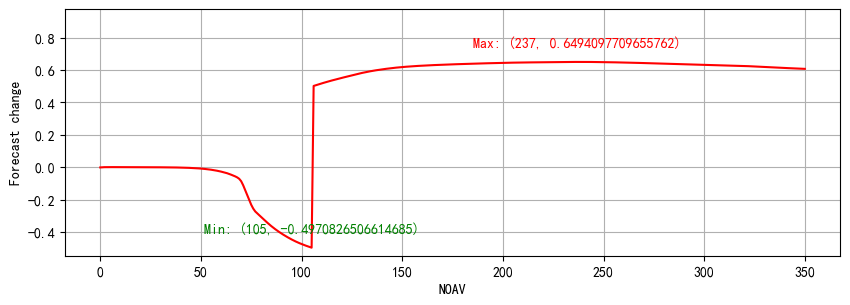

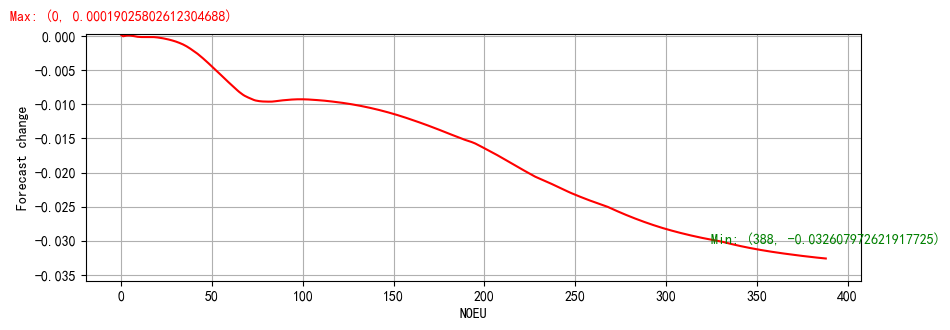

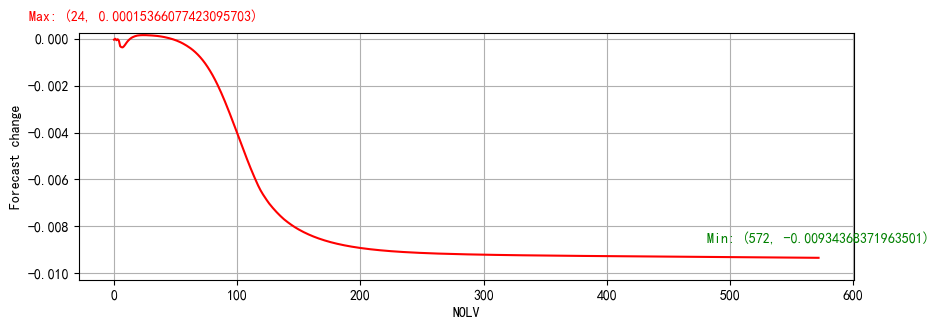

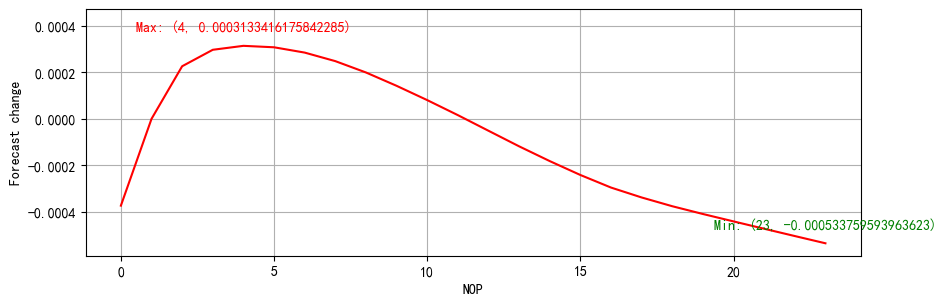

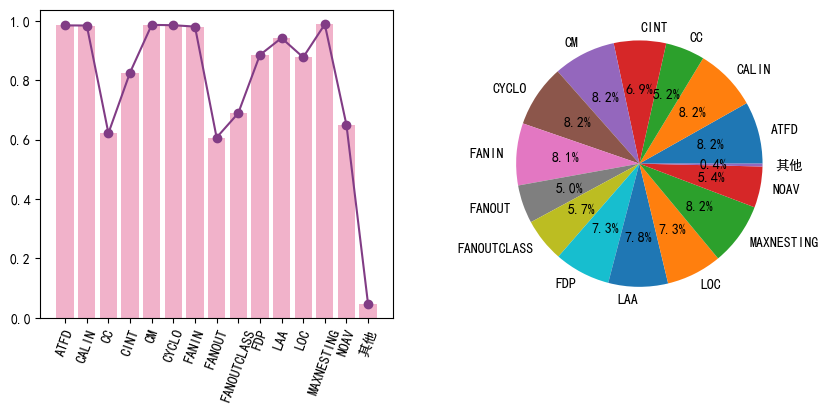

删除的特征为：['ALD', 'CCL', 'CDISP', 'CEXT', 'NOEU', 'NOLV', 'NOP']


In [106]:
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
base = df.iloc[:,1:-1]
base_data = base.mean()
base_data = base_data.round().astype(int)
base_data = base_data.values.reshape(1,base_data.shape[0],1)
x = base_data
x = tf.convert_to_tensor(x,dtype=tf.float32)
init_val = model.predict(x)
min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
max_values = visualization(column_names,y_list)
threshold = 2
feature_important(column_names,threshold,max_values)
column_names = df.columns[1:-1].tolist()
F_remove = feature_selection(column_names,feature_dict,rela_class,max_values)
print(f'删除的特征为：{F_remove}')

In [107]:
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:,-1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [108]:
inp=Input(shape=(x_train.shape[1:]))
lstm1=LSTM(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
l=Dropout(0.5)(l)
d = Flatten()(l)
output = Dense(2, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(d)
model = Model(inputs=inp,outputs=output)

In [109]:
model.summary()

Model: "model_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_9 (InputLayer)         [(None, 14, 1)]           0         
_________________________________________________________________
lstm_4 (LSTM)                (None, 14, 32)            4352      
_________________________________________________________________
dropout_44 (Dropout)         (None, 14, 32)            0         
_________________________________________________________________
dense_36 (Dense)             (None, 14, 64)            2112      
_________________________________________________________________
dropout_45 (Dropout)         (None, 14, 64)            0         
_________________________________________________________________
dense_37 (Dense)             (None, 14, 128)           8320      
_________________________________________________________________
dropout_46 (Dropout)         (None, 14, 128)           0   

In [110]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
import time
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=30,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()
print('Running time: %s Seconds'%(end-start))
print(model.evaluate(x_test,y_test))
Y_test = np.argmax(y_test, axis=1)
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

Epoch 1/30
3804/3804 [==============================] - 27s 7ms/step - loss: 0.3944 - accuracy: 0.8443 - val_loss: 0.2794 - val_accuracy: 0.9157
Epoch 2/30
3804/3804 [==============================] - 25s 7ms/step - loss: 0.2829 - accuracy: 0.9084 - val_loss: 0.2470 - val_accuracy: 0.9234
Epoch 3/30
3804/3804 [==============================] - 25s 7ms/step - loss: 0.2611 - accuracy: 0.9185 - val_loss: 0.2280 - val_accuracy: 0.9271
Epoch 4/30
3804/3804 [==============================] - 25s 7ms/step - loss: 0.2437 - accuracy: 0.9259 - val_loss: 0.2192 - val_accuracy: 0.9302
Epoch 5/30
3804/3804 [==============================] - 25s 7ms/step - loss: 0.2376 - accuracy: 0.9270 - val_loss: 0.2160 - val_accuracy: 0.9320
Epoch 6/30
3804/3804 [==============================] - 25s 7ms/step - loss: 0.2285 - accuracy: 0.9309 - val_loss: 0.2117 - val_accuracy: 0.9330
Epoch 7/30
3804/3804 [==============================] - 25s 7ms/step - loss: 0.2290 - accuracy: 0.9294 - val_loss: 0.2175 - val_ac

-------------gru------------

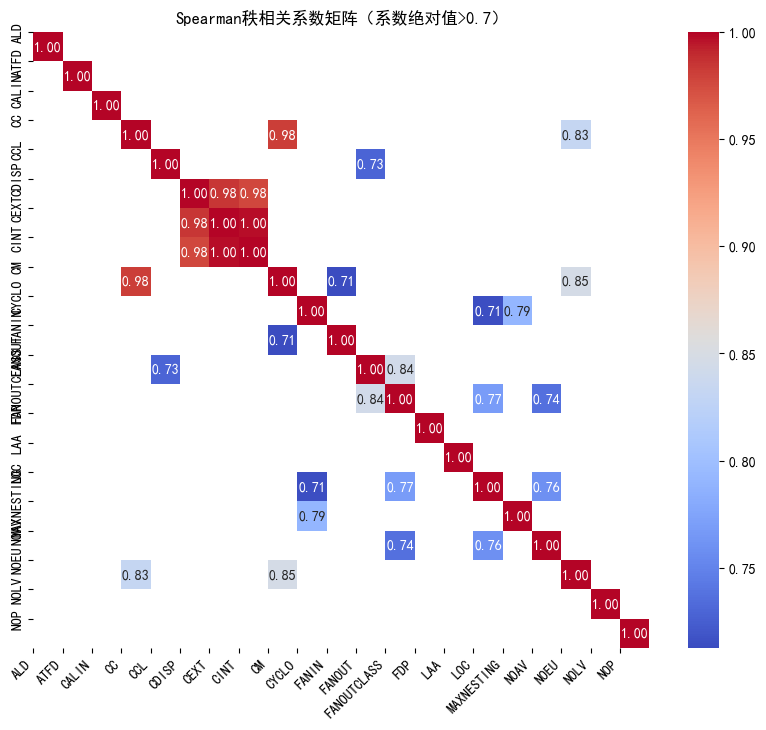

In [115]:
model = load_model('test_model\BM_new_GRU.h5')#加载CNN模型
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
column_names = df.columns[1:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,1:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['is_brain']
column_names = df.columns[1:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 195.04318760000024 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_9796\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


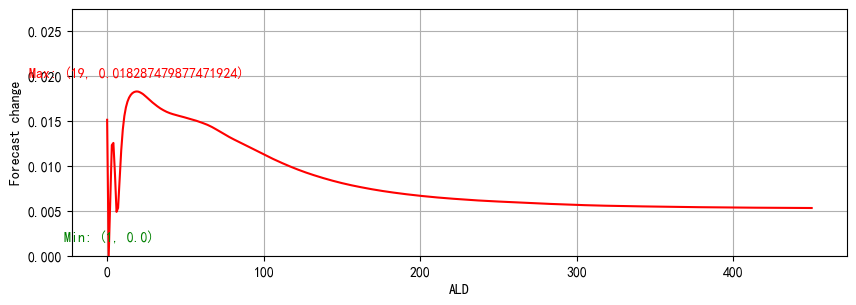

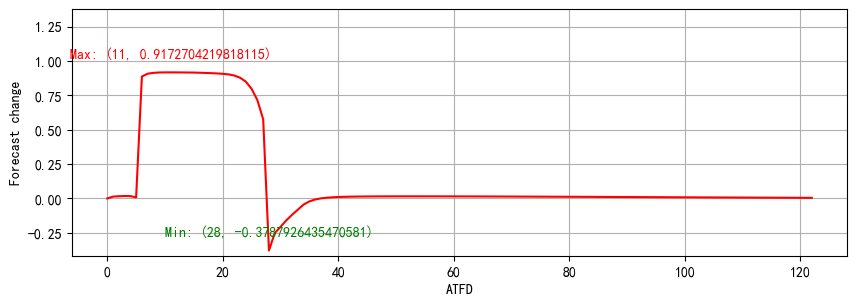

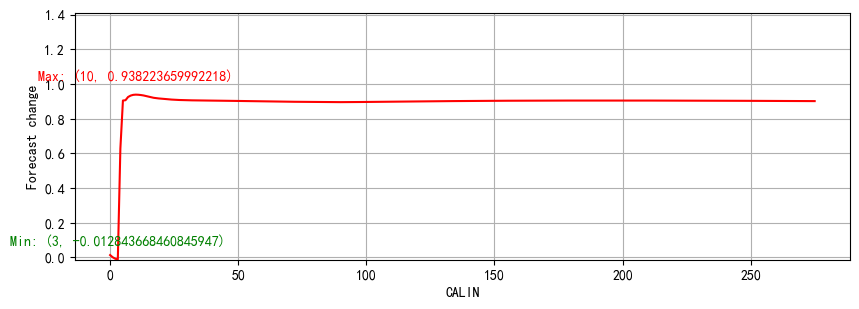

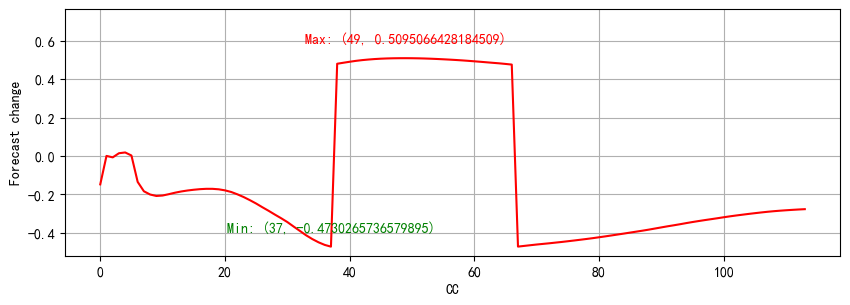

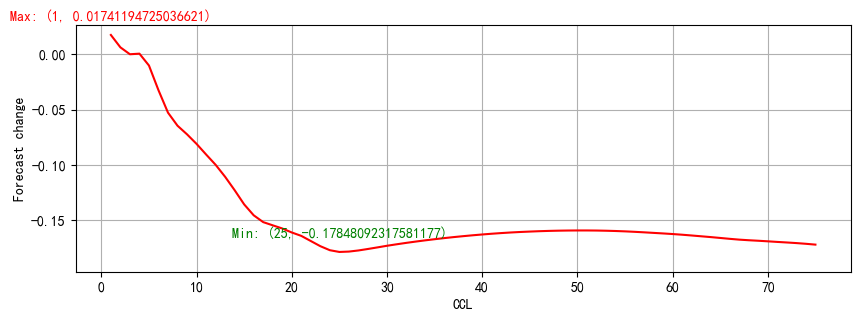

...

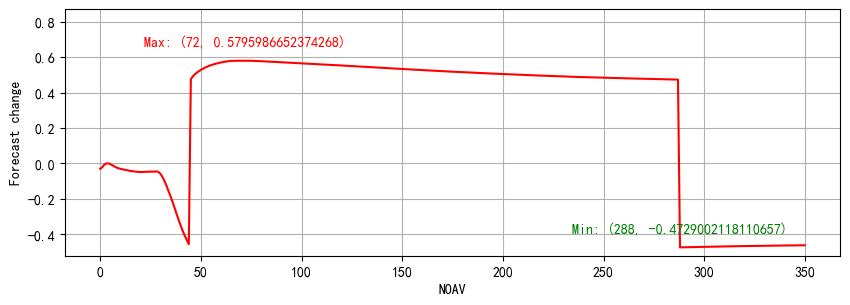

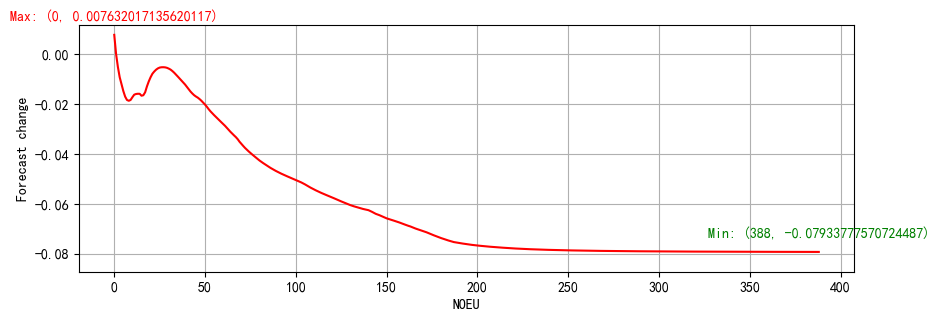

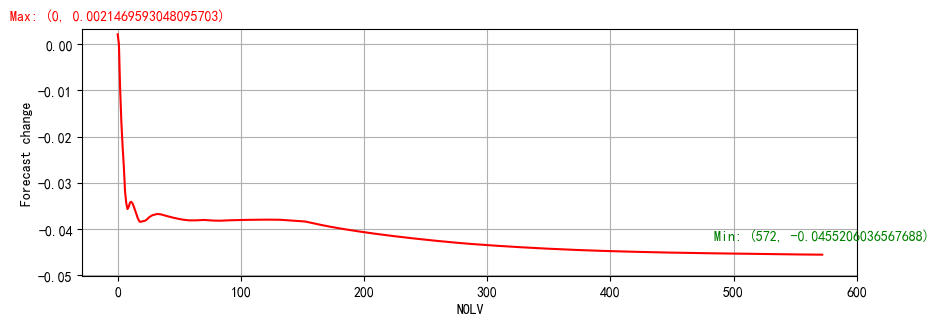

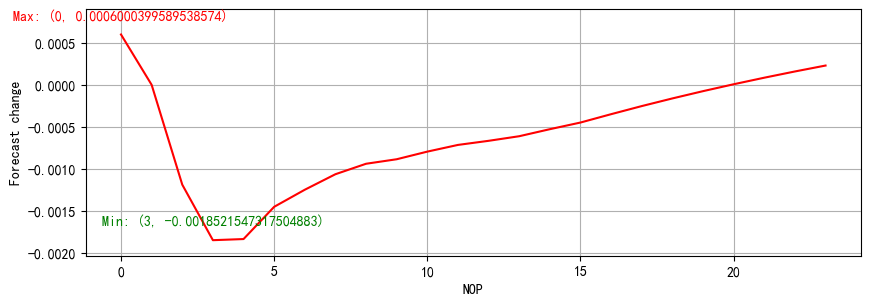

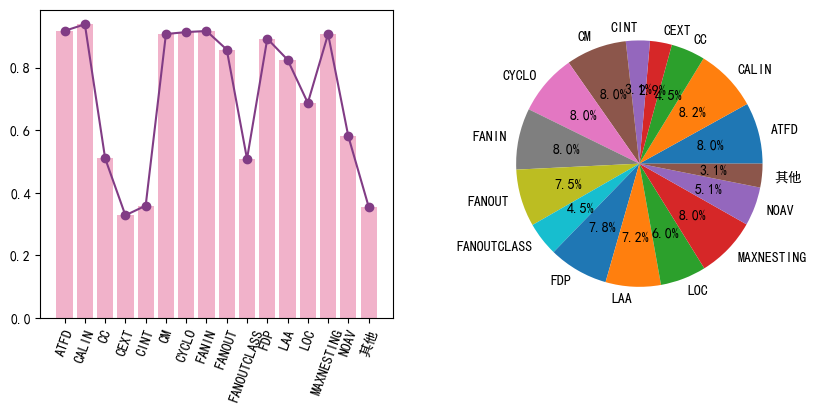

删除的特征为：['ALD', 'CDISP', 'CEXT', 'NOEU', 'NOLV', 'NOP']


In [116]:
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
base = df.iloc[:,1:-1]
base_data = base.mean()
base_data = base_data.round().astype(int)
base_data = base_data.values.reshape(1,base_data.shape[0],1)
x = base_data
x = tf.convert_to_tensor(x,dtype=tf.float32)
init_val = model.predict(x)
min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
max_values = visualization(column_names,y_list)
threshold = 2
feature_important(column_names,threshold,max_values)
column_names = df.columns[1:-1].tolist()
F_remove = feature_selection(column_names,feature_dict,rela_class,max_values)
print(f'删除的特征为：{F_remove}')

In [117]:
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:,-1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [118]:
inp=Input(shape=(x_train.shape[1:]))
lstm1=GRU(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
l=Dropout(0.5)(l)
d = Flatten()(l)
output = Dense(2, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(d)
model = Model(inputs=inp,outputs=output)

In [119]:
model.summary()

Model: "model_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_11 (InputLayer)        [(None, 15, 1)]           0         
_________________________________________________________________
gru_4 (GRU)                  (None, 15, 32)            3360      
_________________________________________________________________
dropout_50 (Dropout)         (None, 15, 32)            0         
_________________________________________________________________
dense_42 (Dense)             (None, 15, 64)            2112      
_________________________________________________________________
dropout_51 (Dropout)         (None, 15, 64)            0         
_________________________________________________________________
dense_43 (Dense)             (None, 15, 128)           8320      
_________________________________________________________________
dropout_52 (Dropout)         (None, 15, 128)           0  

In [120]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
import time
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=30,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()
print('Running time: %s Seconds'%(end-start))
print(model.evaluate(x_test,y_test))
Y_test = np.argmax(y_test, axis=1)
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

Epoch 1/30
3804/3804 [==============================] - 26s 6ms/step - loss: 0.3924 - accuracy: 0.8505 - val_loss: 0.2716 - val_accuracy: 0.9113
Epoch 2/30
3804/3804 [==============================] - 24s 6ms/step - loss: 0.2864 - accuracy: 0.9065 - val_loss: 0.2400 - val_accuracy: 0.9242
Epoch 3/30
3804/3804 [==============================] - 24s 6ms/step - loss: 0.2532 - accuracy: 0.9215 - val_loss: 0.2249 - val_accuracy: 0.9293
Epoch 4/30
3804/3804 [==============================] - 24s 6ms/step - loss: 0.2502 - accuracy: 0.9214 - val_loss: 0.2367 - val_accuracy: 0.9267
Epoch 5/30
3804/3804 [==============================] - 24s 6ms/step - loss: 0.2447 - accuracy: 0.9237 - val_loss: 0.2168 - val_accuracy: 0.9331
Epoch 6/30
3804/3804 [==============================] - 24s 6ms/step - loss: 0.2335 - accuracy: 0.9281 - val_loss: 0.2289 - val_accuracy: 0.9330
Epoch 7/30
3804/3804 [==============================] - 24s 6ms/step - loss: 0.2311 - accuracy: 0.9285 - val_loss: 0.2076 - val_ac

-----CNN+LSTM------------

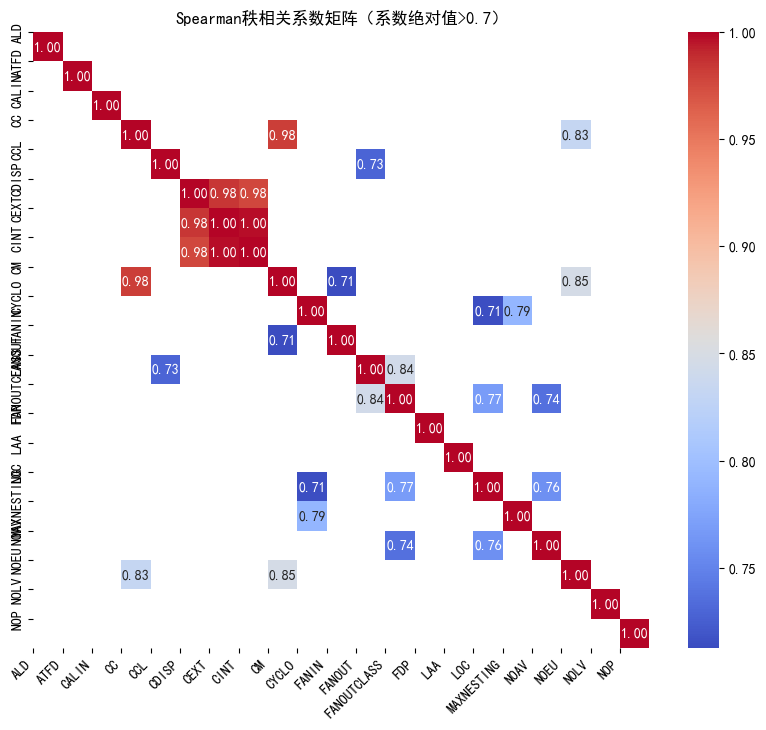

In [125]:
model = load_model('test_model\BM_new_CNN_LSTM.h5')#加载CNN模型
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
column_names = df.columns[1:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,1:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['is_brain']
column_names = df.columns[1:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 206.75229820000095 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_9796\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


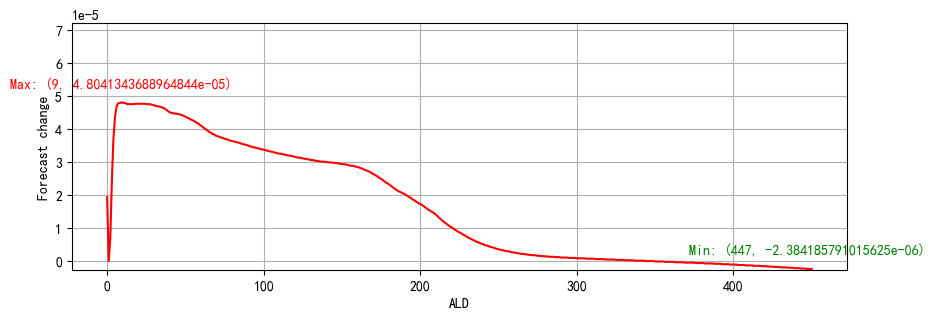

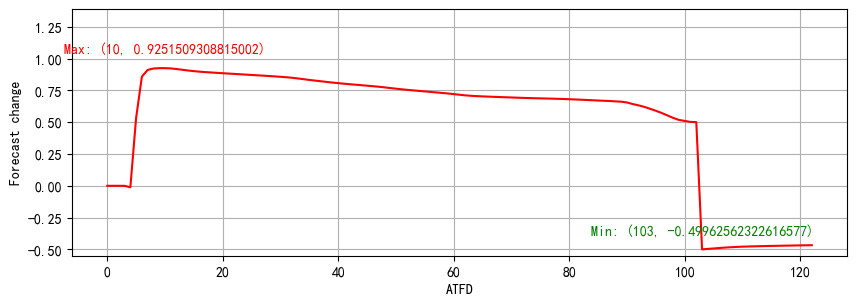

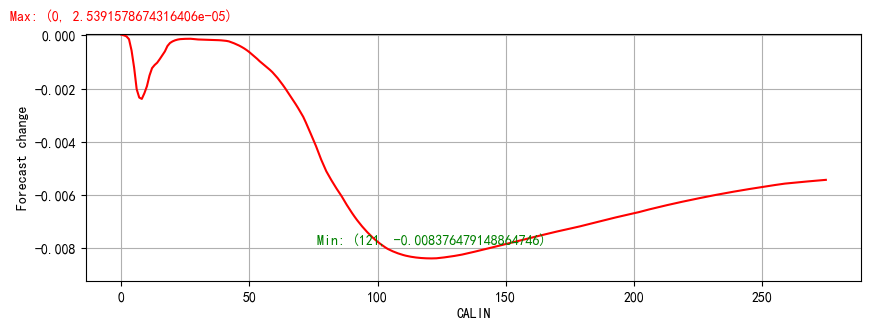

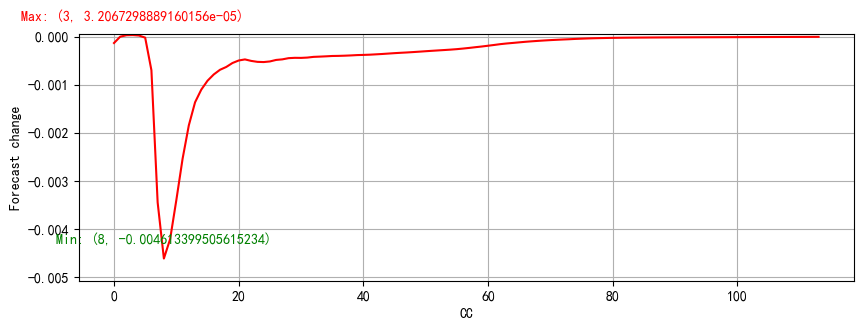

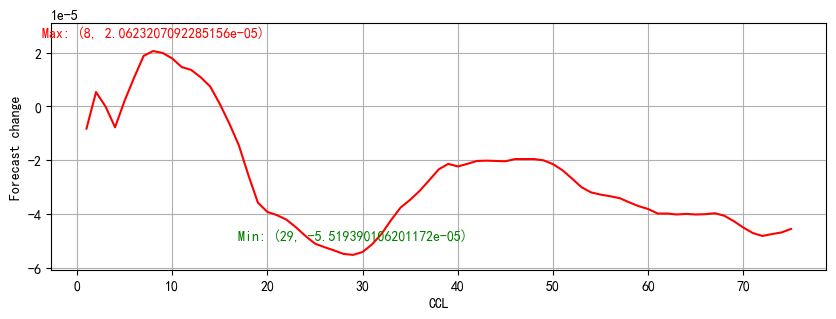

...

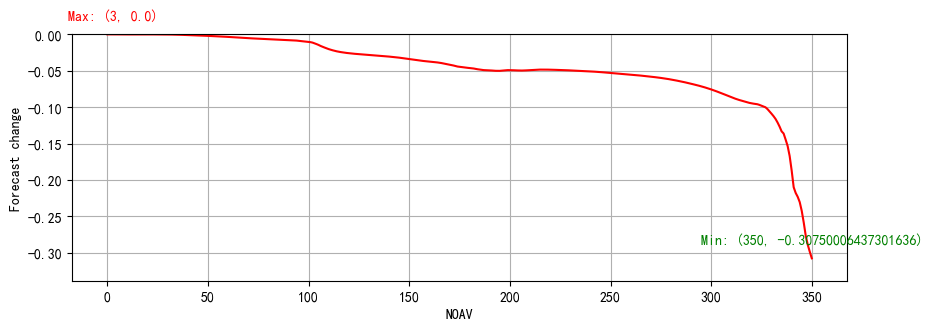

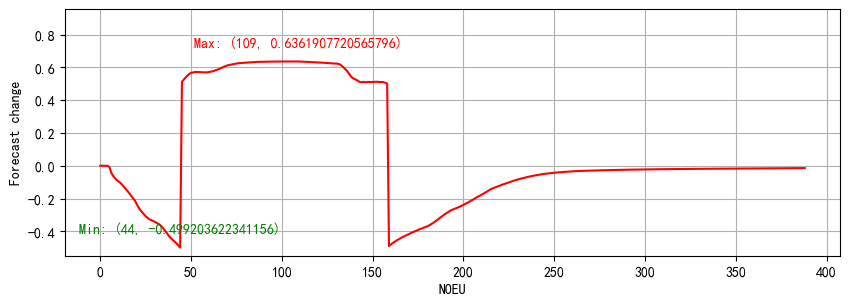

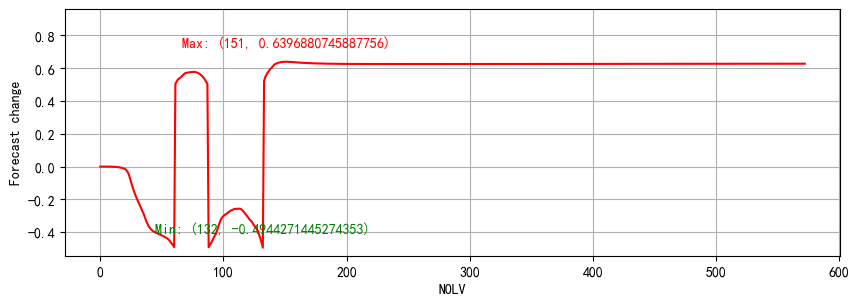

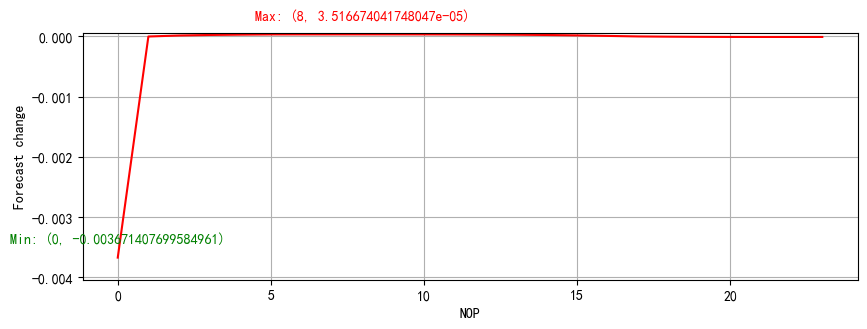

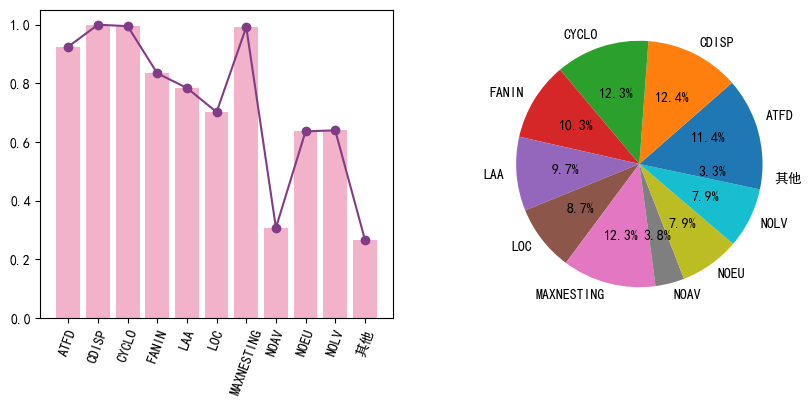

删除的特征为：['ALD', 'CALIN', 'CC', 'CCL', 'CEXT', 'CINT', 'CM', 'FANOUT', 'FANOUTCLASS', 'FDP', 'NOP']


In [126]:
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
base = df.iloc[:,1:-1]
base_data = base.mean()
base_data = base_data.round().astype(int)
base_data = base_data.values.reshape(1,base_data.shape[0],1)
x = base_data
x = tf.convert_to_tensor(x,dtype=tf.float32)
init_val = model.predict(x)
min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
max_values = visualization(column_names,y_list)
threshold = 2
feature_important(column_names,threshold,max_values)
column_names = df.columns[1:-1].tolist()
F_remove = feature_selection(column_names,feature_dict,rela_class,max_values)
print(f'删除的特征为：{F_remove}')

In [127]:
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:,-1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [128]:
inp=Input(shape=(x_train.shape[1:]))
x = Conv1D(32, 6, padding = "same", activation='tanh')(inp)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(64, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(128, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(256, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(256, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = Dense(512,activation='relu',kernel_regularizer=regularizers.l2(0.001))(x)
g = Flatten()(x)
lstm1=LSTM(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
l=Dropout(0.5)(l)
d = Flatten()(l)
g2=concatenate([g,d],axis=1)
output = Dense(2, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(g2)
model = Model(inputs=inp,outputs=output)

In [129]:
model.summary()

Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, 10, 1)]      0                                            
__________________________________________________________________________________________________
conv1d_28 (Conv1D)              (None, 10, 32)       224         input_13[0][0]                   
__________________________________________________________________________________________________
batch_normalization_16 (BatchNo (None, 10, 32)       128         conv1d_28[0][0]                  
__________________________________________________________________________________________________
conv1d_29 (Conv1D)              (None, 10, 64)       12352       batch_normalization_16[0][0]     
___________________________________________________________________________________________

In [130]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
import time
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=30,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()
print('Running time: %s Seconds'%(end-start))
print(model.evaluate(x_test,y_test))
Y_test = np.argmax(y_test, axis=1)
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

Epoch 1/30
3804/3804 [==============================] - 67s 17ms/step - loss: 0.3834 - accuracy: 0.8910 - val_loss: 0.2668 - val_accuracy: 0.9074
Epoch 2/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2373 - accuracy: 0.9194 - val_loss: 0.2349 - val_accuracy: 0.9229
Epoch 3/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2281 - accuracy: 0.9219 - val_loss: 0.2068 - val_accuracy: 0.9291
Epoch 4/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2192 - accuracy: 0.9238 - val_loss: 0.2058 - val_accuracy: 0.9307
Epoch 5/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2190 - accuracy: 0.9234 - val_loss: 0.2109 - val_accuracy: 0.9290
Epoch 6/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2141 - accuracy: 0.9251 - val_loss: 0.2005 - val_accuracy: 0.9306
Epoch 7/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2086 - accuracy: 0.9264 - val_loss: 0.2004 -

---------CNN+GRU----------

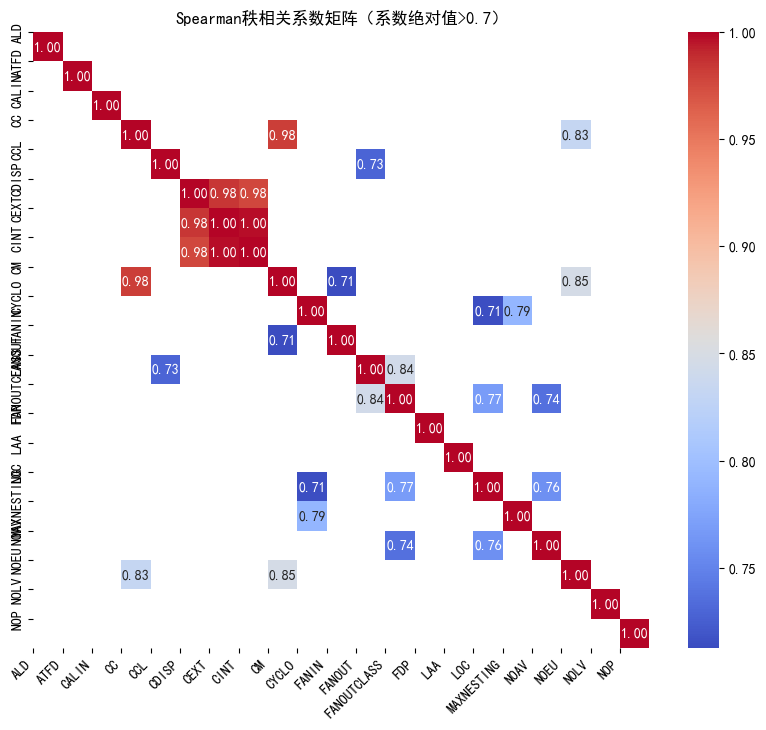

In [29]:
model = load_model('test_model\BM_new_CNN_GRU.h5')#加载CNN模型
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
column_names = df.columns[1:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,1:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['is_brain']
column_names = df.columns[1:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 207.5759747000002 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_9796\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


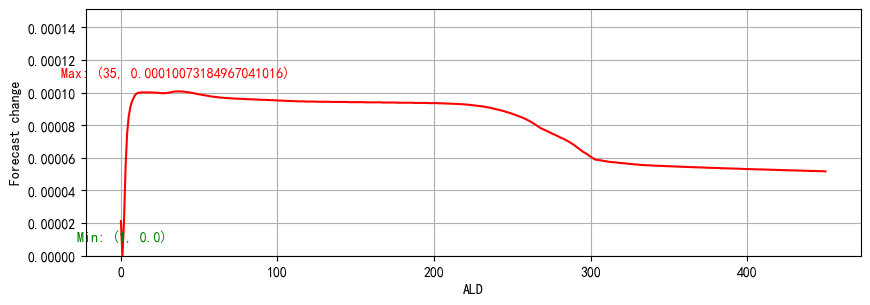

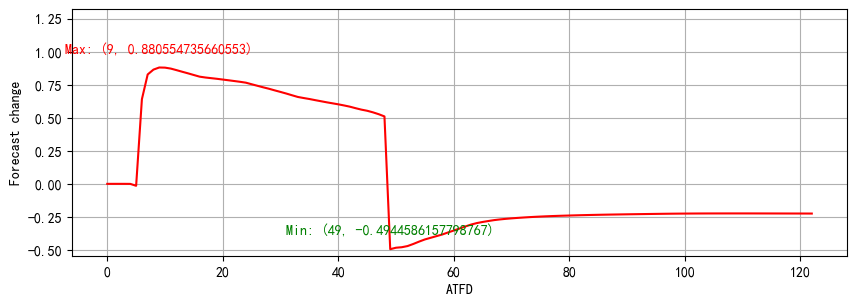

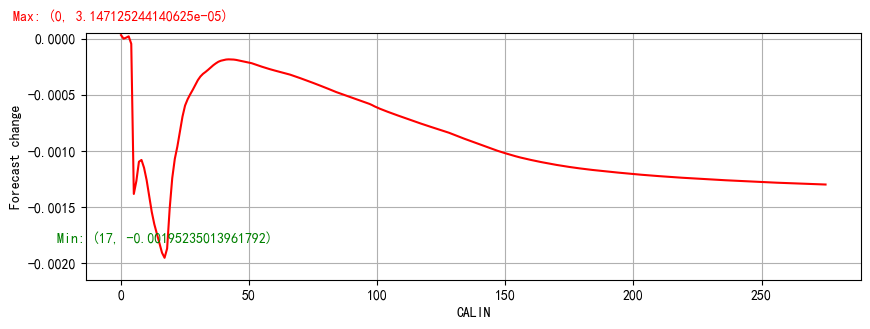

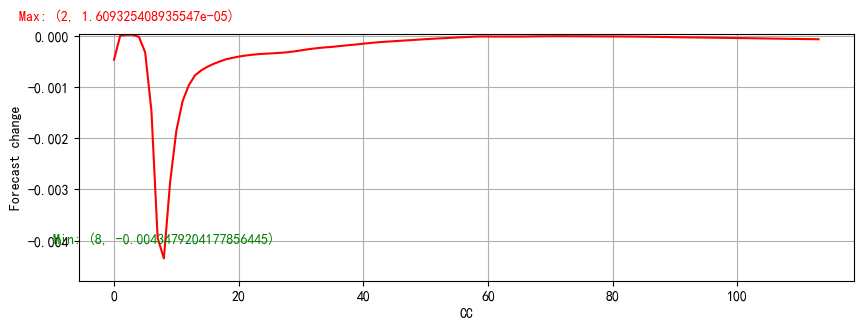

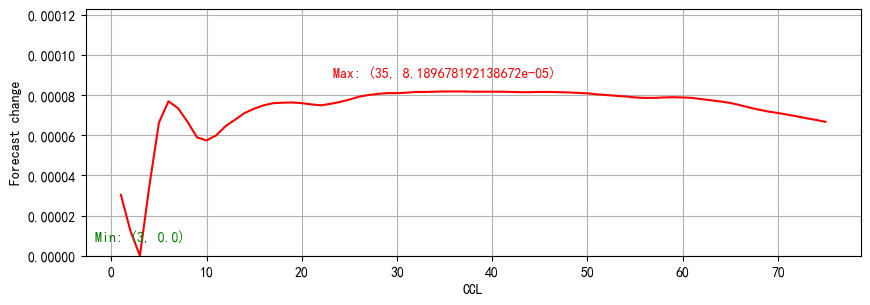

...

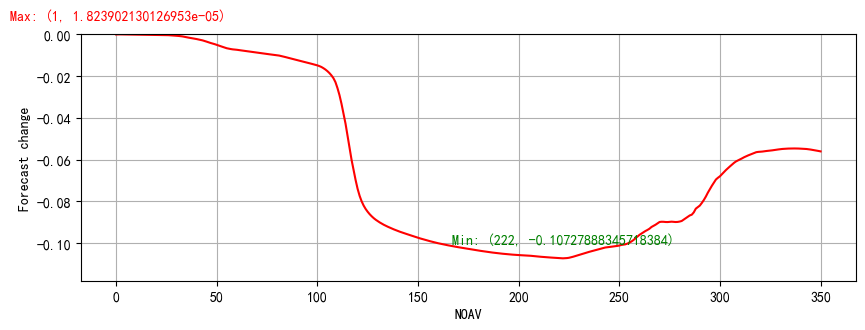

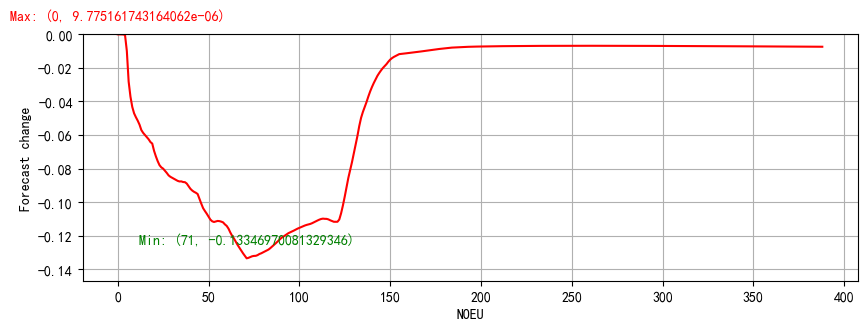

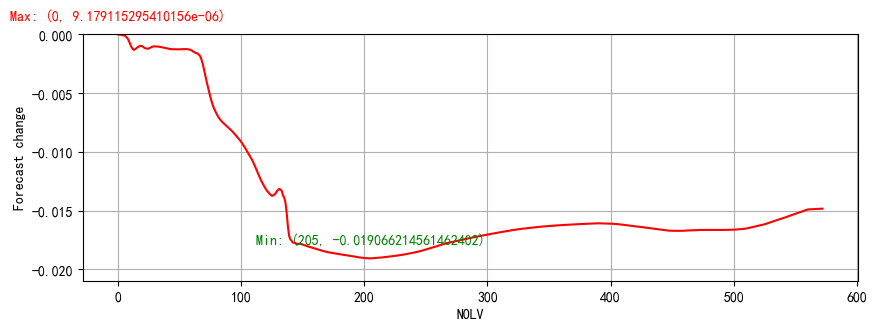

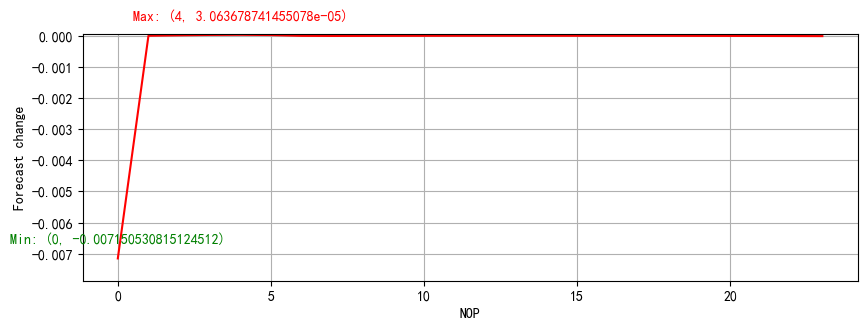

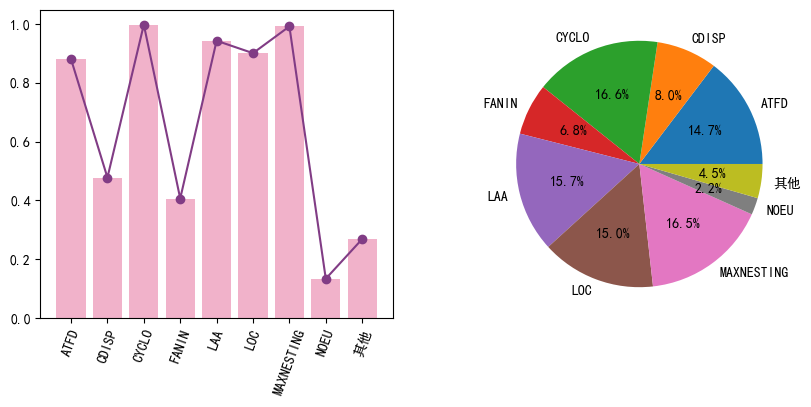

删除的特征为：['ALD', 'CALIN', 'CC', 'CCL', 'CEXT', 'CINT', 'CM', 'FANOUT', 'FANOUTCLASS', 'FDP', 'NOEU', 'NOLV', 'NOP']


In [30]:
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
base = df.iloc[:,1:-1]
base_data = base.mean()
base_data = base_data.round().astype(int)
base_data = base_data.values.reshape(1,base_data.shape[0],1)
x = base_data
x = tf.convert_to_tensor(x,dtype=tf.float32)
init_val = model.predict(x)
min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
max_values = visualization(column_names,y_list)
threshold = 2
feature_important(column_names,threshold,max_values)
column_names = df.columns[1:-1].tolist()
F_remove = feature_selection(column_names,feature_dict,rela_class,max_values)
print(f'删除的特征为：{F_remove}')

In [135]:
df = pd.read_csv("Dataset\BM.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:,-1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [136]:
inp=Input(shape=(x_train.shape[1:]))

x = Conv1D(32, 6, padding = "same", activation='tanh')(inp)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(64, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(128, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(256, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(256, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = Dense(512,activation='relu',kernel_regularizer=regularizers.l2(0.001))(x)
g = Flatten()(x)
gru=GRU(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(gru)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
l=Dropout(0.5)(l)
d = Flatten()(l)
g2=concatenate([g,d],axis=1)
output = Dense(2, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(g2)
model = Model(inputs=inp,outputs=output)

In [137]:
model.summary()

Model: "model_14"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_15 (InputLayer)           [(None, 10, 1)]      0                                            
__________________________________________________________________________________________________
conv1d_42 (Conv1D)              (None, 10, 32)       224         input_15[0][0]                   
__________________________________________________________________________________________________
batch_normalization_22 (BatchNo (None, 10, 32)       128         conv1d_42[0][0]                  
__________________________________________________________________________________________________
conv1d_43 (Conv1D)              (None, 10, 64)       12352       batch_normalization_22[0][0]     
___________________________________________________________________________________________

In [138]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
import time
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=30,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()
print('Running time: %s Seconds'%(end-start))
print(model.evaluate(x_test,y_test))
Y_test = np.argmax(y_test, axis=1)
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

Epoch 1/30
3804/3804 [==============================] - 66s 17ms/step - loss: 0.3933 - accuracy: 0.8918 - val_loss: 0.2316 - val_accuracy: 0.9251
Epoch 2/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2379 - accuracy: 0.9197 - val_loss: 0.2166 - val_accuracy: 0.9284
Epoch 3/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2262 - accuracy: 0.9225 - val_loss: 0.2095 - val_accuracy: 0.9302
Epoch 4/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2208 - accuracy: 0.9235 - val_loss: 0.2085 - val_accuracy: 0.9290
Epoch 5/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2170 - accuracy: 0.9250 - val_loss: 0.2070 - val_accuracy: 0.9293
Epoch 6/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2150 - accuracy: 0.9254 - val_loss: 0.2028 - val_accuracy: 0.9310
Epoch 7/30
3804/3804 [==============================] - 64s 17ms/step - loss: 0.2112 - accuracy: 0.9262 - val_loss: 0.2019 -

# LM

In [367]:
%run correlation_analysis.ipynb
%run Data_perturbation.ipynb
%run Feature_selection.ipynb
from keras.models import load_model
model = load_model('test_model\com_LM_cnn.h5')#加载CNN模型
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")

In [368]:
column_names = df.columns[3:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,3:-1]

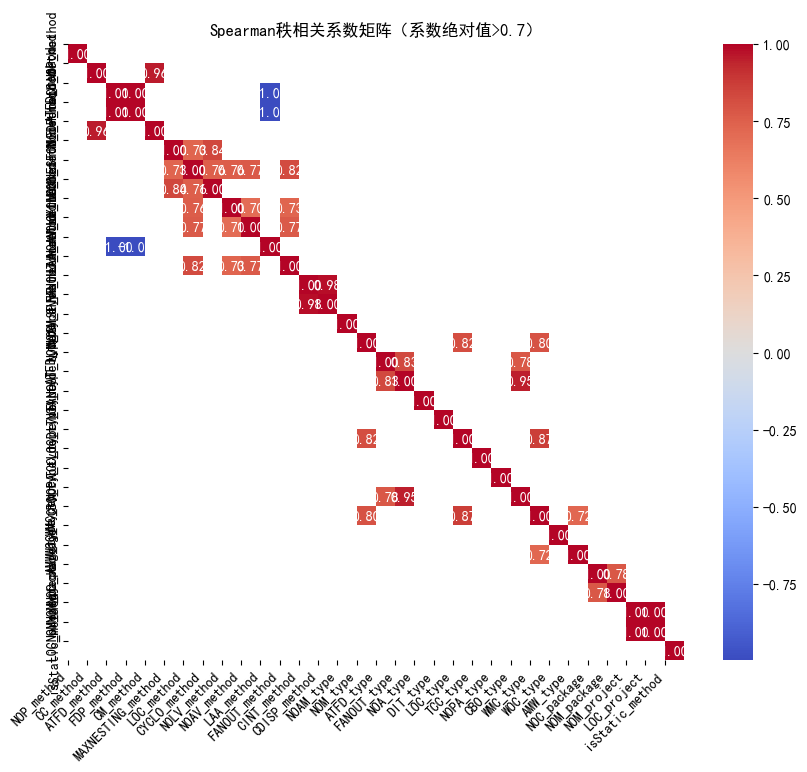

In [369]:
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)

In [370]:
target_variable = df['is_long methood']

In [371]:
column_names = df.columns[3:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

In [372]:
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")
base = df.iloc[:,3:-1]
base_data = base.mean()
base_data = base_data.round().astype(int)
base_data = base_data.values.reshape(1,base_data.shape[0],1)
x = base_data

In [373]:
x = tf.convert_to_tensor(x,dtype=tf.float32)
init_val = model.predict(x)

In [374]:
min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)

In [375]:
y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)

Running time: 172.39153400000214 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_14636\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))
C:\Users\liang\AppData\Local\Temp\ipykernel_14636\3054686753.py:21: UserWarning: Attempting to set identical bottom == top == 0.0 results in singular transformations; automatically expanding.
  plt.ylim(y_list_min[i]*1.1,y_list_max[i]*1.5)


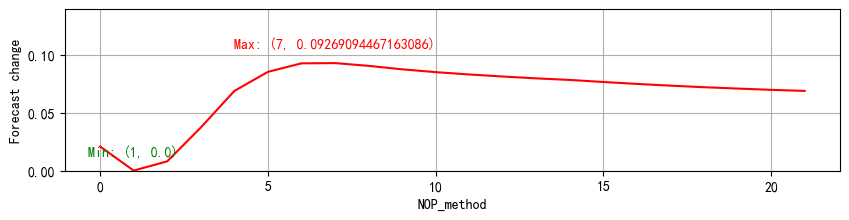

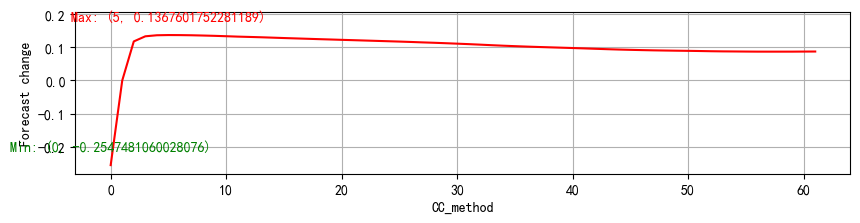

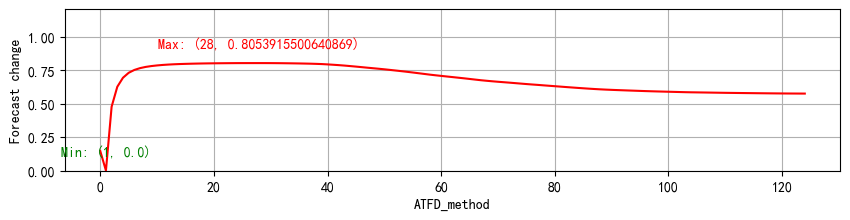

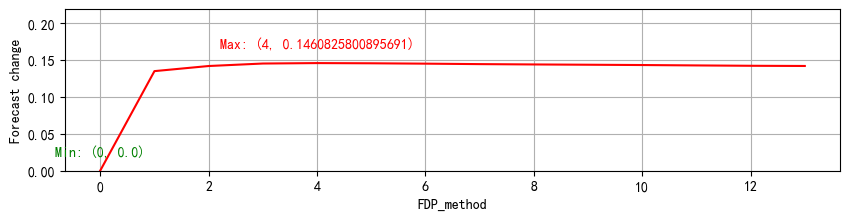

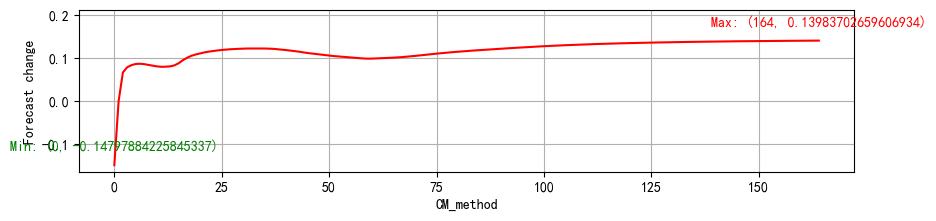

...

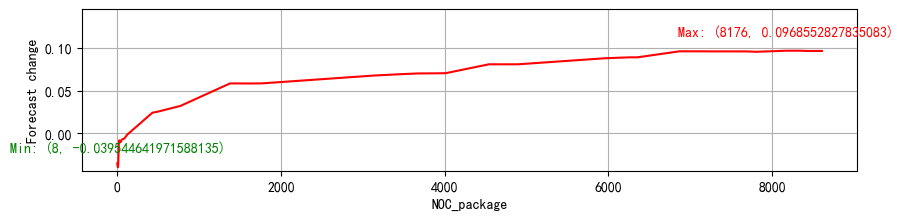

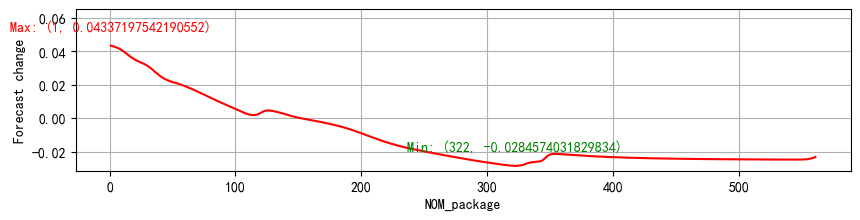

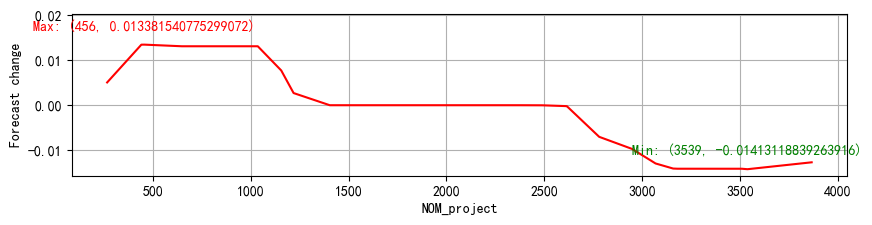

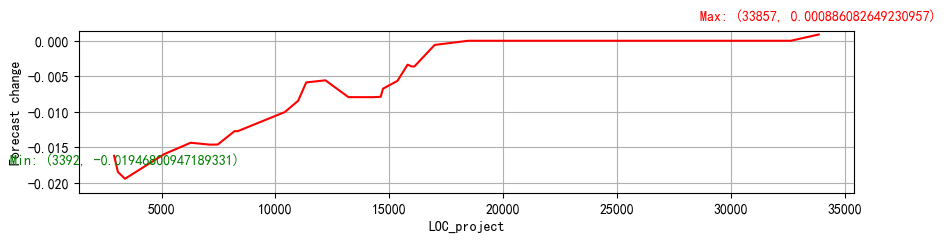

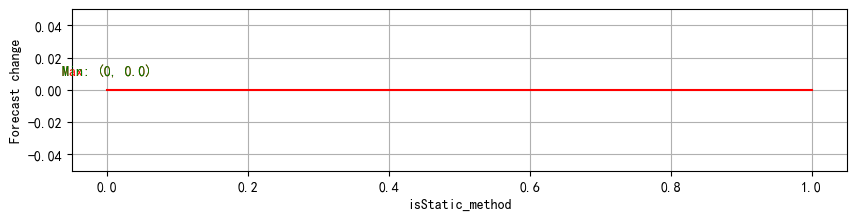

In [376]:
max_values = visualization(column_names,y_list)

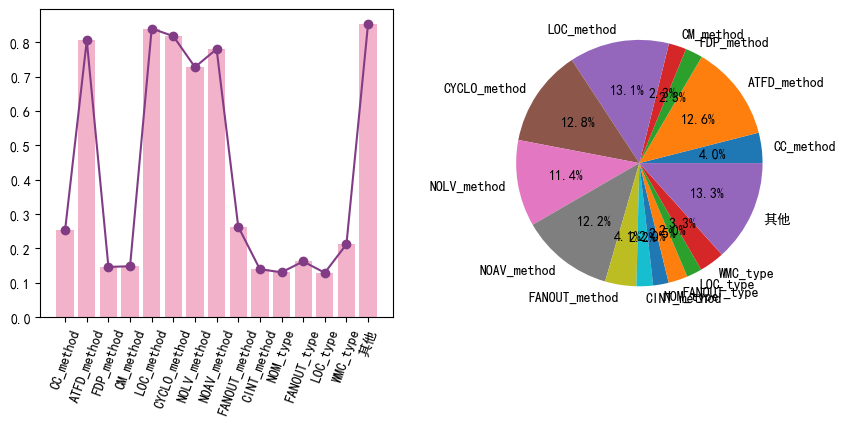

In [377]:
threshold = 2
feature_important(column_names,threshold,max_values)

In [378]:
column_names = df.columns[3:-1].tolist()
F_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [379]:
F_remove

['NOP_method',
 'CM_method',
 'LAA_method',
 'CDISP_method',
 'NOM_type',
 'ATFD_type',
 'NOA_type',
 'DIT_type',
 'LOC_type',
 'TCC_type',
 'NOPA_type',
 'CBO_type',
 'WOC_type',
 'AMW_type',
 'NOC_package',
 'NOM_package',
 'NOM_project',
 'LOC_project',
 'isStatic_method']

In [415]:
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow import keras
from keras import regularizers
from keras.layers import Dense,Flatten,Conv1D,MaxPooling1D,Dropout,BatchNormalization
from tensorflow.keras import Sequential
from tensorflow.keras import Model
from tensorflow.keras import layers
from sklearn.preprocessing import OneHotEncoder
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
from imblearn.over_sampling import SMOTE

In [416]:
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")
x, y = df.iloc[:, 3:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)

In [417]:
columns_to_drop = F_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped

In [418]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [419]:
inp=Input(shape=(x_train.shape[1:]))

x = Conv1D(32, 6, padding="same", activation='tanh')(inp)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same', activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same', activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = Flatten()(x)
q = Dense(128)(x)
q = LeakyReLU(alpha=0.33)(q)
q = Dropout(0.5)(q)
output = Dense(2, kernel_regularizer=tf.keras.regularizers.l2(0.01), activation='softmax')(q)
model = Model(inputs=inp,outputs=output)

In [420]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )

In [421]:
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)

In [422]:
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=30,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/30
500/500 [==============================] - 5s 8ms/step - loss: 0.4260 - accuracy: 0.8512 - val_loss: 0.1971 - val_accuracy: 0.9367
Epoch 2/30
500/500 [==============================] - 4s 8ms/step - loss: 0.2290 - accuracy: 0.9249 - val_loss: 0.1885 - val_accuracy: 0.9412
Epoch 3/30
500/500 [==============================] - 4s 8ms/step - loss: 0.1968 - accuracy: 0.9344 - val_loss: 0.1475 - val_accuracy: 0.9450
Epoch 4/30
500/500 [==============================] - 4s 8ms/step - loss: 0.1817 - accuracy: 0.9367 - val_loss: 0.1350 - val_accuracy: 0.9485
Epoch 5/30
500/500 [==============================] - 4s 8ms/step - loss: 0.1731 - accuracy: 0.9395 - val_loss: 0.1393 - val_accuracy: 0.9477
Epoch 6/30
500/500 [==============================] - 4s 8ms/step - loss: 0.1724 - accuracy: 0.9404 - val_loss: 0.1383 - val_accuracy: 0.9515
Epoch 7/30
500/500 [==============================] - 4s 8ms/step - loss: 0.1596 - accuracy: 0.9421 - val_loss: 0.1271 - val_accuracy: 0.9620
Epoch 

In [423]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

125/125 [==============================] - 0s 3ms/step - loss: 0.0890 - accuracy: 0.9707
[0.08902362734079361, 0.9707353711128235]
Running time: 116.08634719999827 Seconds
              precision    recall  f1-score   support

           0    0.97043   0.97091   0.97067      1994
           1    0.97104   0.97056   0.97080      2004

    accuracy                        0.97074      3998
   macro avg    0.97073   0.97074   0.97074      3998
weighted avg    0.97074   0.97074   0.97074      3998



---------lstm----------

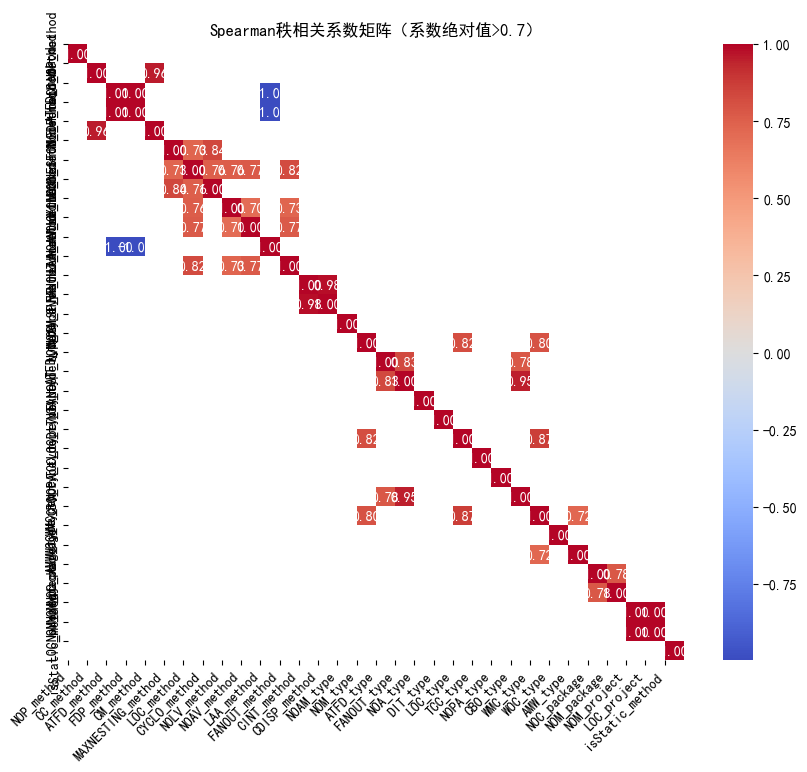

In [274]:
model = load_model('test_model\com_LM_lstm.h5')#加载CNN模型
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")
column_names = df.columns[3:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,3:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['is_long methood']
column_names = df.columns[3:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 178.50238309999986 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_9796\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))
C:\Users\liang\AppData\Local\Temp\ipykernel_9796\3054686753.py:21: UserWarning: Attempting to set identical bottom == top == 0.0 results in singular transformations; automatically expanding.
  plt.ylim(y_list_min[i]*1.1,y_list_max[i]*1.5)


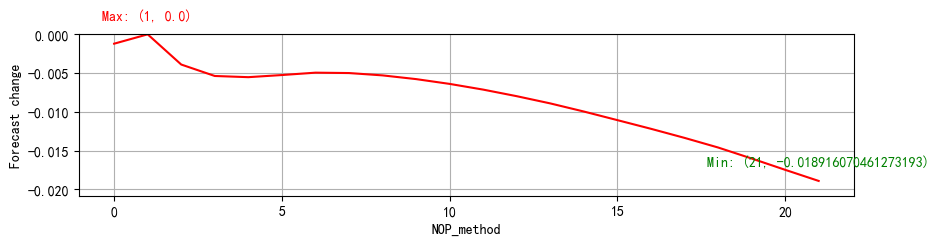

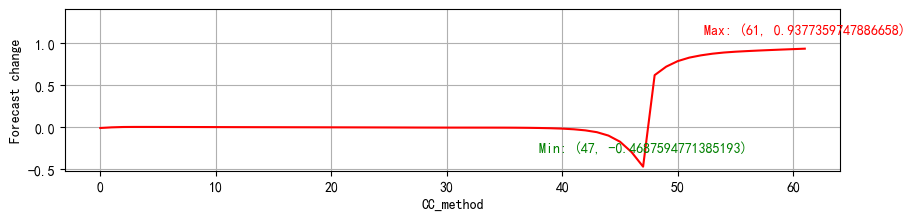

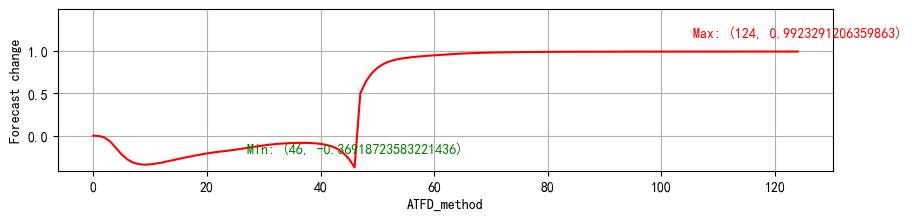

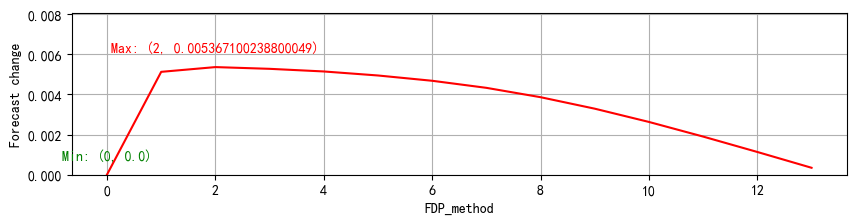

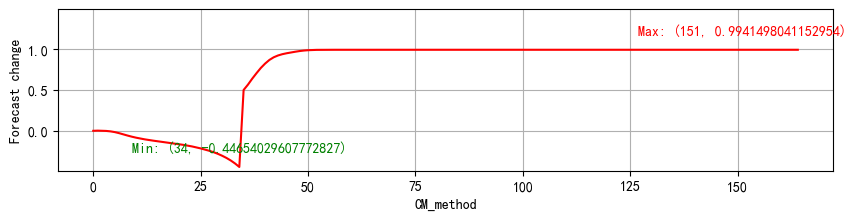

...

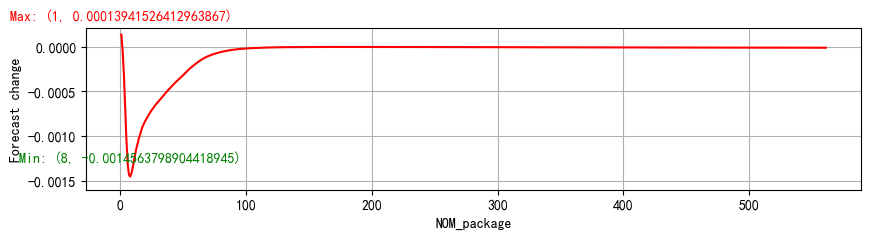

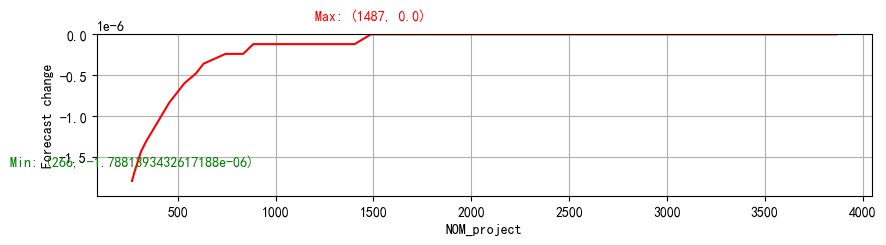

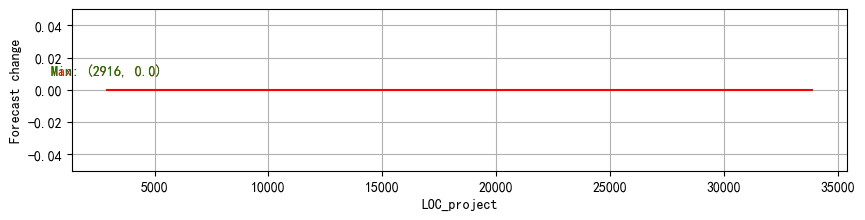

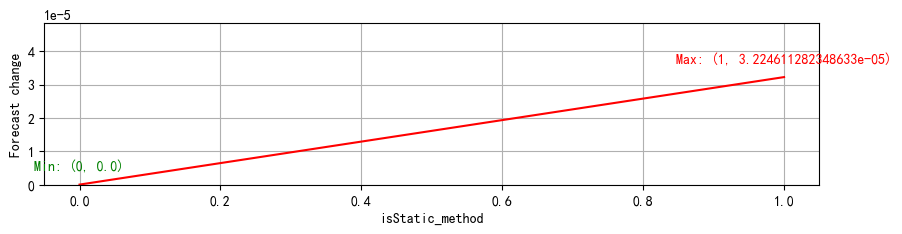

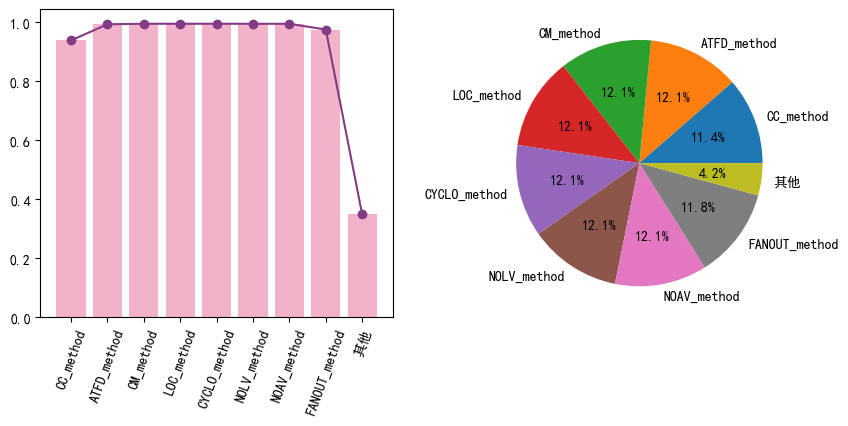

In [275]:
base = df.iloc[:,3:-1]
base_data = base.mean()
base_data = base_data.round().astype(int)
base_data = base_data.values.reshape(1,base_data.shape[0],1)
x = base_data
x = tf.convert_to_tensor(x,dtype=tf.float32)
init_val = model.predict(x)
min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
max_values = visualization(column_names,y_list)
threshold = 2
feature_important(column_names,threshold,max_values)
column_names = df.columns[3:-1].tolist()
F_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [283]:
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")
x, y = df.iloc[:, 3:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [284]:
inp=Input(shape=(x_train.shape[1:]))
lstm1=LSTM(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
l=Dropout(0.5)(l)
d = Flatten()(l)
output = Dense(2, kernel_regularizer=tf.keras.regularizers.l2(0.01), activation='softmax')(d)
model = Model(inputs=inp,outputs=output)
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=30,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/30
500/500 [==============================] - 5s 7ms/step - loss: 0.3890 - accuracy: 0.8361 - val_loss: 0.2142 - val_accuracy: 0.9265
Epoch 2/30
500/500 [==============================] - 3s 6ms/step - loss: 0.2193 - accuracy: 0.9286 - val_loss: 0.1865 - val_accuracy: 0.9430
Epoch 3/30
500/500 [==============================] - 3s 6ms/step - loss: 0.1947 - accuracy: 0.9392 - val_loss: 0.1686 - val_accuracy: 0.9457
Epoch 4/30
500/500 [==============================] - 3s 6ms/step - loss: 0.1829 - accuracy: 0.9440 - val_loss: 0.1649 - val_accuracy: 0.9445
Epoch 5/30
500/500 [==============================] - 3s 6ms/step - loss: 0.1673 - accuracy: 0.9474 - val_loss: 0.1621 - val_accuracy: 0.9447
Epoch 6/30
500/500 [==============================] - 3s 6ms/step - loss: 0.1736 - accuracy: 0.9447 - val_loss: 0.1687 - val_accuracy: 0.9457
Epoch 7/30
500/500 [==============================] - 3s 6ms/step - loss: 0.1623 - accuracy: 0.9473 - val_loss: 0.1557 - val_accuracy: 0.9482
Epoch 

In [285]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

125/125 [==============================] - 0s 3ms/step - loss: 0.1303 - accuracy: 0.9515
[0.13026084005832672, 0.9514757394790649]
Running time: 99.78880699999718 Seconds
              precision    recall  f1-score   support

           0    0.93394   0.97141   0.95231      1994
           1    0.97037   0.93164   0.95061      2004

    accuracy                        0.95148      3998
   macro avg    0.95216   0.95153   0.95146      3998
weighted avg    0.95220   0.95148   0.95146      3998



--------gru---------------

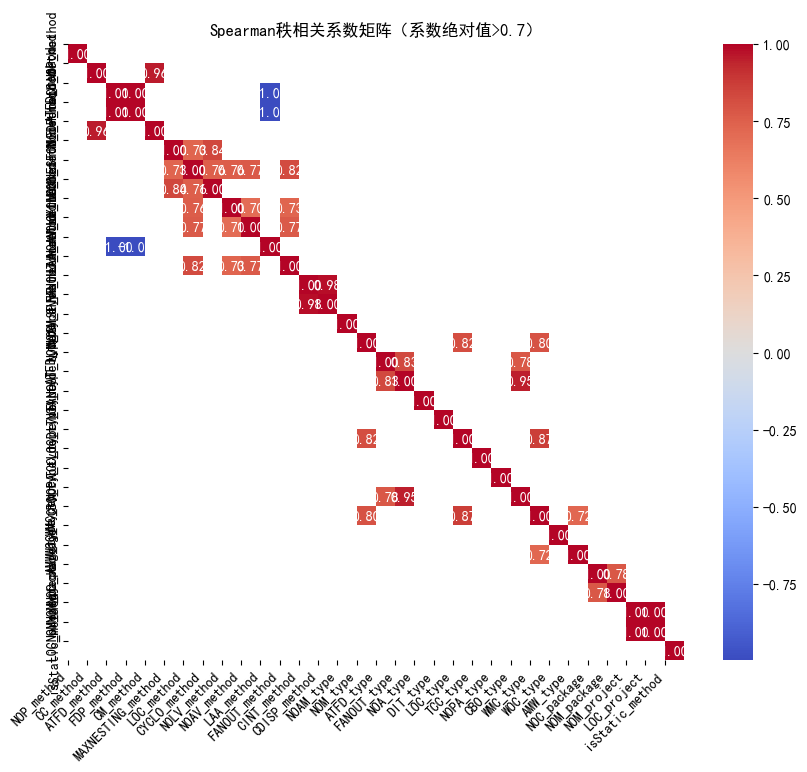

In [540]:
model = load_model('test_model\com_LM_gru.h5')#加载CNN模型
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")

column_names = df.columns[3:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,3:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['is_long methood']
column_names = df.columns[3:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 189.90324110000802 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_9796\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))
C:\Users\liang\AppData\Local\Temp\ipykernel_9796\3054686753.py:21: UserWarning: Attempting to set identical bottom == top == 0.0 results in singular transformations; automatically expanding.
  plt.ylim(y_list_min[i]*1.1,y_list_max[i]*1.5)


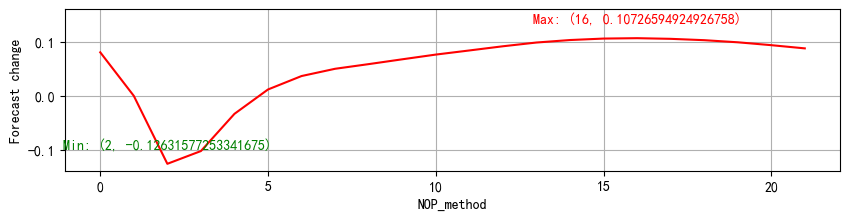

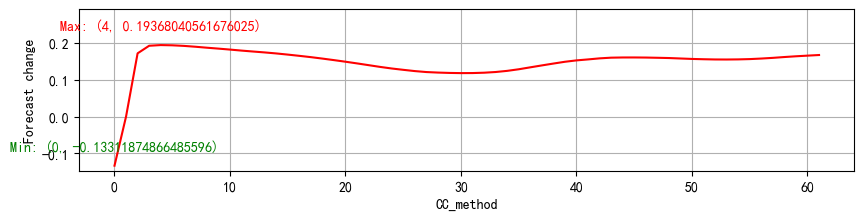

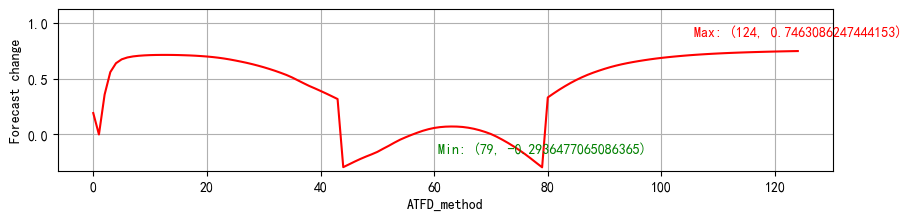

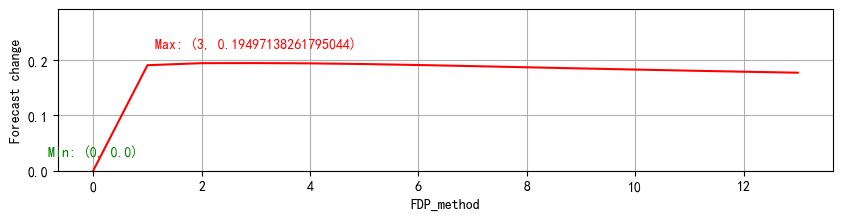

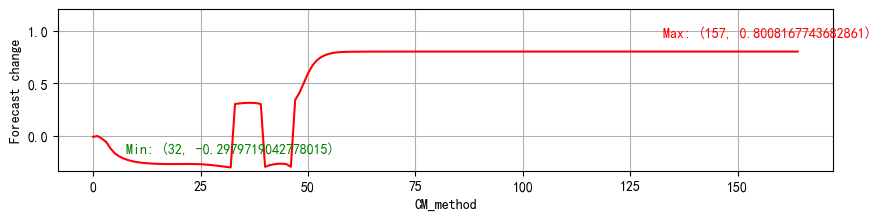

...

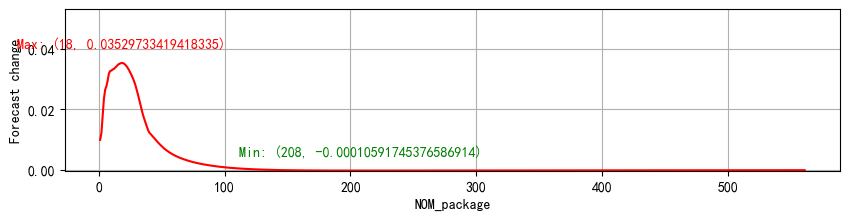

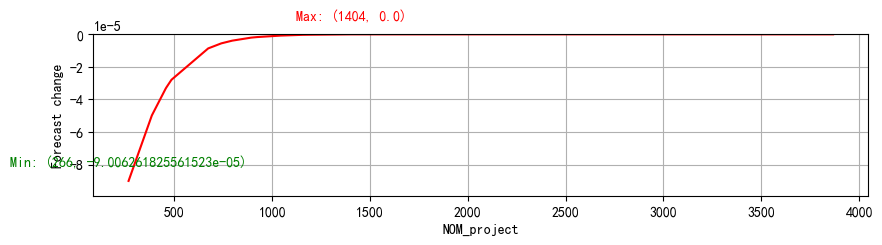

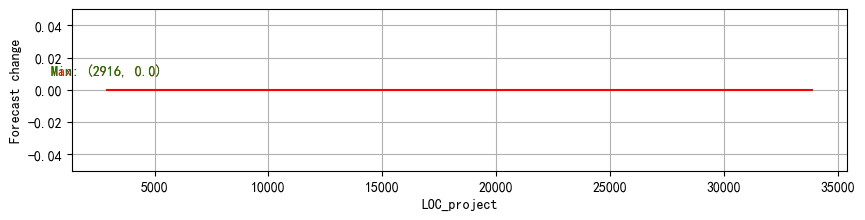

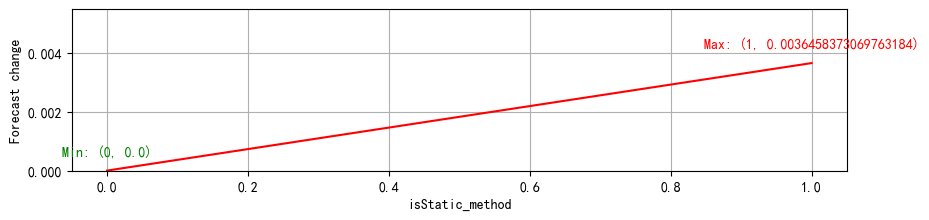

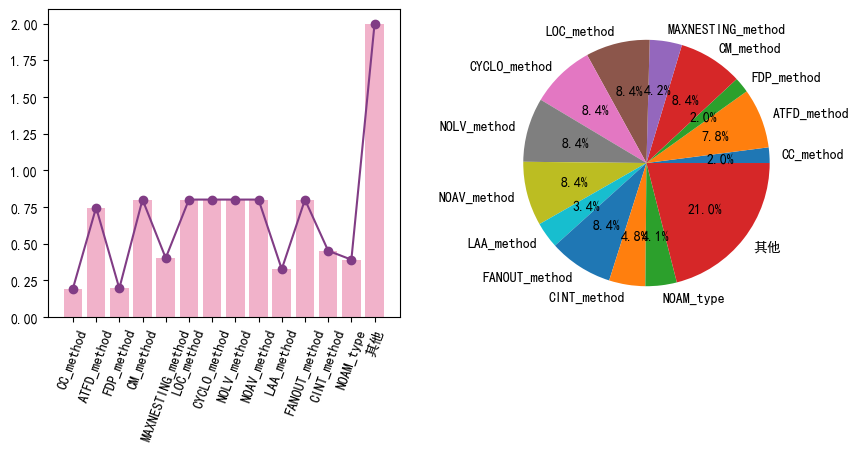

In [542]:
base = df.iloc[:,3:-1]
base_data = base.mean()
base_data = base_data.round().astype(int)
base_data = base_data.values.reshape(1,base_data.shape[0],1)
x = base_data
x = tf.convert_to_tensor(x,dtype=tf.float32)
init_val = model.predict(x)
min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
max_values = visualization(column_names,y_list)
threshold = 2
feature_important(column_names,threshold,max_values)
column_names = df.columns[3:-1].tolist()
F_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [543]:
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")
x, y = df.iloc[:, 3:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [488]:
x_train.shape

(15990, 20, 1)

In [489]:
inp=Input(shape=(x_train.shape[1:]))
lstm1=GRU(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
l=Dropout(0.5)(l)
d = Flatten()(l)
output = Dense(2, kernel_regularizer=tf.keras.regularizers.l2(0.01), activation='softmax')(d)
model = Model(inputs=inp,outputs=output)
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=30,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/30
500/500 [==============================] - 5s 8ms/step - loss: 0.3239 - accuracy: 0.8800 - val_loss: 0.1687 - val_accuracy: 0.9427
Epoch 2/30
500/500 [==============================] - 4s 7ms/step - loss: 0.1697 - accuracy: 0.9425 - val_loss: 0.1772 - val_accuracy: 0.9362
Epoch 3/30
500/500 [==============================] - 4s 7ms/step - loss: 0.1627 - accuracy: 0.9487 - val_loss: 0.1311 - val_accuracy: 0.9627
Epoch 4/30
500/500 [==============================] - 3s 7ms/step - loss: 0.1404 - accuracy: 0.9542 - val_loss: 0.1220 - val_accuracy: 0.9667
Epoch 5/30
500/500 [==============================] - 4s 7ms/step - loss: 0.1318 - accuracy: 0.9579 - val_loss: 0.1260 - val_accuracy: 0.9642
Epoch 6/30
500/500 [==============================] - 3s 7ms/step - loss: 0.1265 - accuracy: 0.9598 - val_loss: 0.1146 - val_accuracy: 0.9657
Epoch 7/30
500/500 [==============================] - 4s 7ms/step - loss: 0.1217 - accuracy: 0.9635 - val_loss: 0.1255 - val_accuracy: 0.9617
Epoch 

In [490]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

125/125 [==============================] - 0s 4ms/step - loss: 0.0774 - accuracy: 0.9795
[0.07744605839252472, 0.9794897437095642]
Running time: 107.99694219999947 Seconds
              precision    recall  f1-score   support

           0    0.98283   0.97593   0.97937      1994
           1    0.97621   0.98303   0.97961      2004

    accuracy                        0.97949      3998
   macro avg    0.97952   0.97948   0.97949      3998
weighted avg    0.97951   0.97949   0.97949      3998



-----------CNN+LSTM------------

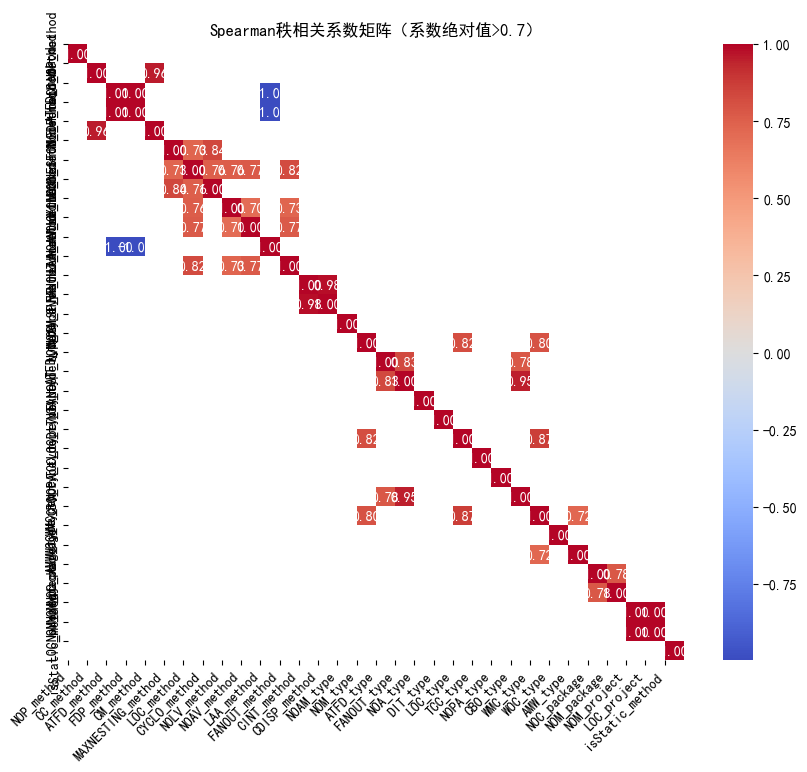

In [548]:
model = load_model('test_model\com_LM_cnn_lstm.h5')#加载CNN模型
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")

column_names = df.columns[3:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,3:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['is_long methood']
column_names = df.columns[3:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 179.64072250000027 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_9796\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


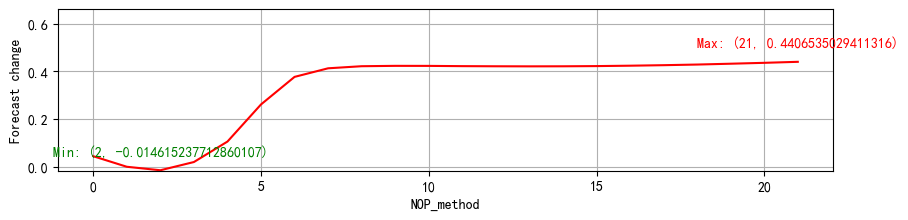

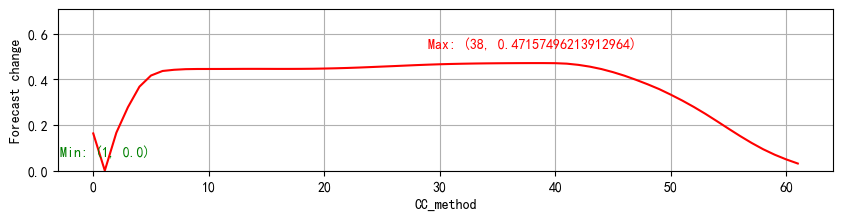

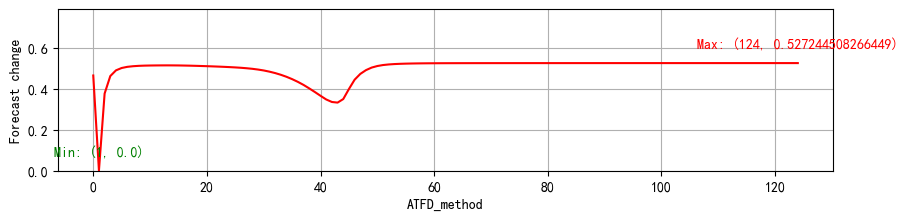

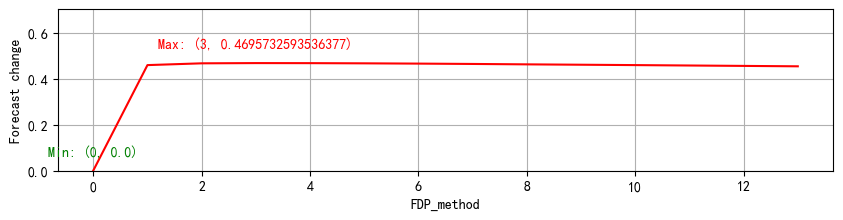

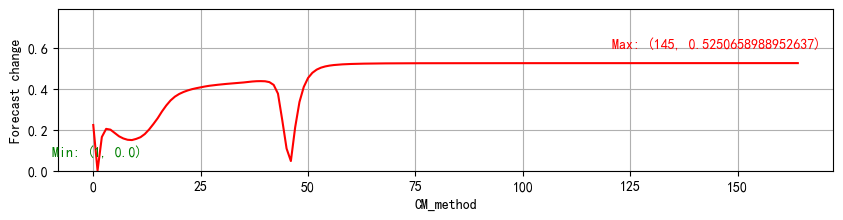

...

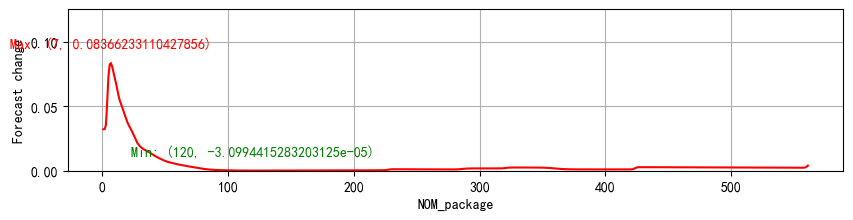

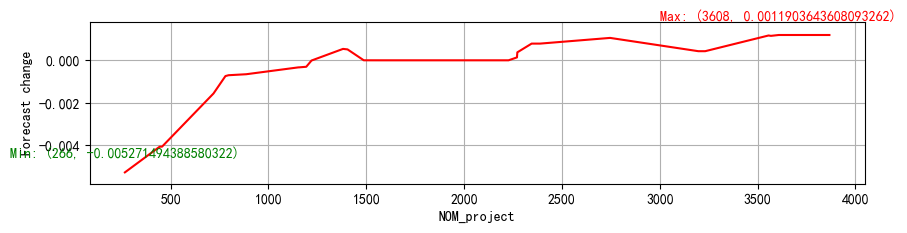

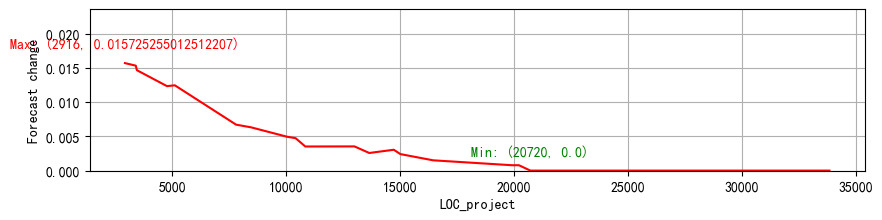

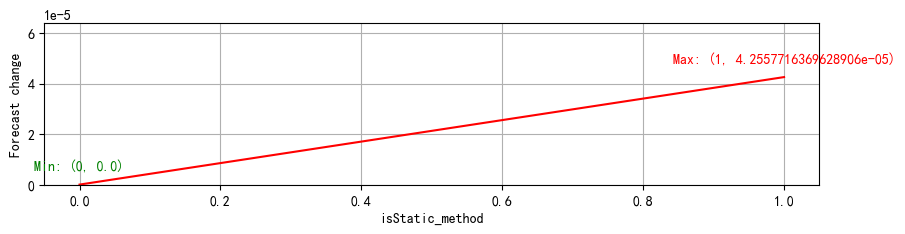

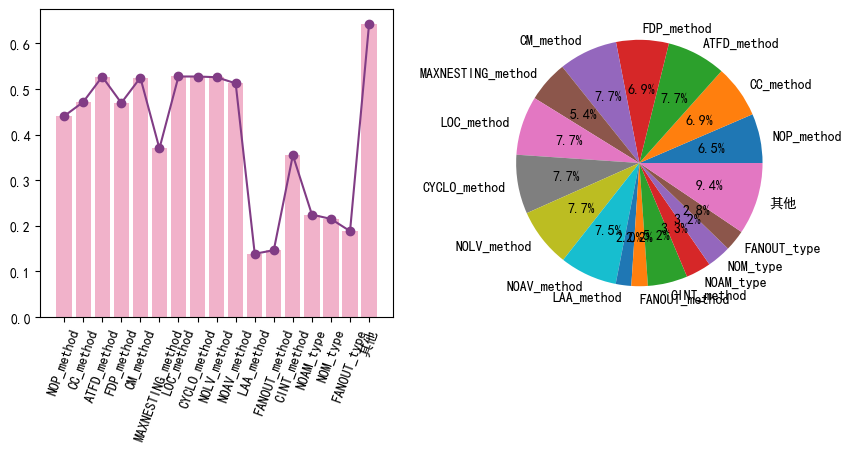

In [549]:
base = df.iloc[:,3:-1]
base_data = base.mean()
base_data = base_data.round().astype(int)
base_data = base_data.values.reshape(1,base_data.shape[0],1)
x = base_data
x = tf.convert_to_tensor(x,dtype=tf.float32)
init_val = model.predict(x)
min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
max_values = visualization(column_names,y_list)
threshold = 2
feature_important(column_names,threshold,max_values)
column_names = df.columns[3:-1].tolist()
LM_L_M_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [565]:
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")
x, y = df.iloc[:, 3:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = LM_L_M_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [566]:
x_train.shape

(15990, 16, 1)

In [567]:
inp=Input(shape=(x_train.shape[1:]))

x = Conv1D(32, 6, padding="same", activation='tanh')(inp)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same', activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same', activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = Flatten()(x)

lstm1=LSTM(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
l=Dropout(0.5)(l)
d = Flatten()(l)

g2=concatenate([x,d],axis=1)
q = Dense(128)(g2)
q = LeakyReLU(alpha=0.33)(q)
q = Dropout(0.5)(q)
output = Dense(2, kernel_regularizer=tf.keras.regularizers.l2(0.01), activation='softmax')(q)
model = Model(inputs=inp,outputs=output)
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=30,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/30
500/500 [==============================] - 9s 14ms/step - loss: 0.3391 - accuracy: 0.8848 - val_loss: 0.2288 - val_accuracy: 0.9167
Epoch 2/30
500/500 [==============================] - 7s 13ms/step - loss: 0.1937 - accuracy: 0.9323 - val_loss: 0.1522 - val_accuracy: 0.9435
Epoch 3/30
500/500 [==============================] - 7s 13ms/step - loss: 0.1589 - accuracy: 0.9458 - val_loss: 0.1359 - val_accuracy: 0.9525
Epoch 4/30
500/500 [==============================] - 7s 13ms/step - loss: 0.1602 - accuracy: 0.9429 - val_loss: 0.1281 - val_accuracy: 0.9557
Epoch 5/30
500/500 [==============================] - 7s 14ms/step - loss: 0.1420 - accuracy: 0.9480 - val_loss: 0.1172 - val_accuracy: 0.9602
Epoch 6/30
500/500 [==============================] - 7s 13ms/step - loss: 0.1346 - accuracy: 0.9530 - val_loss: 0.1107 - val_accuracy: 0.9612
Epoch 7/30
500/500 [==============================] - 7s 13ms/step - loss: 0.1203 - accuracy: 0.9565 - val_loss: 0.1124 - val_accuracy: 0.9620

In [568]:
model.summary()

Model: "model_161"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_162 (InputLayer)          [(None, 16, 1)]      0                                            
__________________________________________________________________________________________________
conv1d_135 (Conv1D)             (None, 16, 32)       224         input_162[0][0]                  
__________________________________________________________________________________________________
dropout_537 (Dropout)           (None, 16, 32)       0           conv1d_135[0][0]                 
__________________________________________________________________________________________________
batch_normalization_69 (BatchNo (None, 16, 32)       128         dropout_537[0][0]                
__________________________________________________________________________________________

In [569]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

125/125 [==============================] - 1s 5ms/step - loss: 0.0837 - accuracy: 0.9765
[0.08368853479623795, 0.9764882326126099]
Running time: 198.2502239000023 Seconds
              precision    recall  f1-score   support

           0    0.98077   0.97192   0.97632      1994
           1    0.97230   0.98104   0.97665      2004

    accuracy                        0.97649      3998
   macro avg    0.97654   0.97648   0.97649      3998
weighted avg    0.97653   0.97649   0.97649      3998



--------CNN+GRU------------

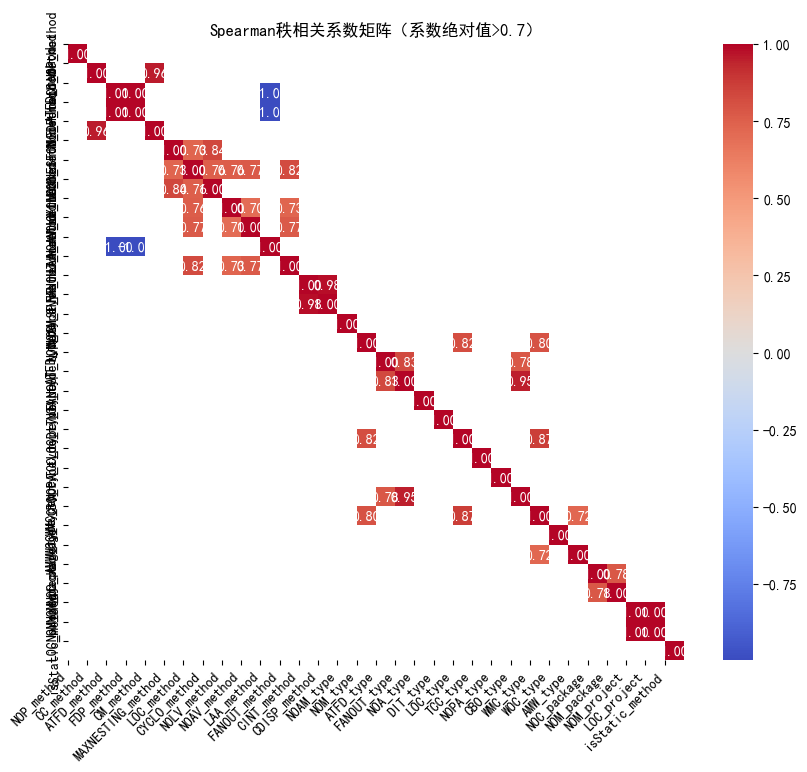

In [575]:
model = load_model('test_model\com_LM_cnn_gru.h5')#加载CNN模型
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")
column_names = df.columns[3:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,3:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['is_long methood']
column_names = df.columns[3:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 195.91210180000053 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_9796\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


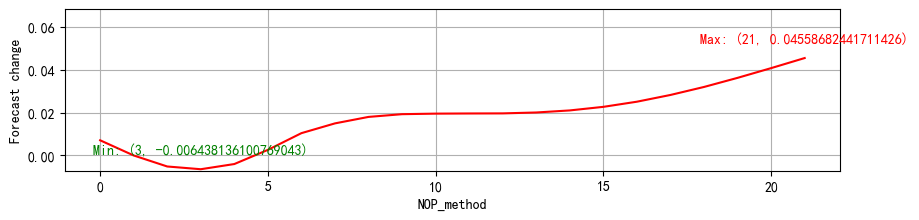

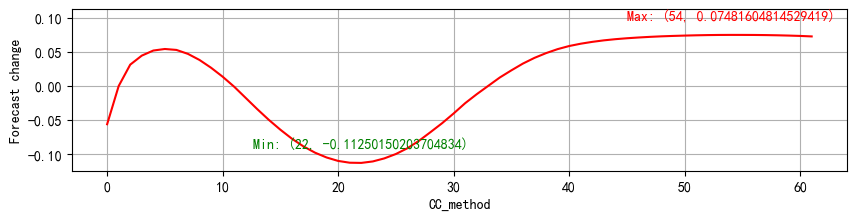

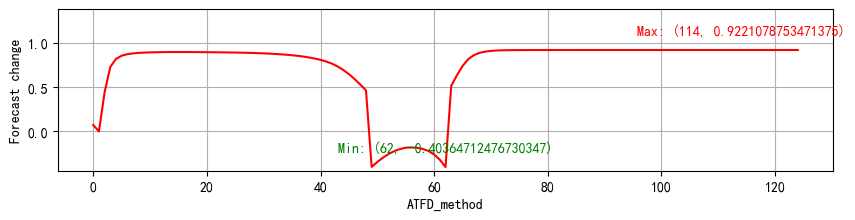

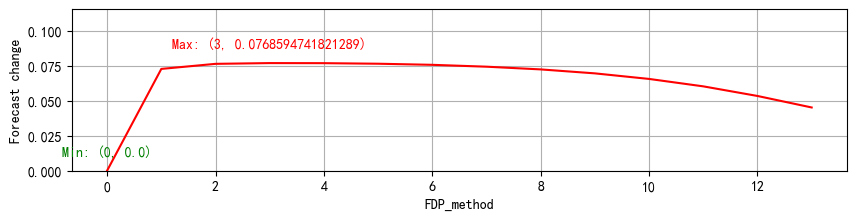

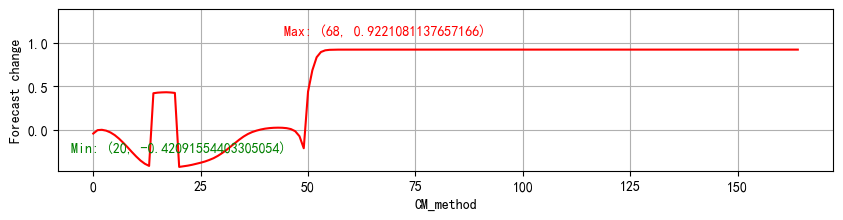

...

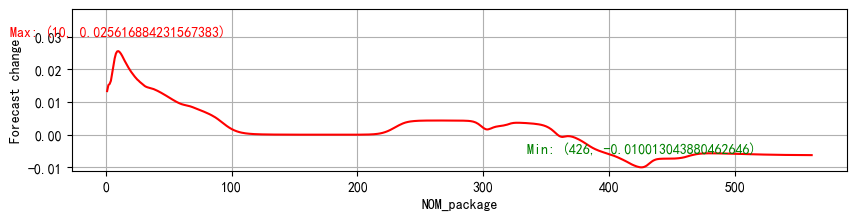

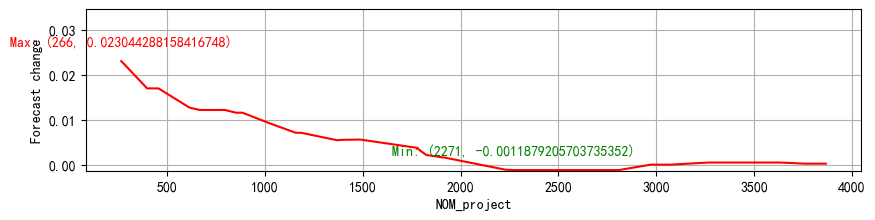

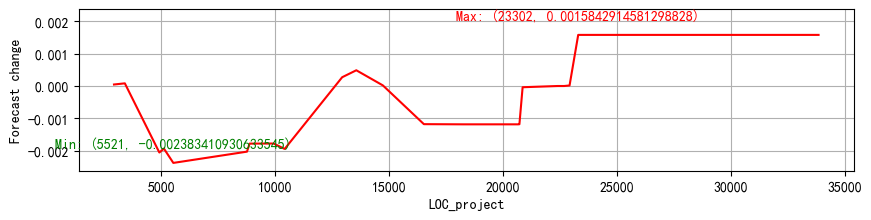

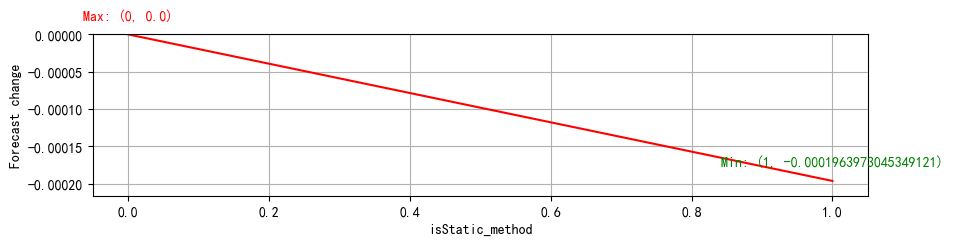

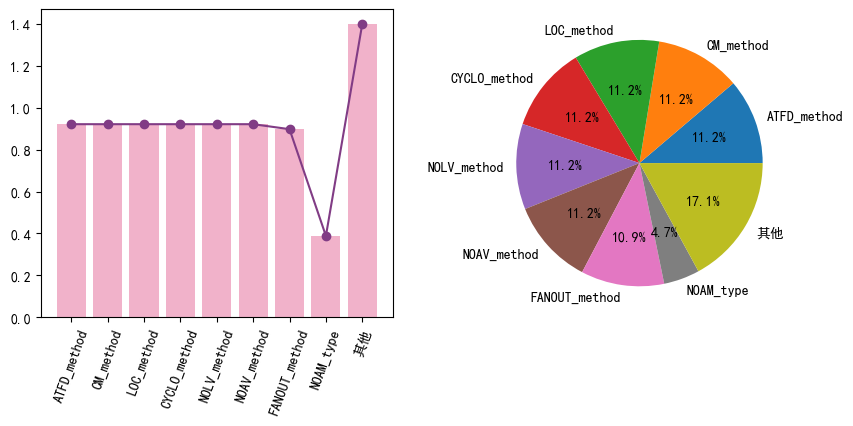

In [576]:
base = df.iloc[:,3:-1]
base_data = base.mean()
base_data = base_data.round().astype(int)
base_data = base_data.values.reshape(1,base_data.shape[0],1)
x = base_data
x = tf.convert_to_tensor(x,dtype=tf.float32)
init_val = model.predict(x)
min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
max_values = visualization(column_names,y_list)
threshold = 2
feature_important(column_names,threshold,max_values)
column_names = df.columns[3:-1].tolist()
LM_C_R_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [577]:
df = pd.read_csv("Dataset\LM.csv",encoding="gbk")
x, y = df.iloc[:, 3:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = LM_C_R_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [578]:
x_train.shape

(15990, 13, 1)

In [579]:
inp=Input(shape=(x_train.shape[1:]))

x = Conv1D(32, 6, padding="same", activation='tanh')(inp)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same', activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same', activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = Flatten()(x)

lstm1=GRU(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
l=Dropout(0.5)(l)
d = Flatten()(l)


g2=concatenate([x,d],axis=1)
q = Dense(128)(g2)
q = LeakyReLU(alpha=0.33)(q)
q = Dropout(0.5)(q)
output = Dense(2, kernel_regularizer=tf.keras.regularizers.l2(0.01), activation='softmax')(q)
model = Model(inputs=inp,outputs=output)
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=30,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/30
500/500 [==============================] - 9s 14ms/step - loss: 0.3664 - accuracy: 0.8771 - val_loss: 0.1879 - val_accuracy: 0.9310
Epoch 2/30
500/500 [==============================] - 6s 13ms/step - loss: 0.1917 - accuracy: 0.9349 - val_loss: 0.1567 - val_accuracy: 0.9385
Epoch 3/30
500/500 [==============================] - 6s 12ms/step - loss: 0.1627 - accuracy: 0.9442 - val_loss: 0.1422 - val_accuracy: 0.9430
Epoch 4/30
500/500 [==============================] - 6s 13ms/step - loss: 0.1594 - accuracy: 0.9434 - val_loss: 0.1321 - val_accuracy: 0.9552
Epoch 5/30
500/500 [==============================] - 6s 12ms/step - loss: 0.1444 - accuracy: 0.9494 - val_loss: 0.1316 - val_accuracy: 0.9565
Epoch 6/30
500/500 [==============================] - 6s 12ms/step - loss: 0.1424 - accuracy: 0.9481 - val_loss: 0.1255 - val_accuracy: 0.9532
Epoch 7/30
500/500 [==============================] - 7s 14ms/step - loss: 0.1295 - accuracy: 0.9527 - val_loss: 0.1234 - val_accuracy: 0.9565

In [560]:
model.summary()

Model: "model_159"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_160 (InputLayer)          [(None, 13, 1)]      0                                            
__________________________________________________________________________________________________
conv1d_129 (Conv1D)             (None, 13, 32)       224         input_160[0][0]                  
__________________________________________________________________________________________________
dropout_523 (Dropout)           (None, 13, 32)       0           conv1d_129[0][0]                 
__________________________________________________________________________________________________
batch_normalization_65 (BatchNo (None, 13, 32)       128         dropout_523[0][0]                
__________________________________________________________________________________________

In [561]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

125/125 [==============================] - 1s 5ms/step - loss: 0.1030 - accuracy: 0.9627
[0.10303826630115509, 0.9627313613891602]
Running time: 189.03566449999926 Seconds
              precision    recall  f1-score   support

           0    0.96194   0.96339   0.96267      1994
           1    0.96352   0.96208   0.96280      2004

    accuracy                        0.96273      3998
   macro avg    0.96273   0.96273   0.96273      3998
weighted avg    0.96273   0.96273   0.96273      3998



# Dry_BEAN

1.------cnn模型----------

In [137]:
%run correlation_analysis.ipynb
%run Data_perturbation.ipynb
%run Feature_selection.ipynb

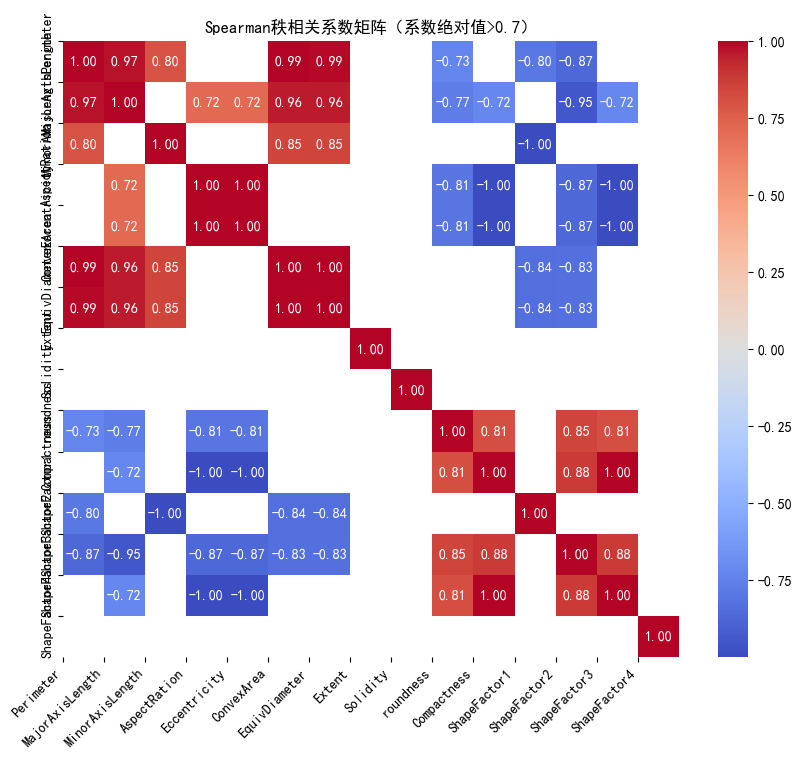

In [138]:
model = load_model('test_model\\test_mul.h5')#加载CNN模型
df = pd.read_csv("Dataset\\test.csv",encoding="gbk")
column_names = df.columns[1:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,1:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['Class']
column_names = df.columns[1:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 110.20173899999645 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_17480\3054686753.py:21: UserWarning: Attempting to set identical bottom == top == [0.] results in singular transformations; automatically expanding.
  plt.ylim(y_list_min[i]*1.1,y_list_max[i]*1.5)


Running time: 109.00215710000339 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_17480\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


Running time: 105.77769439999975 Seconds
Running time: 105.76054360000126 Seconds
Running time: 106.57202200000029 Seconds
Running time: 105.87857029999577 Seconds
Running time: 106.3778325999956 Seconds


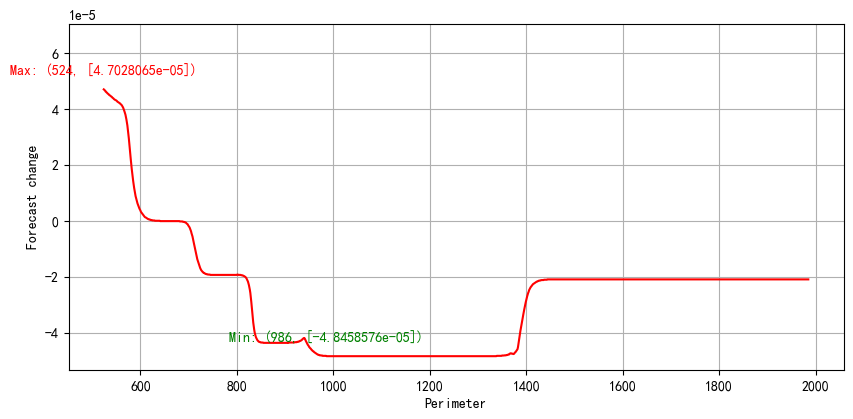

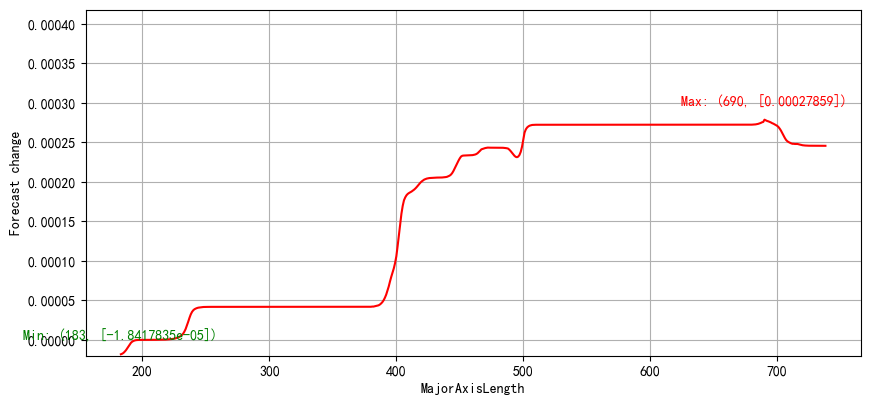

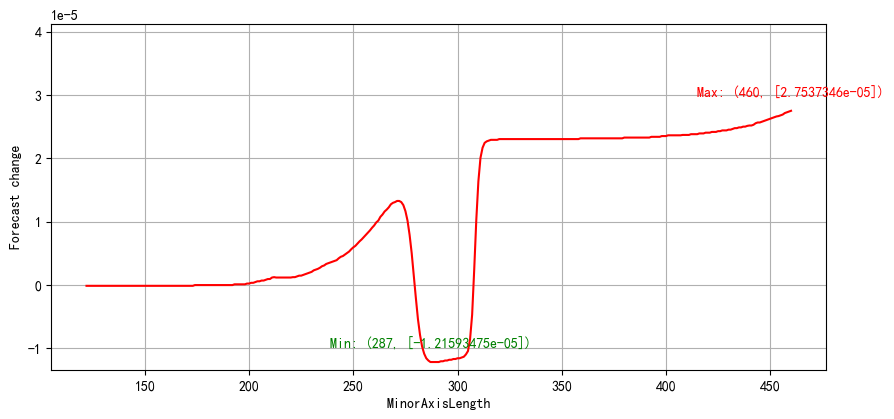

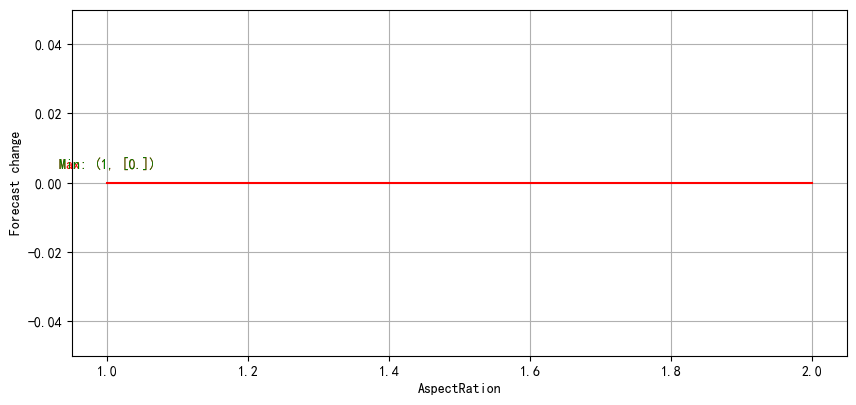

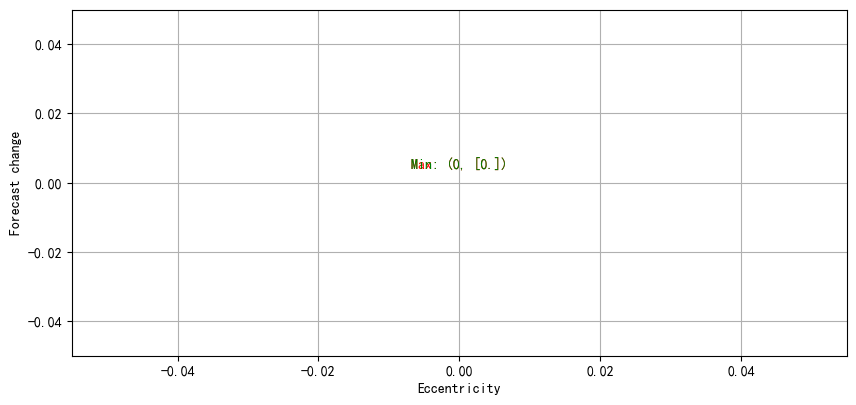

...

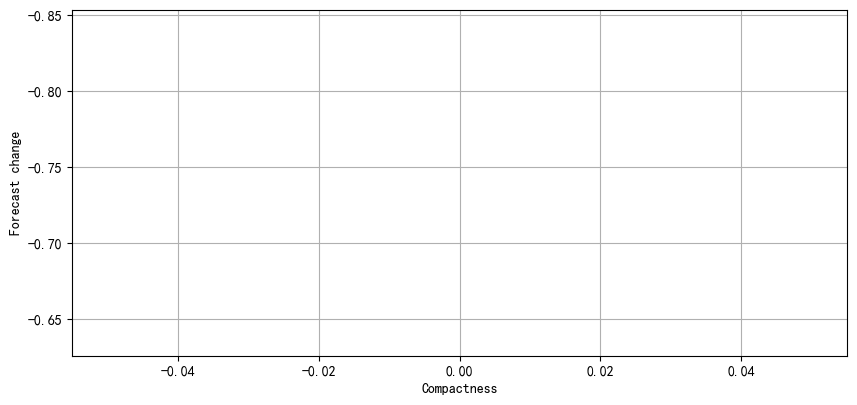

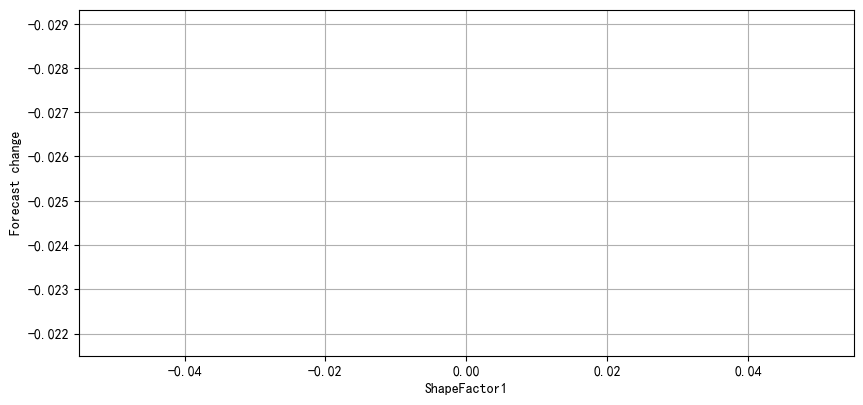

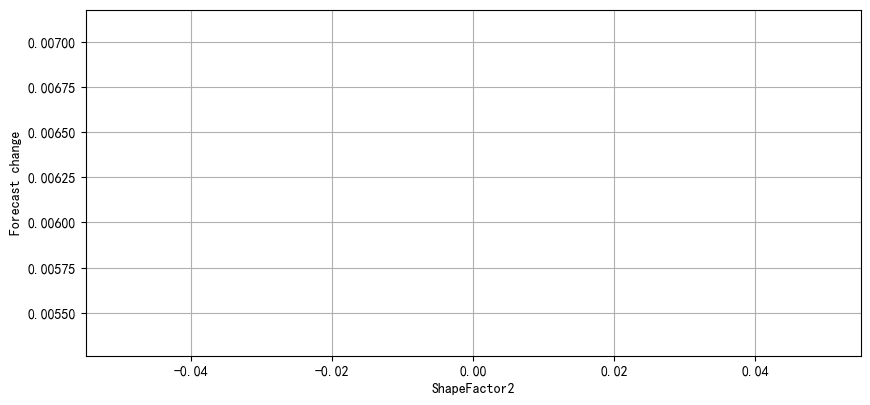

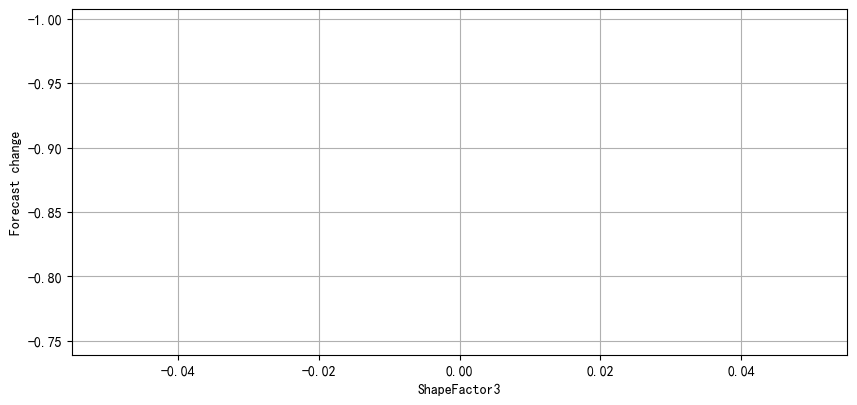

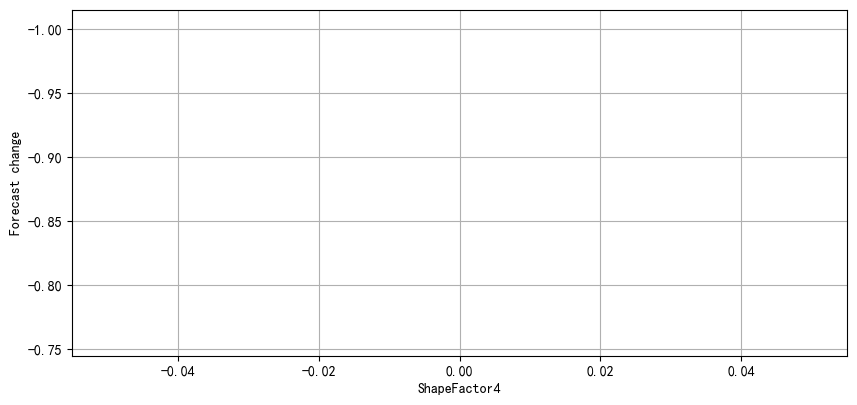

In [139]:
max_values_cnn = []
for test in [8,2301,3780,3907,5820,7721,10241]:
    test_row = test
    x, y = df.iloc[test_row,1:-1], df.iloc[test_row,-1]
    x = x.values.reshape(1,x.shape[0],1)
    x = tf.convert_to_tensor(x,dtype=tf.float32)
    init_val = model.predict(x)
    min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
    x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
    y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
    max_values = visualization(column_names,y_list)
    max_values_cnn.append(max_values)
max_values_list_new = []
for i in max_values_cnn:
    max_values_list_new.append(np.concatenate(i))
max_values = np.maximum.reduce(max_values_list_new)
column_names = df.columns[1:-1].tolist()
F_cnn_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [140]:
df = pd.read_csv("Dataset/test.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_cnn_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))
print(f'训练集的形状为：{x_train.shape}')

训练集的形状为：(19857, 6, 1)


In [141]:
inp=Input(shape=(x_train.shape[1:]))
x = Conv1D(32, 6, padding="same", activation='tanh')(inp)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same', activation='relu')(x)
x = Conv1D(64, 6, strides=1, padding='same', activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same', activation='relu')(x)
x = Conv1D(128, 6, strides=1, padding='same', activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(256, kernel_size=6, strides=1, padding='same', activation='relu')(x)
x = Conv1D(256, 6, strides=1, padding='same', activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Dense(512, activation='relu', kernel_regularizer=regularizers.l2(0.001))(x)
x = Flatten()(x)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01), activation='softmax')(x)
model = Model(inputs=inp,outputs=output)

In [142]:
model.summary()

Model: "model_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_16 (InputLayer)        [(None, 6, 1)]            0         
_________________________________________________________________
conv1d_42 (Conv1D)           (None, 6, 32)             224       
_________________________________________________________________
dropout_47 (Dropout)         (None, 6, 32)             0         
_________________________________________________________________
batch_normalization_27 (Batc (None, 6, 32)             128       
_________________________________________________________________
conv1d_43 (Conv1D)           (None, 6, 64)             12352     
_________________________________________________________________
conv1d_44 (Conv1D)           (None, 6, 64)             24640     
_________________________________________________________________
leaky_re_lu_29 (LeakyReLU)   (None, 6, 64)             0  

In [143]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/40
621/621 [==============================] - 11s 15ms/step - loss: 2.3464 - accuracy: 0.2414 - val_loss: 2.5523 - val_accuracy: 0.2596
Epoch 2/40
621/621 [==============================] - 9s 15ms/step - loss: 1.4952 - accuracy: 0.4965 - val_loss: 1.1458 - val_accuracy: 0.6046
Epoch 3/40
621/621 [==============================] - 9s 15ms/step - loss: 1.1874 - accuracy: 0.5862 - val_loss: 0.9746 - val_accuracy: 0.6669
Epoch 4/40
621/621 [==============================] - 9s 14ms/step - loss: 1.0854 - accuracy: 0.6054 - val_loss: 1.2396 - val_accuracy: 0.4977
Epoch 5/40
621/621 [==============================] - 9s 14ms/step - loss: 1.0204 - accuracy: 0.6225 - val_loss: 0.8756 - val_accuracy: 0.6693
Epoch 6/40
621/621 [==============================] - 9s 14ms/step - loss: 0.9807 - accuracy: 0.6417 - val_loss: 0.8073 - val_accuracy: 0.7053
Epoch 7/40
621/621 [==============================] - 9s 14ms/step - loss: 0.9609 - accuracy: 0.6417 - val_loss: 0.9028 - val_accuracy: 0.660

In [144]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

156/156 [==============================] - 1s 5ms/step - loss: 0.6683 - accuracy: 0.7591
[0.6683116555213928, 0.7591137886047363]
Running time: 361.8983627999987 Seconds
              precision    recall  f1-score   support

           0    0.91286   0.86703   0.88935       737
           1    0.71895   0.83528   0.77276       686
           2    0.64397   0.75596   0.69548       713
           3    0.69048   0.59671   0.64018       729
           4    0.93578   0.86441   0.89868       708
           5    0.93412   0.79913   0.86137       692
           6    0.55364   0.59714   0.57457       700

    accuracy                        0.75911      4965
   macro avg    0.76997   0.75938   0.76177      4965
weighted avg    0.77039   0.75911   0.76187      4965



2.-------lstm模型-------

D:\anaconda3\envs\tensorflow\lib\site-packages\scipy\stats\_stats_py.py:110: RuntimeWarning: The input array could not be properly checked for nan values. nan values will be ignored.
  warnings.warn("The input array could not be properly "


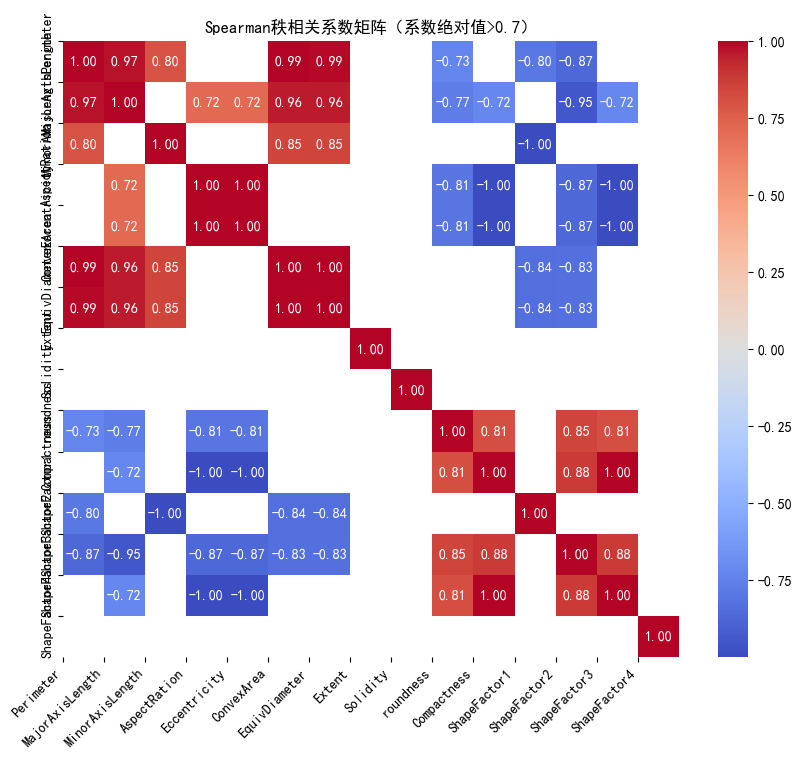

In [145]:
model = load_model('test_model\\test_mul_lstm.h5')#加载CNN模型
df = pd.read_csv("Dataset\\test.csv",encoding="gbk")
column_names = df.columns[1:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,1:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['Class']
column_names = df.columns[1:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 108.28432379999867 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_17480\3054686753.py:21: UserWarning: Attempting to set identical bottom == top == [0.] results in singular transformations; automatically expanding.
  plt.ylim(y_list_min[i]*1.1,y_list_max[i]*1.5)


Running time: 108.76733290000266 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_17480\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


Running time: 108.52649799999926 Seconds
Running time: 108.95152509999753 Seconds
Running time: 108.9461719999963 Seconds
Running time: 108.91972249999526 Seconds
Running time: 108.4493436000048 Seconds


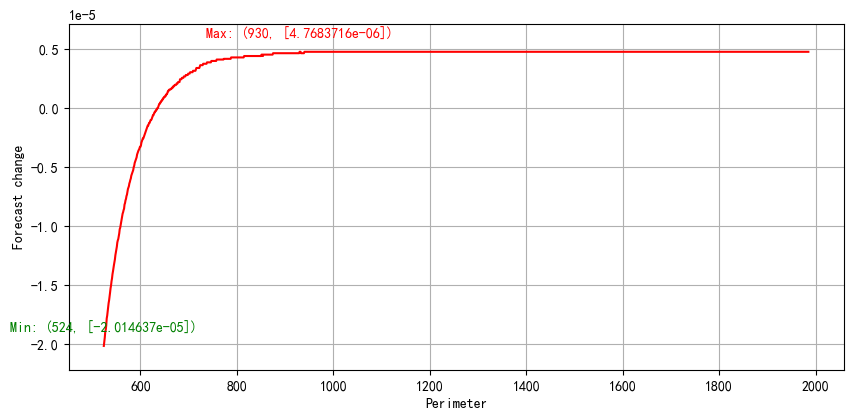

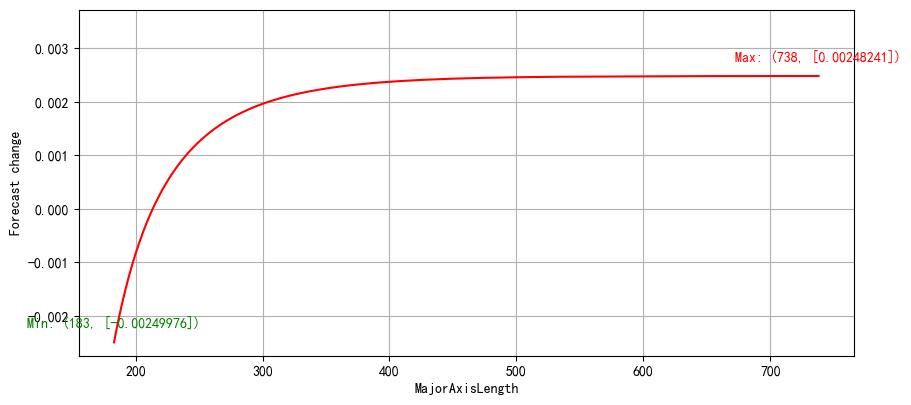

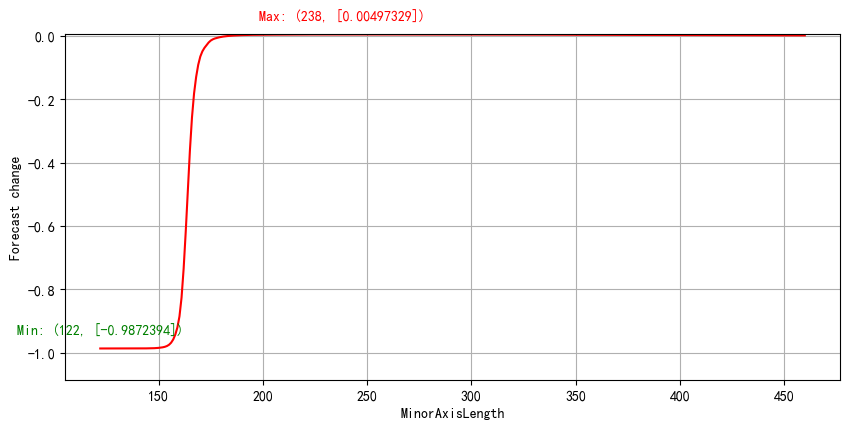

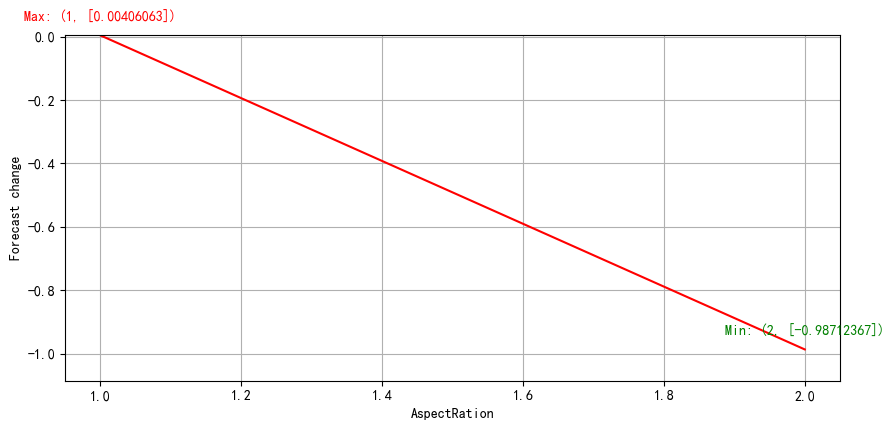

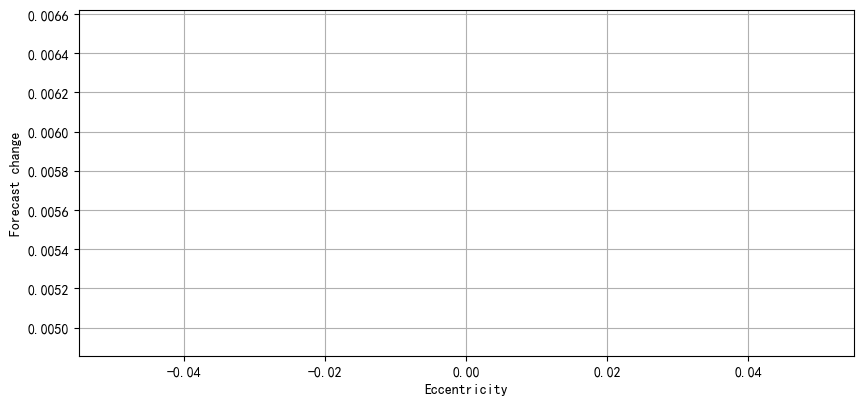

...

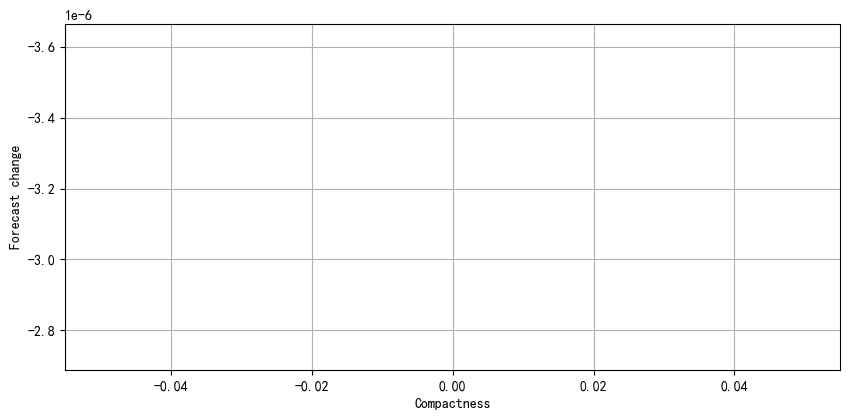

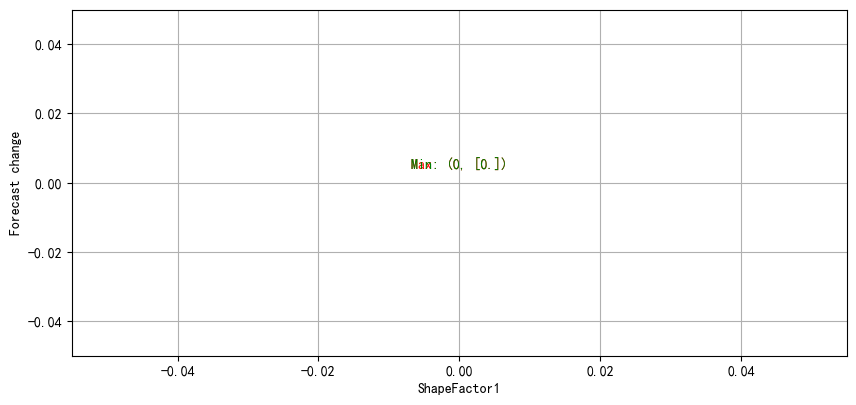

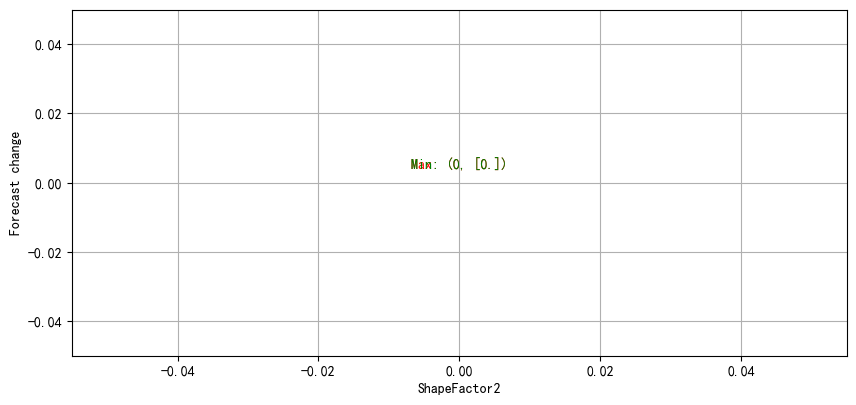

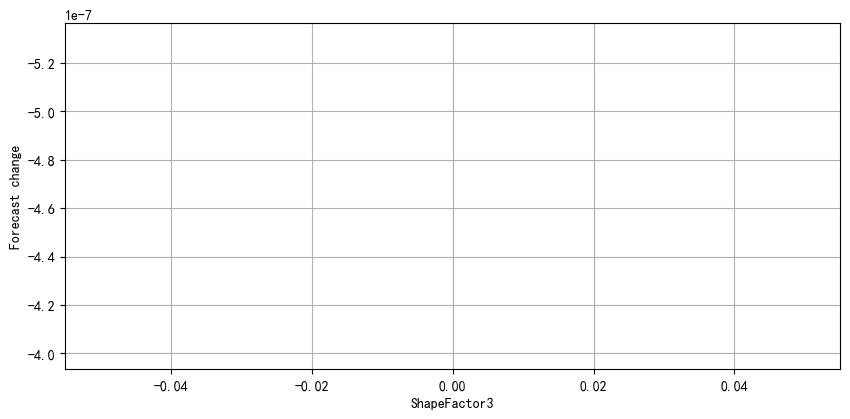

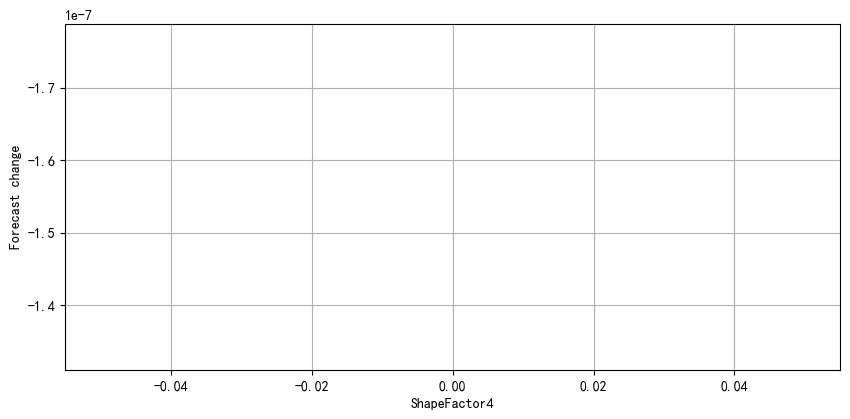

In [146]:
max_values_lstm = []
for test in [8,2301,3780,3907,5820,7721,10241]:
    test_row = test
    x, y = df.iloc[test_row,1:-1], df.iloc[test_row,-1]
    x = x.values.reshape(1,x.shape[0],1)
    x = tf.convert_to_tensor(x,dtype=tf.float32)
    init_val = model.predict(x)
    min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
    x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
    y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
    max_values = visualization(column_names,y_list)
    max_values_lstm.append(max_values)
max_values_list_new = []
for i in max_values_lstm:
    max_values_list_new.append(np.concatenate(i))
max_values = np.maximum.reduce(max_values_list_new)
column_names = df.columns[1:-1].tolist()
F_lstm_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [147]:
df = pd.read_csv("Dataset/test.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_lstm_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))
print(f'训练集的形状为：{x_train.shape}')

训练集的形状为：(19857, 8, 1)


In [148]:
inp=Input(shape=(x_train.shape[1:]))
lstm1=LSTM(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=LSTM(units=64,activation='tanh',return_sequences=True)(l)
l=Dropout(0.5)(l)
l=LSTM(units=128,activation='tanh',return_sequences=True)(l)
l=Dropout(0.5)(l)
d = Flatten()(l)
q = Dense(128)(d)
q = LeakyReLU(alpha=0.33)(q)
q = Dense(256, activation="tanh")(q)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(q)
model = Model(inputs=inp,outputs=output)

In [149]:
model.summary()

Model: "model_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_17 (InputLayer)        [(None, 8, 1)]            0         
_________________________________________________________________
lstm_8 (LSTM)                (None, 8, 32)             4352      
_________________________________________________________________
dropout_51 (Dropout)         (None, 8, 32)             0         
_________________________________________________________________
lstm_9 (LSTM)                (None, 8, 64)             24832     
_________________________________________________________________
dropout_52 (Dropout)         (None, 8, 64)             0         
_________________________________________________________________
lstm_10 (LSTM)               (None, 8, 128)            98816     
_________________________________________________________________
dropout_53 (Dropout)         (None, 8, 128)            0  

In [150]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/40
621/621 [==============================] - 10s 11ms/step - loss: 1.5304 - accuracy: 0.3465 - val_loss: 0.7477 - val_accuracy: 0.6854
Epoch 2/40
621/621 [==============================] - 6s 10ms/step - loss: 0.7080 - accuracy: 0.7112 - val_loss: 0.4247 - val_accuracy: 0.8385
Epoch 3/40
621/621 [==============================] - 6s 10ms/step - loss: 0.4863 - accuracy: 0.8166 - val_loss: 0.4178 - val_accuracy: 0.8338
Epoch 4/40
621/621 [==============================] - 6s 10ms/step - loss: 0.4585 - accuracy: 0.8295 - val_loss: 0.5196 - val_accuracy: 0.8085
Epoch 5/40
621/621 [==============================] - 6s 10ms/step - loss: 0.4387 - accuracy: 0.8405 - val_loss: 0.4201 - val_accuracy: 0.8385
Epoch 6/40
621/621 [==============================] - 6s 10ms/step - loss: 0.4332 - accuracy: 0.8380 - val_loss: 0.3540 - val_accuracy: 0.8659
Epoch 7/40
621/621 [==============================] - 6s 10ms/step - loss: 0.4139 - accuracy: 0.8474 - val_loss: 0.3593 - val_accuracy: 0.861

In [151]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

156/156 [==============================] - 1s 4ms/step - loss: 0.3059 - accuracy: 0.8785
[0.30586323142051697, 0.8785498738288879]
Running time: 260.64623669999855 Seconds
              precision    recall  f1-score   support

           0    0.84565   0.69878   0.76523       737
           1    1.00000   1.00000   1.00000       686
           2    0.73835   0.86676   0.79742       713
           3    0.92966   0.83402   0.87925       729
           4    0.95252   0.93503   0.94369       708
           5    0.93759   0.95520   0.94631       692
           6    0.78562   0.87429   0.82759       700

    accuracy                        0.87855      4965
   macro avg    0.88420   0.88058   0.87993      4965
weighted avg    0.88349   0.87855   0.87851      4965



3.-------gru模型-------

D:\anaconda3\envs\tensorflow\lib\site-packages\scipy\stats\_stats_py.py:110: RuntimeWarning: The input array could not be properly checked for nan values. nan values will be ignored.
  warnings.warn("The input array could not be properly "


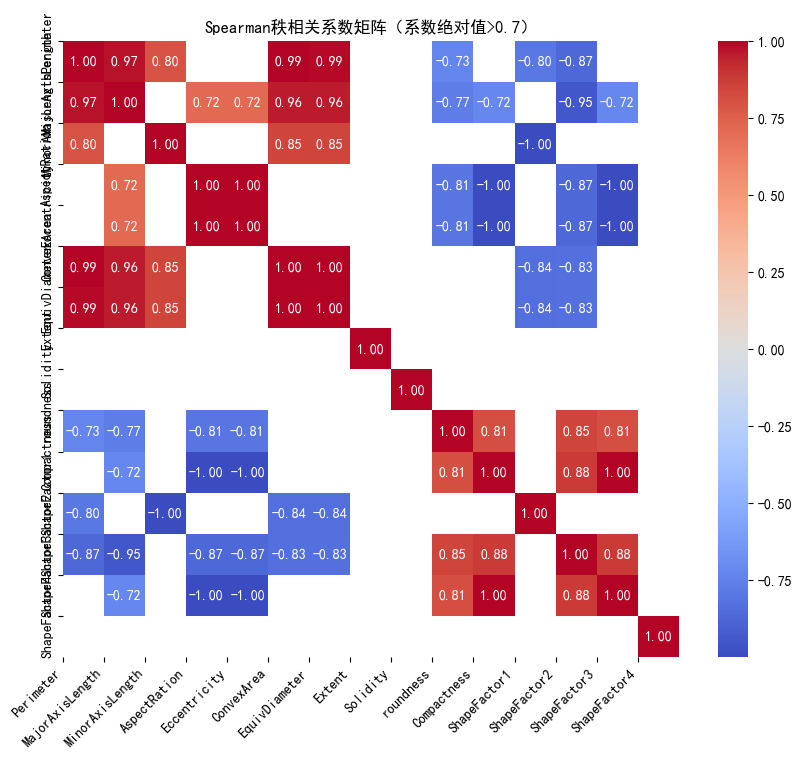

In [152]:
model = load_model('test_model\\test_mul_gru.h5')#加载CNN模型
df = pd.read_csv("Dataset\\test.csv",encoding="gbk")
column_names = df.columns[1:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,1:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['Class']
column_names = df.columns[1:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 108.64337330000126 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_17480\3054686753.py:21: UserWarning: Attempting to set identical bottom == top == [0.] results in singular transformations; automatically expanding.
  plt.ylim(y_list_min[i]*1.1,y_list_max[i]*1.5)


Running time: 108.69567800000368 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_17480\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


Running time: 108.39778620000288 Seconds
Running time: 108.3455199999953 Seconds
Running time: 108.05113010000059 Seconds
Running time: 107.85918169999786 Seconds
Running time: 108.19110979999823 Seconds


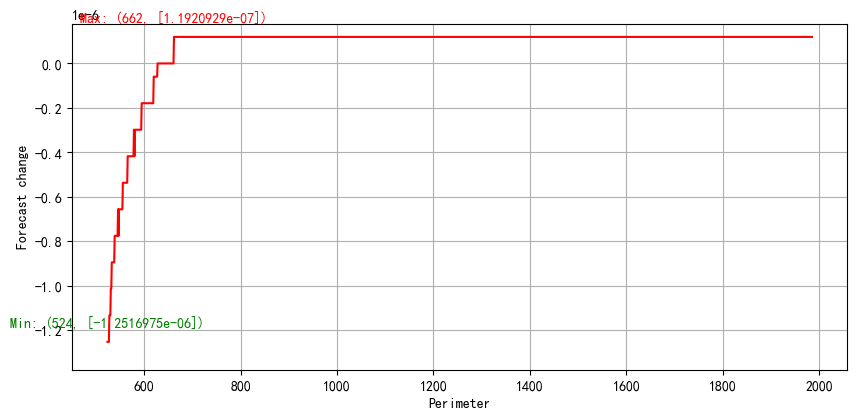

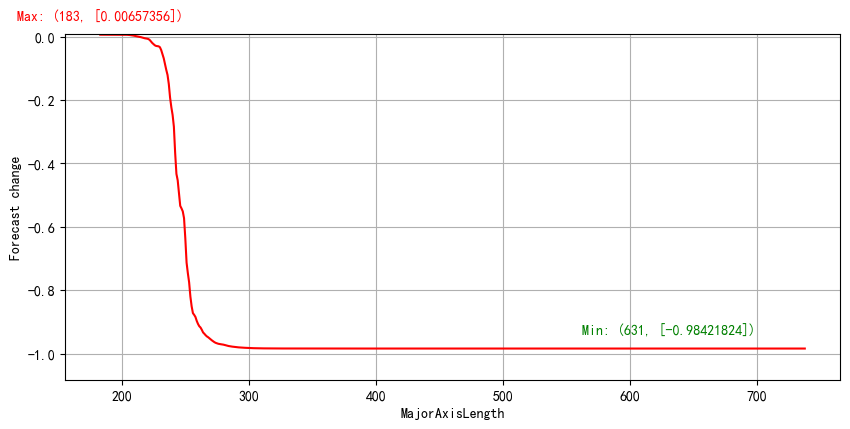

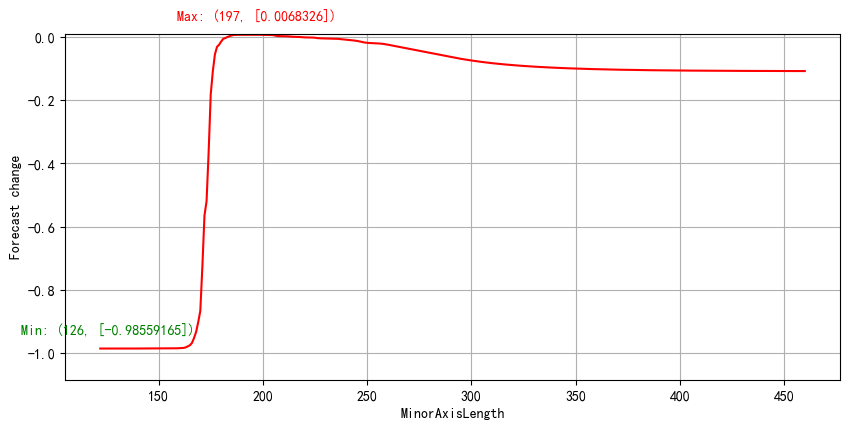

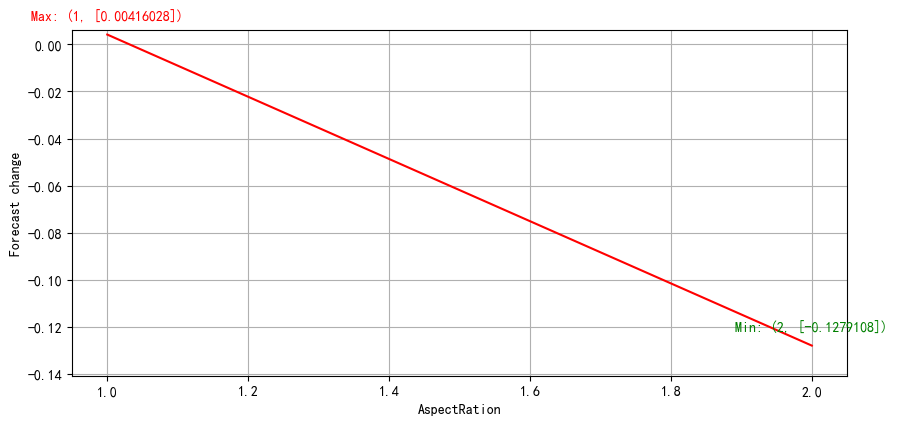

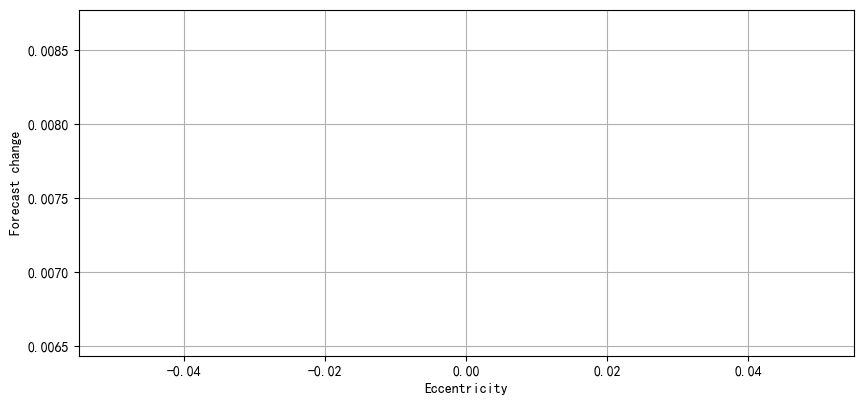

...

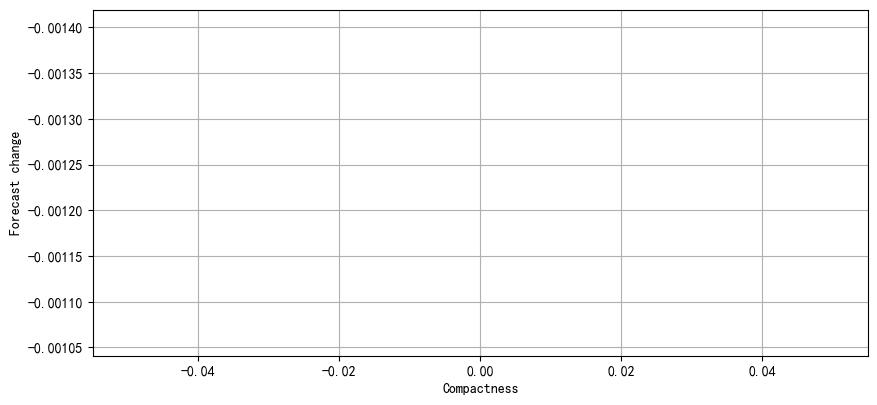

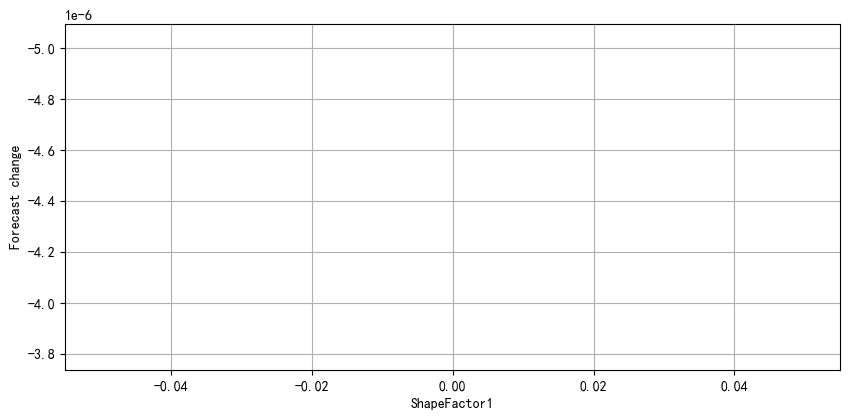

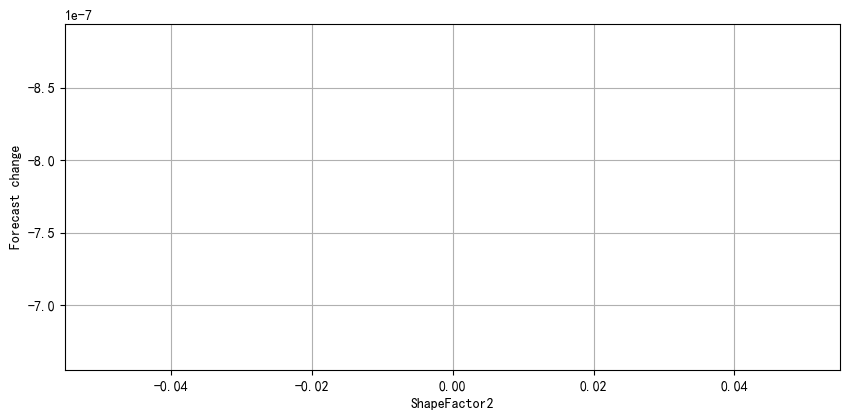

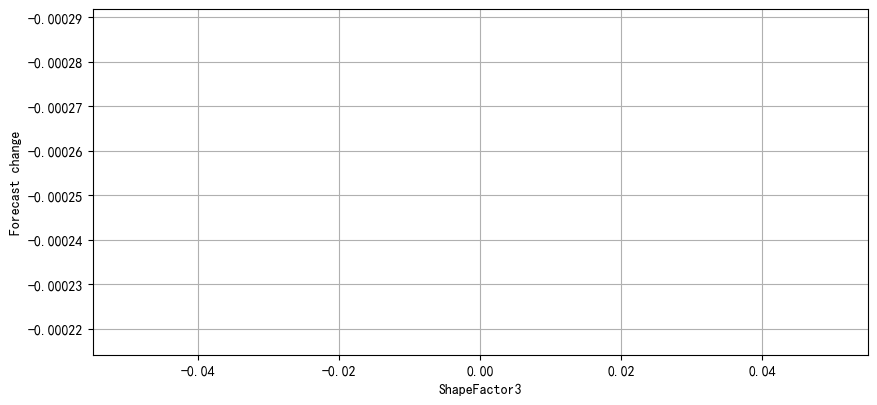

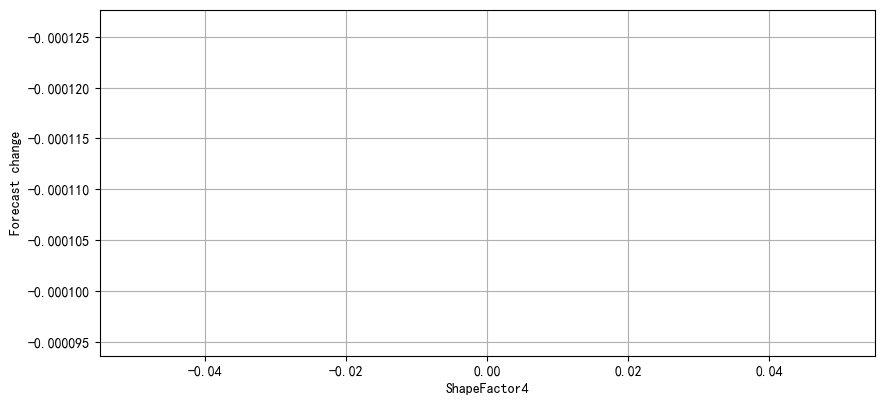

In [153]:
max_values_gru = []
for test in [8,2301,3780,3907,5820,7721,10241]:
    test_row = test
    x, y = df.iloc[test_row,1:-1], df.iloc[test_row,-1]
    x = x.values.reshape(1,x.shape[0],1)
    x = tf.convert_to_tensor(x,dtype=tf.float32)
    init_val = model.predict(x)
    min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
    x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
    y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
    max_values = visualization(column_names,y_list)
    max_values_gru.append(max_values)
max_values_list_new = []
for i in max_values_gru:
    max_values_list_new.append(np.concatenate(i))
max_values = np.maximum.reduce(max_values_list_new)
column_names = df.columns[1:-1].tolist()
F_gru_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [154]:
df = pd.read_csv("Dataset/test.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_gru_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))
print(f'训练集的形状为：{x_train.shape}')

训练集的形状为：(19857, 7, 1)


In [155]:
inp=Input(shape=(x_train.shape[1:]))
lstm1=GRU(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=GRU(units=64,activation='tanh',return_sequences=True)(l)
l=Dropout(0.5)(l)
l=GRU(units=128,activation='tanh',return_sequences=True)(l)
l=Dropout(0.5)(l)
d = Flatten()(l)
q = Dense(128)(d)
q = LeakyReLU(alpha=0.33)(q)
q = Dense(256, activation="tanh")(q)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(q)
model = Model(inputs=inp,outputs=output)

In [156]:
model.summary()

Model: "model_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_18 (InputLayer)        [(None, 7, 1)]            0         
_________________________________________________________________
gru_6 (GRU)                  (None, 7, 32)             3360      
_________________________________________________________________
dropout_54 (Dropout)         (None, 7, 32)             0         
_________________________________________________________________
gru_7 (GRU)                  (None, 7, 64)             18816     
_________________________________________________________________
dropout_55 (Dropout)         (None, 7, 64)             0         
_________________________________________________________________
gru_8 (GRU)                  (None, 7, 128)            74496     
_________________________________________________________________
dropout_56 (Dropout)         (None, 7, 128)            0  

In [157]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/40
621/621 [==============================] - 9s 11ms/step - loss: 1.5797 - accuracy: 0.3621 - val_loss: 0.4076 - val_accuracy: 0.8620
Epoch 2/40
621/621 [==============================] - 6s 10ms/step - loss: 0.5456 - accuracy: 0.7995 - val_loss: 0.3780 - val_accuracy: 0.8679
Epoch 3/40
621/621 [==============================] - 6s 10ms/step - loss: 0.4951 - accuracy: 0.8123 - val_loss: 0.4272 - val_accuracy: 0.8429
Epoch 4/40
621/621 [==============================] - 6s 10ms/step - loss: 0.4837 - accuracy: 0.8203 - val_loss: 0.3978 - val_accuracy: 0.8431
Epoch 5/40
621/621 [==============================] - 6s 10ms/step - loss: 0.4806 - accuracy: 0.8224 - val_loss: 0.3608 - val_accuracy: 0.8691
Epoch 6/40
621/621 [==============================] - 6s 10ms/step - loss: 0.4478 - accuracy: 0.8329 - val_loss: 0.3510 - val_accuracy: 0.8691
Epoch 7/40
621/621 [==============================] - 6s 10ms/step - loss: 0.4305 - accuracy: 0.8413 - val_loss: 0.3681 - val_accuracy: 0.8657

In [158]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

156/156 [==============================] - 1s 4ms/step - loss: 0.3080 - accuracy: 0.8794
[0.3080224394798279, 0.8793554902076721]
Running time: 243.8877449000065 Seconds
              precision    recall  f1-score   support

           0    0.85227   0.71235   0.77605       737
           1    0.99709   1.00000   0.99854       686
           2    0.73784   0.87237   0.79949       713
           3    0.93509   0.82990   0.87936       729
           4    0.95224   0.92938   0.94067       708
           5    0.93099   0.95520   0.94294       692
           6    0.79091   0.87000   0.82857       700

    accuracy                        0.87936      4965
   macro avg    0.88520   0.88131   0.88080      4965
weighted avg    0.88458   0.87936   0.87947      4965



4.------CNN+lstm模型----

D:\anaconda3\envs\tensorflow\lib\site-packages\scipy\stats\_stats_py.py:110: RuntimeWarning: The input array could not be properly checked for nan values. nan values will be ignored.
  warnings.warn("The input array could not be properly "


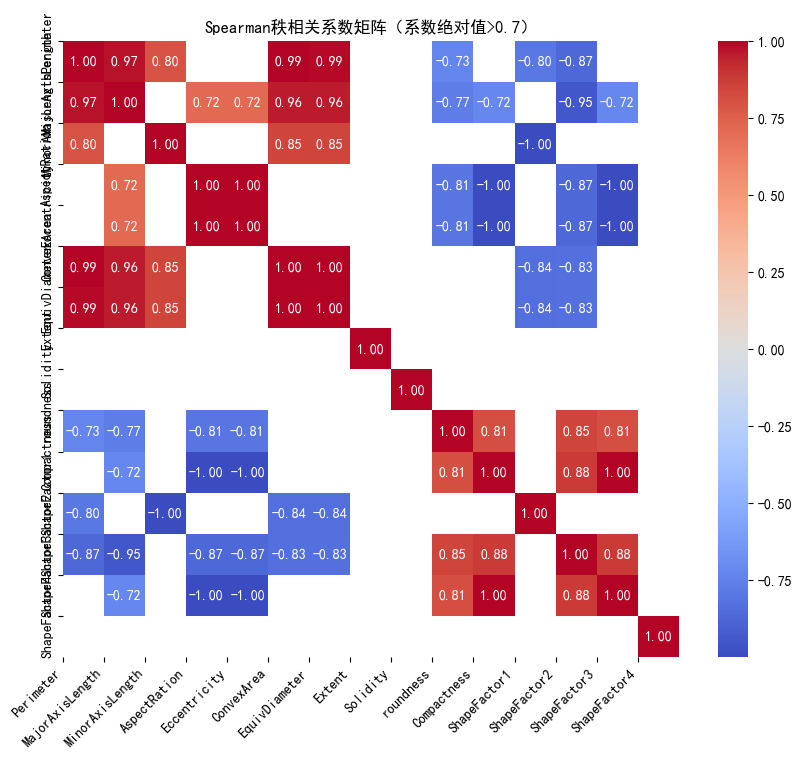

In [159]:
model = load_model('test_model\\test_mul_cnn_lstm.h5')#加载CNN模型
df = pd.read_csv("Dataset\\test.csv",encoding="gbk")
column_names = df.columns[1:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,1:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['Class']
column_names = df.columns[1:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

Running time: 115.80137100000138 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_17480\3054686753.py:21: UserWarning: Attempting to set identical bottom == top == [0.] results in singular transformations; automatically expanding.
  plt.ylim(y_list_min[i]*1.1,y_list_max[i]*1.5)


Running time: 115.61946619999799 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_17480\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


Running time: 115.52575919999799 Seconds
Running time: 115.08741670000018 Seconds
Running time: 115.50238340000215 Seconds
Running time: 115.23138940000354 Seconds
Running time: 115.29805230000056 Seconds


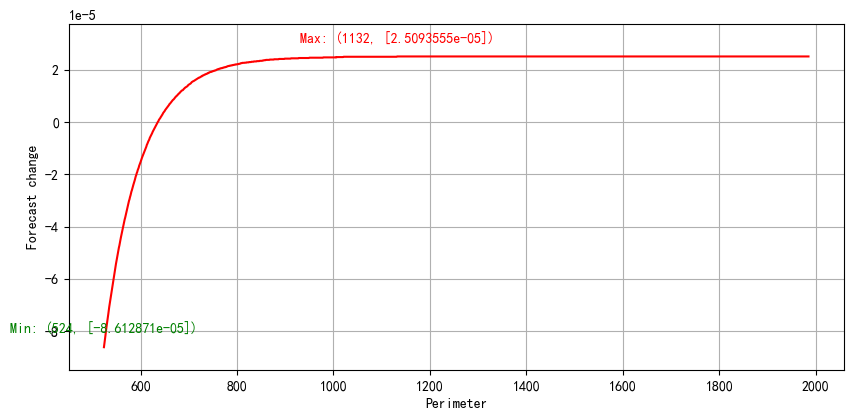

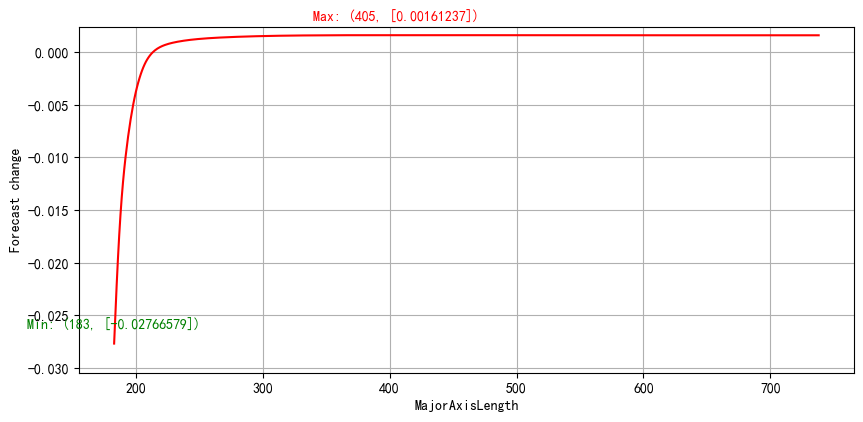

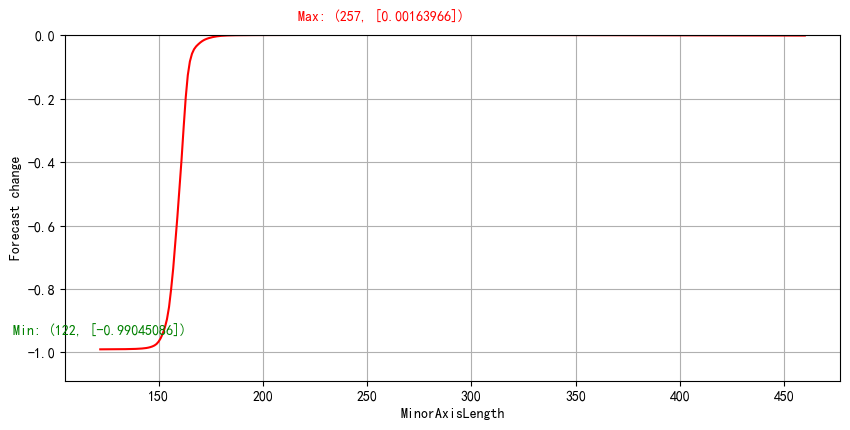

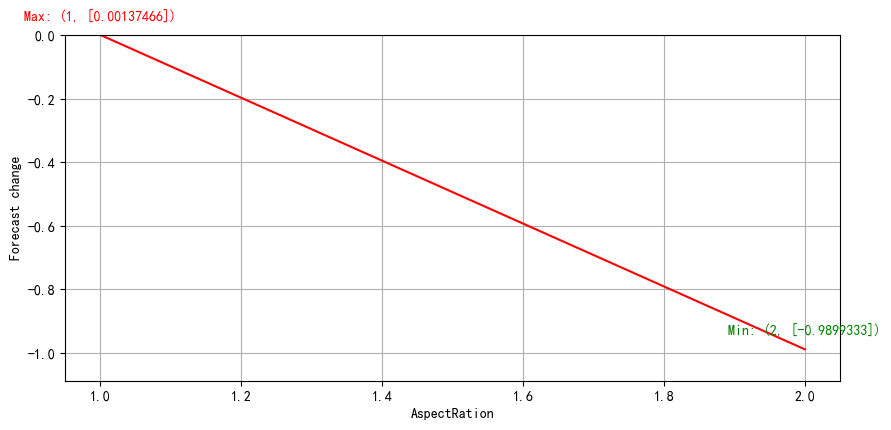

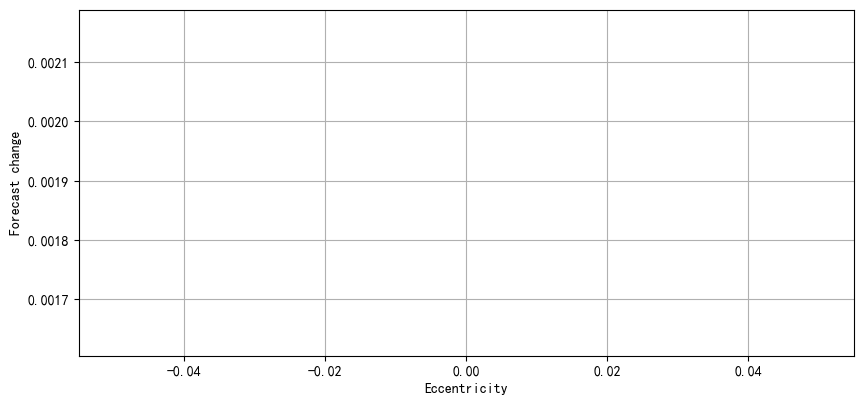

...

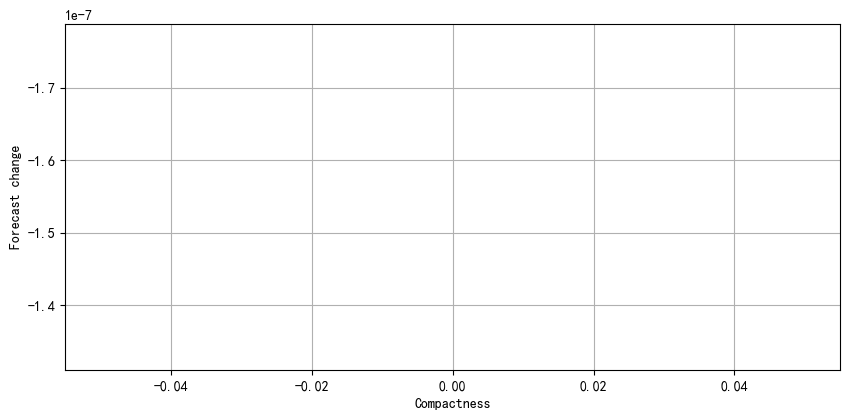

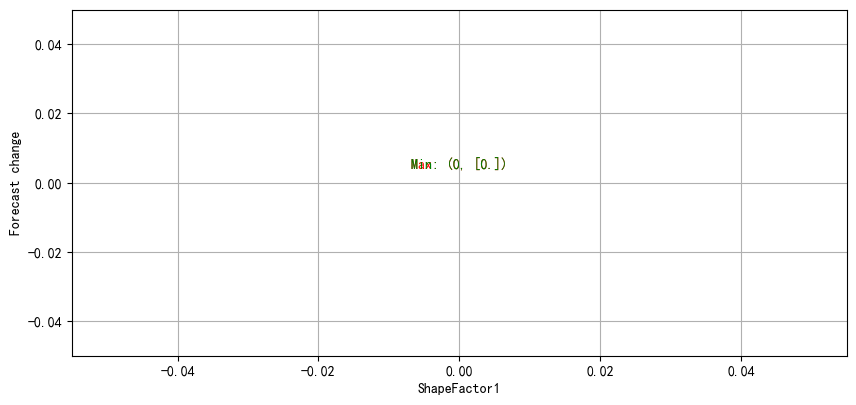

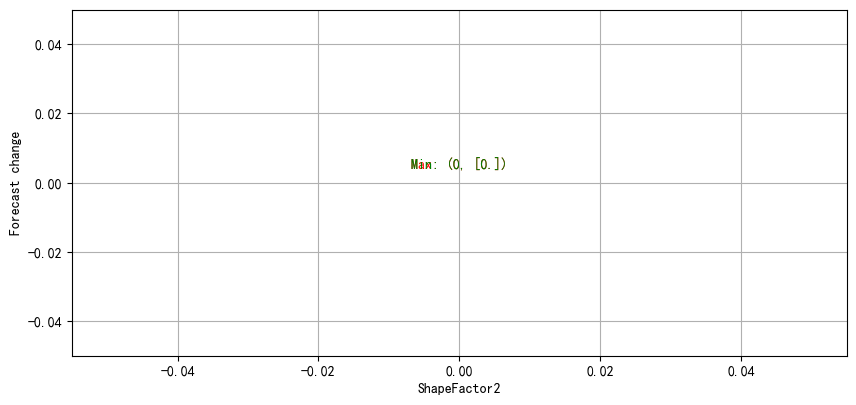

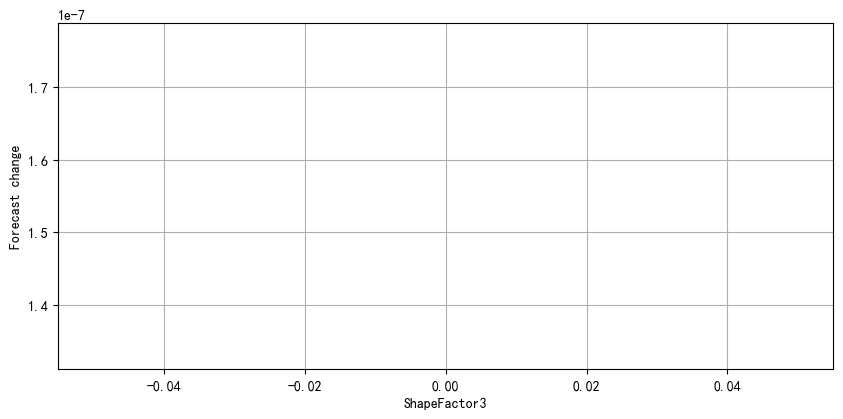

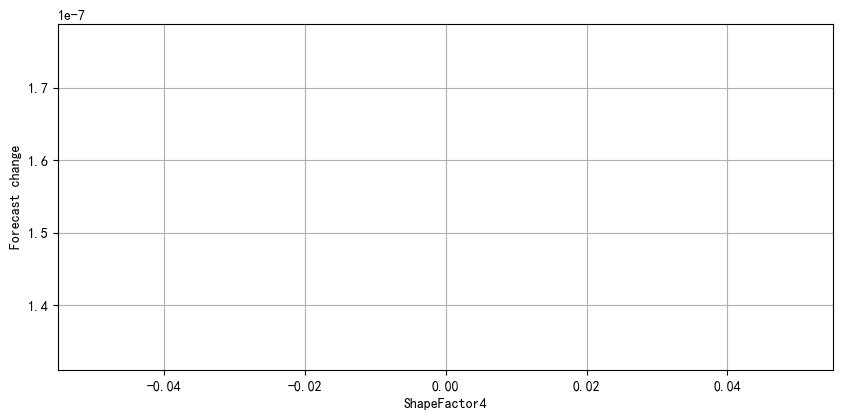

In [160]:
max_values_cnn_lstm = []
for test in [8,2301,3780,3907,5820,7721,10241]:
    test_row = test
    x, y = df.iloc[test_row,1:-1], df.iloc[test_row,-1]
    x = x.values.reshape(1,x.shape[0],1)
    x = tf.convert_to_tensor(x,dtype=tf.float32)
    init_val = model.predict(x)
    min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
    x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
    y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
    max_values = visualization(column_names,y_list)
    max_values_cnn_lstm.append(max_values)
max_values_list_new = []
for i in max_values_cnn_lstm:
    max_values_list_new.append(np.concatenate(i))
max_values = np.maximum.reduce(max_values_list_new)
column_names = df.columns[1:-1].tolist()
F_cnn_lstm_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [161]:
df = pd.read_csv("Dataset/test.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_cnn_lstm_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))
print(f'训练集的形状为：{x_train.shape}')

训练集的形状为：(19857, 8, 1)


In [162]:
inp=Input(shape=(x_train.shape[1:]))

x = Conv1D(32, 6, padding = "same", activation='tanh')(inp)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(64, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(128, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(256, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(256, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = Dense(64,activation='relu',kernel_regularizer=regularizers.l2(0.001))(x)
g = Flatten()(x)

lstm1=LSTM(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=LSTM(units=64,activation='tanh',return_sequences=True)(l)
l=Dropout(0.5)(l)
l=LSTM(units=128,activation='tanh',return_sequences=True)(l)
l=Dropout(0.5)(l)
d = Flatten()(l)

g2=concatenate([g,d],axis=1)
q = Dense(128)(g2)
q = LeakyReLU(alpha=0.33)(q)
q = Dense(256, activation="tanh")(q)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(q)
model = Model(inputs=inp,outputs=output)

In [163]:
model.summary()

Model: "model_18"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_19 (InputLayer)           [(None, 8, 1)]       0                                            
__________________________________________________________________________________________________
conv1d_49 (Conv1D)              (None, 8, 32)        224         input_19[0][0]                   
__________________________________________________________________________________________________
batch_normalization_31 (BatchNo (None, 8, 32)        128         conv1d_49[0][0]                  
__________________________________________________________________________________________________
conv1d_50 (Conv1D)              (None, 8, 64)        12352       batch_normalization_31[0][0]     
___________________________________________________________________________________________

In [164]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
#               loss ='squared_hinge',
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )

In [165]:
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()
print('Running time: %s Seconds'%(end-start))

Epoch 1/40
621/621 [==============================] - 18s 23ms/step - loss: 1.3419 - accuracy: 0.5206 - val_loss: 0.5270 - val_accuracy: 0.8211
Epoch 2/40
621/621 [==============================] - 13s 21ms/step - loss: 0.5677 - accuracy: 0.8085 - val_loss: 0.4586 - val_accuracy: 0.8379
Epoch 3/40
621/621 [==============================] - 13s 21ms/step - loss: 0.4921 - accuracy: 0.8263 - val_loss: 0.4423 - val_accuracy: 0.8403
Epoch 4/40
621/621 [==============================] - 13s 21ms/step - loss: 0.4584 - accuracy: 0.8324 - val_loss: 0.4560 - val_accuracy: 0.8316
Epoch 5/40
621/621 [==============================] - 13s 21ms/step - loss: 0.4537 - accuracy: 0.8358 - val_loss: 0.4547 - val_accuracy: 0.8258
Epoch 6/40
621/621 [==============================] - 13s 21ms/step - loss: 0.4347 - accuracy: 0.8415 - val_loss: 0.7565 - val_accuracy: 0.7315
Epoch 7/40
621/621 [==============================] - 13s 21ms/step - loss: 0.3998 - accuracy: 0.8521 - val_loss: 0.3461 - val_accuracy:

In [166]:
print(model.evaluate(x_test,y_test))
from sklearn.metrics import classification_report
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

156/156 [==============================] - 1s 7ms/step - loss: 0.2152 - accuracy: 0.9269
[0.21515409648418427, 0.9268882274627686]
              precision    recall  f1-score   support

           0    0.95238   0.86839   0.90845       737
           1    1.00000   1.00000   1.00000       686
           2    0.88089   0.94390   0.91131       713
           3    0.90135   0.91495   0.90810       729
           4    0.96921   0.93362   0.95108       708
           5    0.95369   0.95231   0.95300       692
           6    0.84384   0.88000   0.86154       700

    accuracy                        0.92689      4965
   macro avg    0.92877   0.92759   0.92764      4965
weighted avg    0.92848   0.92689   0.92713      4965



5.------CNN+GRU模型----------

In [174]:
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow import keras
from keras import regularizers
from keras.layers import Dense,Flatten,Conv1D,MaxPooling1D,Dropout,BatchNormalization
from tensorflow.keras import Sequential
from tensorflow.keras import Model
from tensorflow.keras import layers
from sklearn.preprocessing import OneHotEncoder
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
from imblearn.over_sampling import SMOTE

In [175]:
df = pd.read_csv("Dataset/test.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))

In [176]:
inp=Input(shape=(x_train.shape[1:]))

x = Conv1D(32, 6, padding = "same", activation='tanh')(inp)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(64, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(128, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(256, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(256, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = Dense(64,activation='relu',kernel_regularizer=regularizers.l2(0.001))(x)
g = Flatten()(x)

lstm1=GRU(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=GRU(units=64,activation='tanh',return_sequences=True)(l)
l=Dropout(0.5)(l)
l=GRU(units=128,activation='tanh',return_sequences=True)(l)
l=Dropout(0.5)(l)
d = Flatten()(l)

g2=concatenate([g,d],axis=1)
q = Dense(128)(g2)
q = LeakyReLU(alpha=0.33)(q)
q = Dense(256, activation="tanh")(q)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(q)
model = Model(inputs=inp,outputs=output)

In [177]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
#               loss ='squared_hinge',
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )

In [178]:
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()
print('Running time: %s Seconds'%(end-start))

Epoch 1/40
621/621 [==============================] - 19s 25ms/step - loss: 1.5729 - accuracy: 0.3811 - val_loss: 0.4941 - val_accuracy: 0.8254
Epoch 2/40
621/621 [==============================] - 14s 22ms/step - loss: 0.5849 - accuracy: 0.7822 - val_loss: 0.4402 - val_accuracy: 0.8133
Epoch 3/40
621/621 [==============================] - 14s 22ms/step - loss: 0.5077 - accuracy: 0.8107 - val_loss: 0.5111 - val_accuracy: 0.8077
Epoch 4/40
621/621 [==============================] - 14s 23ms/step - loss: 0.4182 - accuracy: 0.8547 - val_loss: 0.3989 - val_accuracy: 0.8665
Epoch 5/40
621/621 [==============================] - 14s 22ms/step - loss: 0.4011 - accuracy: 0.8603 - val_loss: 0.3883 - val_accuracy: 0.8630
Epoch 6/40
621/621 [==============================] - 14s 23ms/step - loss: 0.3983 - accuracy: 0.8580 - val_loss: 0.3474 - val_accuracy: 0.8761
Epoch 7/40
621/621 [==============================] - 14s 23ms/step - loss: 0.3733 - accuracy: 0.8713 - val_loss: 0.3260 - val_accuracy:

In [179]:
print(model.evaluate(x_test,y_test))
from sklearn.metrics import classification_report
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))
model.save('test_model\\test_mul_cnn_gru.h5')

156/156 [==============================] - 1s 9ms/step - loss: 0.2476 - accuracy: 0.9148
[0.247559055685997, 0.9148036241531372]
              precision    recall  f1-score   support

           0    0.89502   0.90231   0.89865       737
           1    0.99709   1.00000   0.99854       686
           2    0.90525   0.87097   0.88778       713
           3    0.91040   0.86420   0.88670       729
           4    0.94545   0.95480   0.95011       708
           5    0.93662   0.96098   0.94864       692
           6    0.81943   0.85571   0.83718       700

    accuracy                        0.91480      4965
   macro avg    0.91561   0.91557   0.91537      4965
weighted avg    0.91518   0.91480   0.91477      4965



D:\anaconda3\envs\tensorflow\lib\site-packages\scipy\stats\_stats_py.py:110: RuntimeWarning: The input array could not be properly checked for nan values. nan values will be ignored.
  warnings.warn("The input array could not be properly "


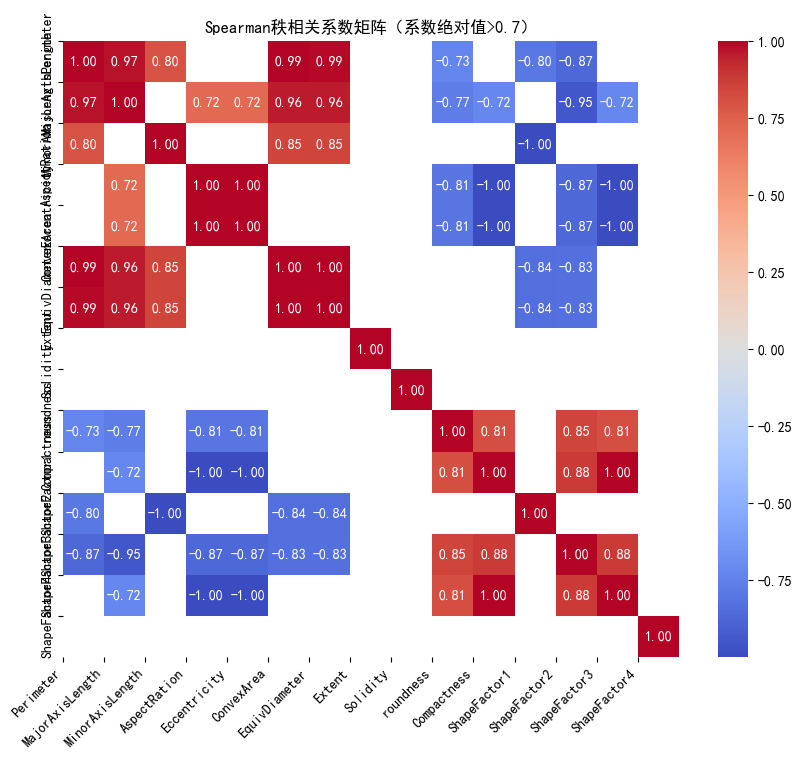

In [180]:
model = load_model('test_model\\test_mul_cnn_gru.h5')#加载CNN模型
df = pd.read_csv("Dataset\\test.csv",encoding="gbk")
column_names = df.columns[1:-1].tolist()
feature_dict = {}
spearmanr_data = df.iloc[:,1:-1]
feature_dict = set_feature_dict(column_names,feature_dict)
rela_class,feature_dict,feature_correlation_list = Feature_correlation_analysis(column_names,feature_dict,spearmanr_data)
target_variable = df['Class']
column_names = df.columns[1:-1]
feature_dict,target_variable_list = target_correlation_analysis(feature_dict,target_variable,column_names)

In [181]:
model.summary()

Model: "model_19"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_20 (InputLayer)           [(None, 15, 1)]      0                                            
__________________________________________________________________________________________________
conv1d_56 (Conv1D)              (None, 15, 32)       224         input_20[0][0]                   
__________________________________________________________________________________________________
batch_normalization_34 (BatchNo (None, 15, 32)       128         conv1d_56[0][0]                  
__________________________________________________________________________________________________
conv1d_57 (Conv1D)              (None, 15, 64)       12352       batch_normalization_34[0][0]     
___________________________________________________________________________________________

Running time: 115.19288800000504 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_17480\3054686753.py:21: UserWarning: Attempting to set identical bottom == top == [0.] results in singular transformations; automatically expanding.
  plt.ylim(y_list_min[i]*1.1,y_list_max[i]*1.5)


Running time: 114.83926569999312 Seconds


C:\Users\liang\AppData\Local\Temp\ipykernel_17480\3054686753.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10,80))


Running time: 115.16186249999737 Seconds
Running time: 115.16714960000536 Seconds
Running time: 115.49839310000243 Seconds
Running time: 115.52070729999105 Seconds
Running time: 114.90787409999757 Seconds


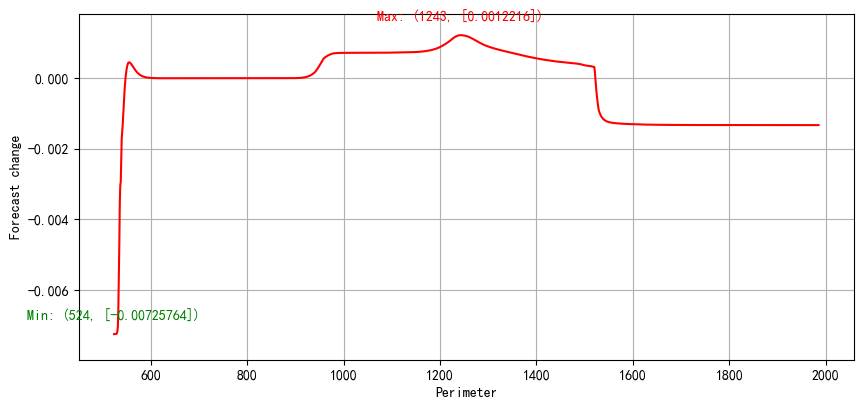

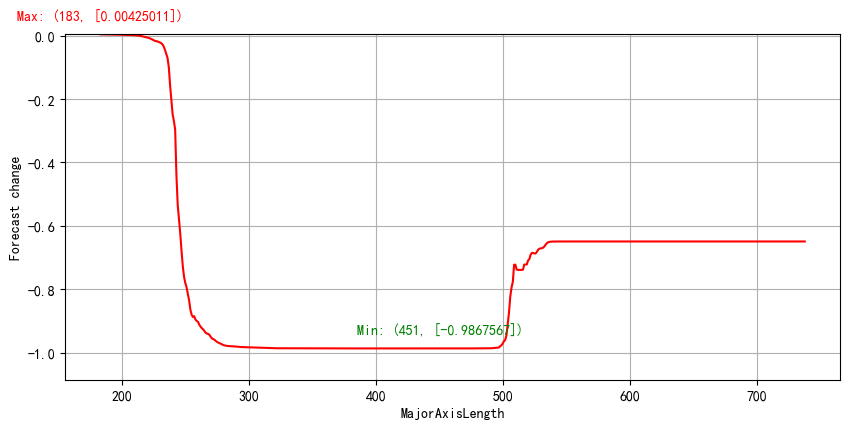

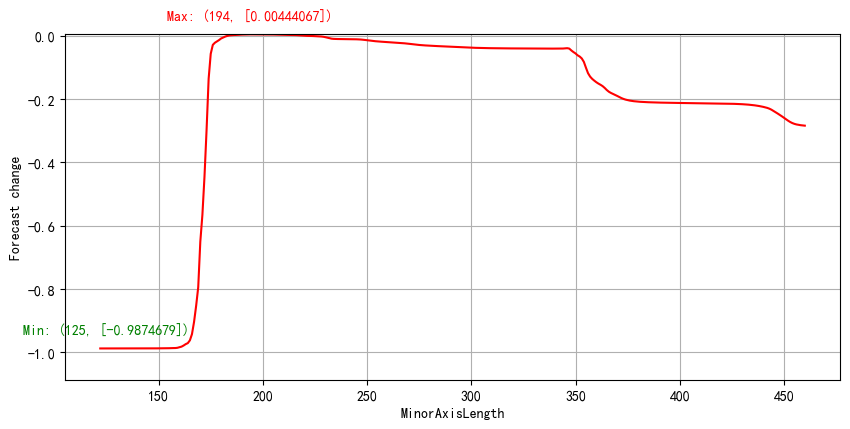

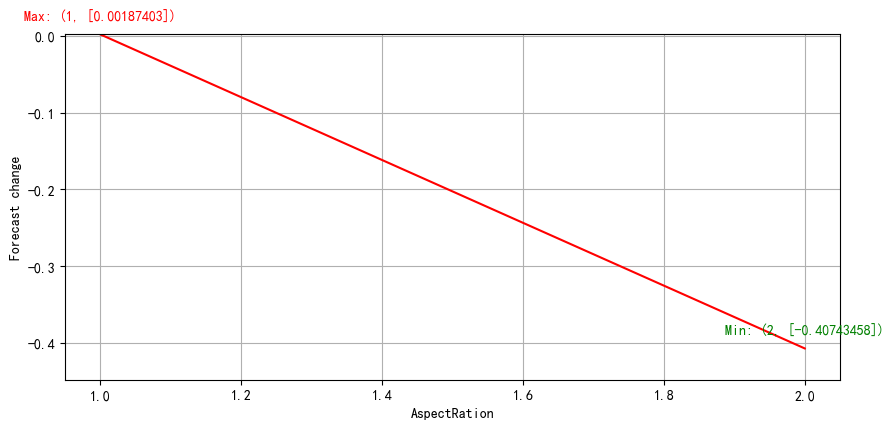

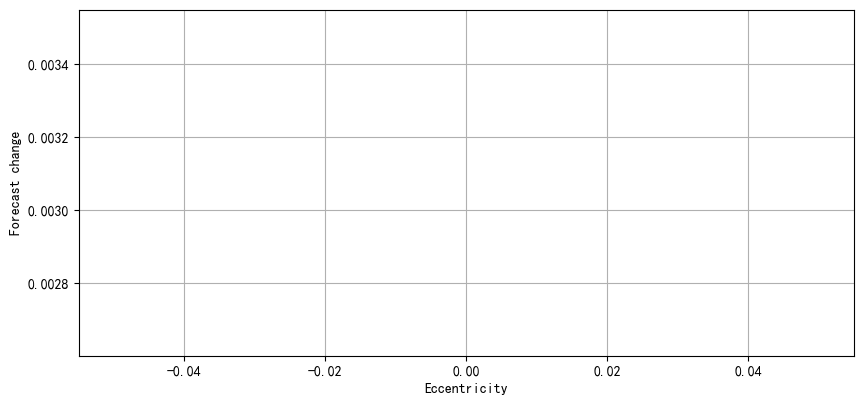

...

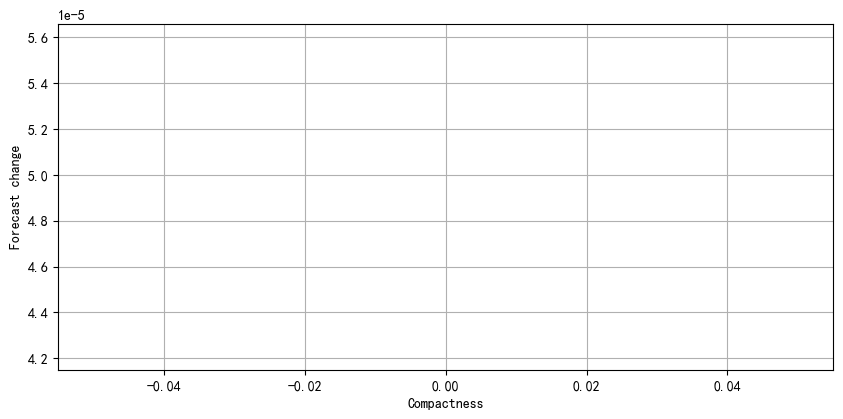

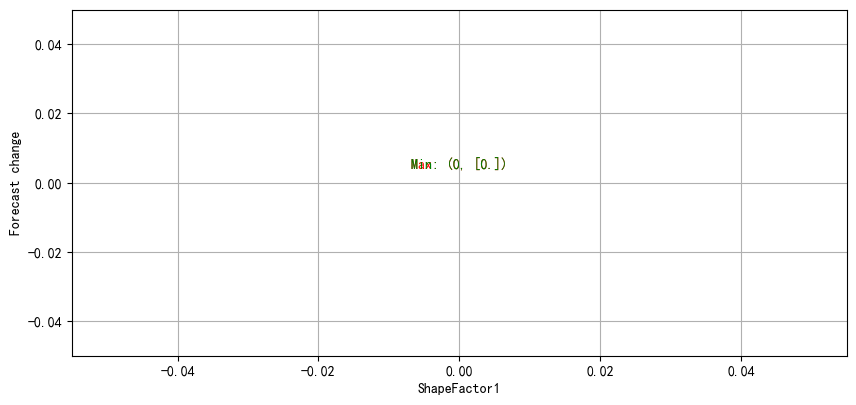

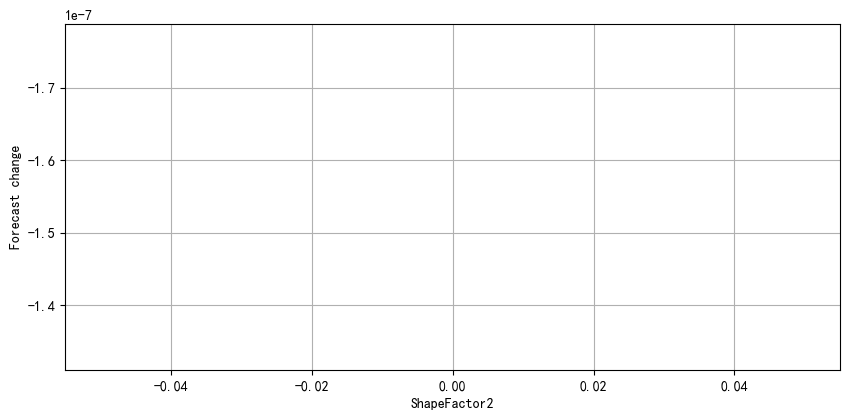

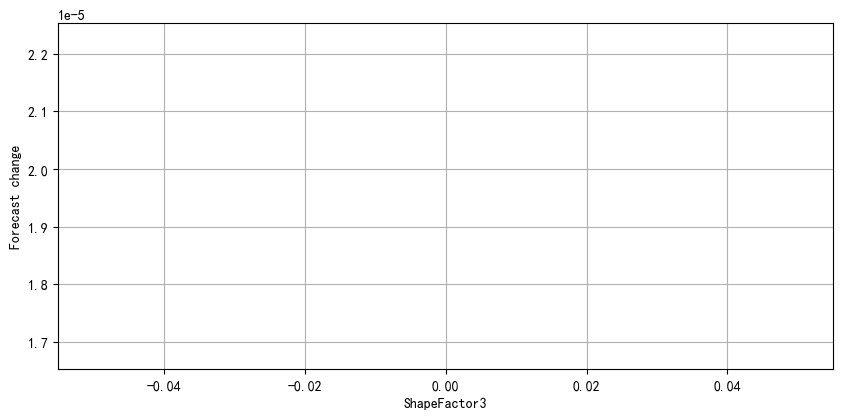

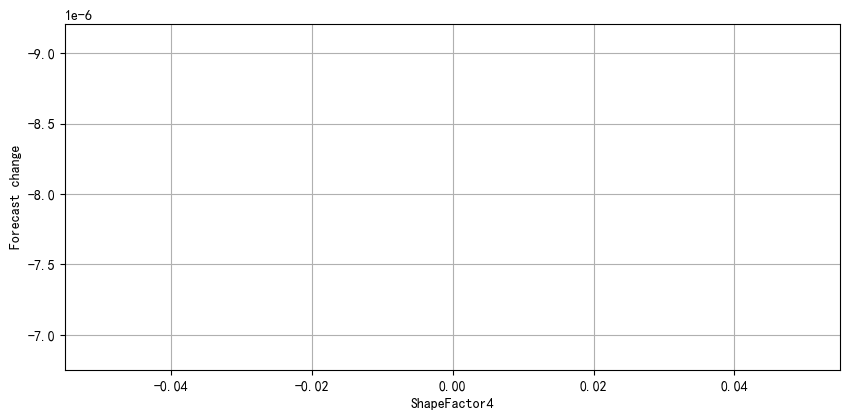

In [182]:
max_values_cnn_gru = []
for test in [8,2301,3780,3907,5820,7721,10241]:
    test_row = test
    x, y = df.iloc[test_row,1:-1], df.iloc[test_row,-1]
    x = x.values.reshape(1,x.shape[0],1)
    x = tf.convert_to_tensor(x,dtype=tf.float32)
    init_val = model.predict(x)
    min_value_list,max_value_list,values_count_list,values_range_list = value_range(column_names,df)
    x_list = Disturbance_range(column_names,min_value_list,max_value_list,values_count_list)
    y_list = Fresh_breeze(x,column_names,min_value_list,max_value_list,values_count_list,init_val)
    max_values = visualization(column_names,y_list)
    max_values_cnn_gru.append(max_values)
max_values_list_new = []
for i in max_values_cnn_gru:
    max_values_list_new.append(np.concatenate(i))
max_values = np.maximum.reduce(max_values_list_new)
column_names = df.columns[1:-1].tolist()
F_cnn_gru_remove = feature_selection(column_names,feature_dict,rela_class,max_values)

In [183]:
df = pd.read_csv("Dataset/test.csv",encoding="gbk")
x, y = df.iloc[:, 1:-1], df.iloc[:, -1]
from imblearn.over_sampling import SVMSMOTE
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_cnn_gru_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))
print(f'训练集的形状为：{x_train.shape}')

训练集的形状为：(19857, 8, 1)


In [184]:
inp=Input(shape=(x_train.shape[1:]))

x = Conv1D(32, 6, padding = "same", activation='tanh')(inp)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(64, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(128, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(256, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = Conv1D(256, 6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = Dense(64,activation='relu',kernel_regularizer=regularizers.l2(0.001))(x)
g = Flatten()(x)

lstm1=GRU(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=GRU(units=64,activation='tanh',return_sequences=True)(l)
l=Dropout(0.5)(l)
l=GRU(units=128,activation='tanh',return_sequences=True)(l)
l=Dropout(0.5)(l)
d = Flatten()(l)

g2=concatenate([g,d],axis=1)
q = Dense(128)(g2)
q = LeakyReLU(alpha=0.33)(q)
q = Dense(256, activation="tanh")(q)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(q)
model = Model(inputs=inp,outputs=output)

In [185]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
#               loss ='squared_hinge',
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )

In [186]:
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 32,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()
print('Running time: %s Seconds'%(end-start))

Epoch 1/40
621/621 [==============================] - 18s 23ms/step - loss: 1.5588 - accuracy: 0.4217 - val_loss: 0.8930 - val_accuracy: 0.6659
Epoch 2/40
621/621 [==============================] - 13s 21ms/step - loss: 0.5559 - accuracy: 0.8017 - val_loss: 0.4284 - val_accuracy: 0.8415
Epoch 3/40
621/621 [==============================] - 13s 21ms/step - loss: 0.4603 - accuracy: 0.8348 - val_loss: 0.5253 - val_accuracy: 0.8022
Epoch 4/40
621/621 [==============================] - 13s 20ms/step - loss: 0.4646 - accuracy: 0.8299 - val_loss: 0.3528 - val_accuracy: 0.8649
Epoch 5/40
621/621 [==============================] - 13s 21ms/step - loss: 0.4379 - accuracy: 0.8394 - val_loss: 0.4338 - val_accuracy: 0.8363
Epoch 6/40
621/621 [==============================] - 13s 21ms/step - loss: 0.4203 - accuracy: 0.8502 - val_loss: 0.3701 - val_accuracy: 0.8568
Epoch 7/40
621/621 [==============================] - 13s 21ms/step - loss: 0.4201 - accuracy: 0.8443 - val_loss: 0.4448 - val_accuracy:

In [187]:
print(model.evaluate(x_test,y_test))
from sklearn.metrics import classification_report
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

156/156 [==============================] - 1s 7ms/step - loss: 0.2151 - accuracy: 0.9241
[0.21511754393577576, 0.9240684509277344]
              precision    recall  f1-score   support

           0    0.93866   0.89281   0.91516       737
           1    0.99854   1.00000   0.99927       686
           2    0.88904   0.93268   0.91034       713
           3    0.93343   0.86557   0.89822       729
           4    0.96076   0.93362   0.94699       708
           5    0.95190   0.94364   0.94775       692
           6    0.81386   0.90571   0.85734       700

    accuracy                        0.92407      4965
   macro avg    0.92660   0.92486   0.92501      4965
weighted avg    0.92644   0.92407   0.92453      4965



# Steel_Scrap

------------cnn---------

In [17]:
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow import keras
from keras import regularizers
from keras.layers import Dense,Flatten,Conv1D,MaxPooling1D,Dropout,BatchNormalization
from tensorflow.keras import Sequential
from tensorflow.keras import Model
from tensorflow.keras import layers
from sklearn.preprocessing import OneHotEncoder
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
from imblearn.over_sampling import SVMSMOTE

In [91]:
df = pd.read_csv("Dataset\\faults_mul.csv",encoding="gbk")
x, y = df.iloc[:, :-1], df.iloc[:, -1]
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_cnn_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))
print(f'训练集的形状为：{x_train.shape}')

训练集的形状为：(3110, 20, 1)


In [92]:
inp=Input(shape=(x_train.shape[1:]))

x = Conv1D(32, 6, padding = "same", activation='tanh')(inp)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(256, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dense(64,activation='relu',kernel_regularizer=regularizers.l2(0.001))(x)
g = Flatten()(x)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(g)
model = Model(inputs=inp,outputs=output)

In [93]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)

In [94]:
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 16,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/40
195/195 [==============================] - 4s 14ms/step - loss: 1.9711 - accuracy: 0.3055 - val_loss: 1.6011 - val_accuracy: 0.3985
Epoch 2/40
195/195 [==============================] - 2s 10ms/step - loss: 1.4736 - accuracy: 0.4844 - val_loss: 1.5802 - val_accuracy: 0.5064
Epoch 3/40
195/195 [==============================] - 2s 11ms/step - loss: 1.2768 - accuracy: 0.5544 - val_loss: 1.1492 - val_accuracy: 0.6118
Epoch 4/40
195/195 [==============================] - 2s 10ms/step - loss: 1.2102 - accuracy: 0.5736 - val_loss: 1.0243 - val_accuracy: 0.6607
Epoch 5/40
195/195 [==============================] - 2s 10ms/step - loss: 1.1212 - accuracy: 0.6050 - val_loss: 0.9915 - val_accuracy: 0.6581
Epoch 6/40
195/195 [==============================] - 2s 10ms/step - loss: 1.0697 - accuracy: 0.6202 - val_loss: 0.9737 - val_accuracy: 0.6761
Epoch 7/40
195/195 [==============================] - 2s 11ms/step - loss: 0.9881 - accuracy: 0.6441 - val_loss: 1.1423 - val_accuracy: 0.6234

In [95]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

25/25 [==============================] - 0s 4ms/step - loss: 0.4914 - accuracy: 0.8548
[0.4913654327392578, 0.8547557592391968]
Running time: 83.1427263000005 Seconds
              precision    recall  f1-score   support

           0    0.73469   0.86747   0.79558        83
           1    0.79048   0.95402   0.86458        87
           2    0.95775   0.95775   0.95775       142
           3    0.95588   1.00000   0.97744        65
           4    0.96479   0.99275   0.97857       138
           5    0.76744   0.71223   0.73881       139
           6    0.77660   0.58871   0.66972       124

    accuracy                        0.85476       778
   macro avg    0.84966   0.86756   0.85464       778
weighted avg    0.85347   0.85476   0.85035       778



----------lstm--------

In [106]:
df = pd.read_csv("Dataset\\faults_mul.csv",encoding="gbk")
x, y = df.iloc[:, :-1], df.iloc[:, -1]
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_lstm_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))
print(f'训练集的形状为：{x_train.shape}')

训练集的形状为：(3110, 14, 1)


In [107]:
inp=Input(shape=(x_train.shape[1:]))
lstm1=LSTM(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
d = Flatten()(l)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(d)
model = Model(inputs=inp,outputs=output)

In [108]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)

In [109]:
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 16,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/40
195/195 [==============================] - 3s 9ms/step - loss: 2.0256 - accuracy: 0.2034 - val_loss: 1.7313 - val_accuracy: 0.4653
Epoch 2/40
195/195 [==============================] - 1s 7ms/step - loss: 1.6368 - accuracy: 0.3972 - val_loss: 1.2631 - val_accuracy: 0.5270
Epoch 3/40
195/195 [==============================] - 1s 7ms/step - loss: 1.3096 - accuracy: 0.5183 - val_loss: 1.0625 - val_accuracy: 0.6234
Epoch 4/40
195/195 [==============================] - 1s 7ms/step - loss: 1.2073 - accuracy: 0.5668 - val_loss: 0.9098 - val_accuracy: 0.6928
Epoch 5/40
195/195 [==============================] - 1s 7ms/step - loss: 1.0803 - accuracy: 0.6190 - val_loss: 0.8730 - val_accuracy: 0.6902
Epoch 6/40
195/195 [==============================] - 1s 7ms/step - loss: 1.0011 - accuracy: 0.6564 - val_loss: 0.8282 - val_accuracy: 0.7147
Epoch 7/40
195/195 [==============================] - 1s 7ms/step - loss: 0.9640 - accuracy: 0.6535 - val_loss: 0.8458 - val_accuracy: 0.7237
Epoch 

In [110]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

25/25 [==============================] - 0s 4ms/step - loss: 0.5277 - accuracy: 0.8380
[0.5277318358421326, 0.8380462527275085]
Running time: 54.9590715000013 Seconds
              precision    recall  f1-score   support

           0    0.71717   0.85542   0.78022        83
           1    0.84043   0.90805   0.87293        87
           2    0.95775   0.95775   0.95775       142
           3    0.96970   0.98462   0.97710        65
           4    0.94118   0.92754   0.93431       138
           5    0.75200   0.67626   0.71212       139
           6    0.68966   0.64516   0.66667       124

    accuracy                        0.83805       778
   macro avg    0.83827   0.85068   0.84301       778
weighted avg    0.83753   0.83805   0.83650       778



--------cnn+lstm----------

In [111]:
df = pd.read_csv("Dataset\\faults_mul.csv",encoding="gbk")
x, y = df.iloc[:, :-1], df.iloc[:, -1]
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_cnn_lstm_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))
print(f'训练集的形状为：{x_train.shape}')

训练集的形状为：(3110, 25, 1)


In [112]:
inp=Input(shape=(x_train.shape[1:]))
x = Conv1D(32, 6, padding = "same", activation='tanh')(inp)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(256, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dense(64,activation='relu',kernel_regularizer=regularizers.l2(0.001))(x)
g = Flatten()(x)

lstm1=LSTM(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
d = Flatten()(l)

g2=concatenate([g,d],axis=1)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(g2)
model = Model(inputs=inp,outputs=output)

In [113]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)

In [114]:
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 16,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/40
195/195 [==============================] - 6s 19ms/step - loss: 1.9892 - accuracy: 0.3127 - val_loss: 1.6007 - val_accuracy: 0.4422
Epoch 2/40
195/195 [==============================] - 3s 15ms/step - loss: 1.3895 - accuracy: 0.5152 - val_loss: 1.4817 - val_accuracy: 0.5296
Epoch 3/40
195/195 [==============================] - 3s 15ms/step - loss: 1.2159 - accuracy: 0.5854 - val_loss: 1.0674 - val_accuracy: 0.6722
Epoch 4/40
195/195 [==============================] - 3s 15ms/step - loss: 1.1307 - accuracy: 0.6017 - val_loss: 0.9888 - val_accuracy: 0.6889
Epoch 5/40
195/195 [==============================] - 3s 15ms/step - loss: 1.0548 - accuracy: 0.6515 - val_loss: 1.3245 - val_accuracy: 0.5835
Epoch 6/40
195/195 [==============================] - 3s 15ms/step - loss: 1.0140 - accuracy: 0.6511 - val_loss: 0.9518 - val_accuracy: 0.6722
Epoch 7/40
195/195 [==============================] - 3s 15ms/step - loss: 0.9543 - accuracy: 0.6587 - val_loss: 0.8433 - val_accuracy: 0.7314

In [115]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

25/25 [==============================] - 0s 6ms/step - loss: 0.4857 - accuracy: 0.8458
[0.48566049337387085, 0.8457583785057068]
Running time: 119.71996229999786 Seconds
              precision    recall  f1-score   support

           0    0.66667   0.81928   0.73514        83
           1    0.80189   0.97701   0.88083        87
           2    0.97761   0.92254   0.94928       142
           3    0.95522   0.98462   0.96970        65
           4    0.94483   0.99275   0.96820       138
           5    0.81579   0.66906   0.73518       139
           6    0.72727   0.64516   0.68376       124

    accuracy                        0.84576       778
   macro avg    0.84133   0.85863   0.84601       778
weighted avg    0.84829   0.84576   0.84327       778



-------gru-------

In [116]:
df = pd.read_csv("Dataset\\faults_mul.csv",encoding="gbk")
x, y = df.iloc[:, :-1], df.iloc[:, -1]
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_gru_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))
print(f'训练集的形状为：{x_train.shape}')

训练集的形状为：(3110, 13, 1)


In [117]:
inp=Input(shape=(x_train.shape[1:]))
lstm1=GRU(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
d = Flatten()(l)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(d)
model = Model(inputs=inp,outputs=output)

In [118]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)

In [119]:
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 16,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/40
195/195 [==============================] - 3s 9ms/step - loss: 2.0374 - accuracy: 0.2132 - val_loss: 1.4225 - val_accuracy: 0.5887
Epoch 2/40
195/195 [==============================] - 1s 7ms/step - loss: 1.3698 - accuracy: 0.5220 - val_loss: 1.0452 - val_accuracy: 0.6555
Epoch 3/40
195/195 [==============================] - 1s 7ms/step - loss: 1.1246 - accuracy: 0.5901 - val_loss: 1.0211 - val_accuracy: 0.6080
Epoch 4/40
195/195 [==============================] - 1s 7ms/step - loss: 1.0820 - accuracy: 0.6161 - val_loss: 0.9290 - val_accuracy: 0.6632
Epoch 5/40
195/195 [==============================] - 1s 7ms/step - loss: 1.0281 - accuracy: 0.6355 - val_loss: 0.8694 - val_accuracy: 0.7031
Epoch 6/40
195/195 [==============================] - 1s 7ms/step - loss: 0.9973 - accuracy: 0.6478 - val_loss: 0.8775 - val_accuracy: 0.7172
Epoch 7/40
195/195 [==============================] - 1s 7ms/step - loss: 0.9796 - accuracy: 0.6501 - val_loss: 0.8286 - val_accuracy: 0.7326
Epoch 

In [120]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

25/25 [==============================] - 0s 4ms/step - loss: 0.5935 - accuracy: 0.8123
[0.5935053825378418, 0.8123393058776855]
Running time: 53.48063640000328 Seconds
              precision    recall  f1-score   support

           0    0.69565   0.77108   0.73143        83
           1    0.79208   0.91954   0.85106        87
           2    0.94286   0.92958   0.93617       142
           3    0.95522   0.98462   0.96970        65
           4    0.93985   0.90580   0.92251       138
           5    0.69403   0.66906   0.68132       139
           6    0.66667   0.59677   0.62979       124

    accuracy                        0.81234       778
   macro avg    0.81234   0.82521   0.81742       778
weighted avg    0.81165   0.81234   0.81082       778



---------cnn+gru----------

In [121]:
df = pd.read_csv("Dataset\\faults_mul.csv",encoding="gbk")
x, y = df.iloc[:, :-1], df.iloc[:, -1]
sm = SVMSMOTE(random_state=42)
x, y = sm.fit_resample(x, y)
columns_to_drop = F_cnn_gru_remove
df_dropped = x.drop(columns=columns_to_drop)
x = df_dropped
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)
x_train = x_train.values.reshape((x_train.shape[0],x_train.shape[1],1))
x_test = x_test.values.reshape((x_test.shape[0], x_test.shape[1],1))
onehot = OneHotEncoder(sparse=False)
y_train = onehot.fit_transform(y_train.values.reshape(len(y_train), 1))
y_test = onehot.fit_transform(y_test.values.reshape(len(y_test), 1))
print(f'训练集的形状为：{x_train.shape}')

训练集的形状为：(3110, 22, 1)


In [122]:
inp=Input(shape=(x_train.shape[1:]))
x = Conv1D(32, 6, padding = "same", activation='tanh')(inp)
x = BatchNormalization()(x)
x = Conv1D(64, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(128, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dropout(0.5)(x)
x = BatchNormalization()(x)
x = Conv1D(256, kernel_size=6, strides=1, padding='same',activation='relu')(x)
x = LeakyReLU(alpha=0.33)(x)
x = Dense(64,activation='relu',kernel_regularizer=regularizers.l2(0.001))(x)
g = Flatten()(x)

lstm1=GRU(units=32,activation='tanh',return_sequences=True)(inp)
l=Dropout(0.5)(lstm1)
l=Dense(64,activation="relu")(l)
l=Dropout(0.5)(l)
l=Dense(128,activation="relu")(l)
d = Flatten()(l)

g2=concatenate([g,d],axis=1)
output = Dense(7, kernel_regularizer=tf.keras.regularizers.l2(0.01),activation='softmax')(g2)
model = Model(inputs=inp,outputs=output)

In [123]:
model.compile(optimizer = tf.keras.optimizers.Adam(0.001),  #优化器
              loss = 'categorical_crossentropy', #损失函数
              metrics = ['accuracy']
             )
lr_reduce=keras.callbacks.ReduceLROnPlateau('val_loss',patience=3,factor=0.5,min_lr=0.000001)

In [124]:
start = time.perf_counter()
history = model.fit(x_train,
                    y_train,
                    epochs=40,
                    callbacks = [lr_reduce],
                    batch_size= 16,
                    validation_data = (x_test,y_test),
                    shuffle=True)
end = time.perf_counter()

Epoch 1/40
195/195 [==============================] - 6s 20ms/step - loss: 2.0084 - accuracy: 0.3094 - val_loss: 1.5080 - val_accuracy: 0.5321
Epoch 2/40
195/195 [==============================] - 3s 15ms/step - loss: 1.3959 - accuracy: 0.5208 - val_loss: 1.2495 - val_accuracy: 0.6260
Epoch 3/40
195/195 [==============================] - 3s 15ms/step - loss: 1.2006 - accuracy: 0.6141 - val_loss: 1.1504 - val_accuracy: 0.6478
Epoch 4/40
195/195 [==============================] - 3s 15ms/step - loss: 1.0961 - accuracy: 0.6375 - val_loss: 1.0107 - val_accuracy: 0.6594
Epoch 5/40
195/195 [==============================] - 3s 15ms/step - loss: 1.0000 - accuracy: 0.6758 - val_loss: 0.9650 - val_accuracy: 0.7005
Epoch 6/40
195/195 [==============================] - 3s 15ms/step - loss: 0.9633 - accuracy: 0.6867 - val_loss: 0.9768 - val_accuracy: 0.7121
Epoch 7/40
195/195 [==============================] - 3s 15ms/step - loss: 0.9602 - accuracy: 0.6873 - val_loss: 0.9025 - val_accuracy: 0.6902

In [125]:
print(model.evaluate(x_test,y_test))
print('Running time: %s Seconds'%(end-start))
Y_test = np.argmax(y_test, axis=1)# Convert one-hot to index
from sklearn.metrics import classification_report
predict = model.predict(x_test)
y_pred=np.argmax(predict,axis=1)
print(classification_report(Y_test, y_pred,digits=5))

25/25 [==============================] - 0s 6ms/step - loss: 0.5326 - accuracy: 0.8419
[0.5326413512229919, 0.8419023156166077]
Running time: 117.42400240000279 Seconds
              precision    recall  f1-score   support

           0    0.69697   0.83133   0.75824        83
           1    0.76852   0.95402   0.85128        87
           2    0.94366   0.94366   0.94366       142
           3    0.95588   1.00000   0.97744        65
           4    0.95172   1.00000   0.97527       138
           5    0.77419   0.69065   0.73004       139
           6    0.76087   0.56452   0.64815       124

    accuracy                        0.84190       778
   macro avg    0.83597   0.85488   0.84058       778
weighted avg    0.84080   0.84190   0.83671       778

